# Анализ продаж автомобилей в Казахстане

## Введение

Нам предоставлен уже очищенный и готовый к анализу набор данных `dry_auto_kz.csv`, содержащий продажи автомобилей в Казахстане в период с января по сентябрь $2019$ года.

В процессе работы будем использовать `SQL` с СУБД `PostgreSQL`, `pandas`, а также `plotly` для визуализации данных.

Локально через `DBeaver` с развёрнутой базой данных `Ulysses` была создана таблица `df` схемы `k`.

**Цель работы:** получение понимания состояния авторынка Казахстана в ретроспективе первых трёх кварталов $2019$ года.  

**Задачи:**
1. Подключиться к БД.
2. Сделать обзор данных и описать поля.
3. Провести категоризацию данных.
    1. По объёму двигателя.
    2. По цене.
4. Провести исследовательский анализ данных.
    1. Ёмкость рынка.
    2. Описательная статистика полей:
        * объём двигателя;
        * кол-во автомобилей в заказе;
        * цена за автомобиль:
            * ценовые категории,
            * зависимость стоимости от объёма двигателя;
        * стоимость сделки;
    3. Марки, модели, классы автомобилей:
        * некоммерческие по ценовым сегментам;
        * легковые по ценовым сегментам;
        * внедорожники по ценовым сегментам;
        * некоммерческие авто по классам:
            * все классы,
            * релевантные классы.
    4. Детали:
        * производитель;
        * топливо;
        * трансмиссия;
        * привод.
    5. Компании и дилерские центры, города и регионы:
        * направление компаний;
        * лучшие компании:
            * по выручке и объёму продаж,
            * по эффективности;
        * лучшие дилерские центры:
            * по выручке и объёму продаж;
        * лучшие города:
            * по выручке и объёму продаж.
    6. Общий вывод.
5. Определить развязку.

<br>

<br>

<br>

## Подключение

Импортируем библиотеки и модули, подключимся к БД, настроим функции для администрирования и выполнения запросов, зададим опции.

In [1]:
# импорт библиотек и модулей
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# класс HTML из модуля display пакета IPython
from IPython.display import HTML


# библиотека Python для взаимодействия с PostgreSQL
import psycopg2 as ps
# модуль Pandas для чтения из БД и запись в ДФ
import pandas.io.sql as sqlio

# параметры для подключения к БД
conn = ps.connect(dbname="Ulysses",
                  user = "postgres",
                  password = "AchillHerc",
                  host = "localhost",
                  port = "5432")


# функция для администрирования БД
def admin(query):
    # создание курсора (виртуального рабочего пространства) для манипулирования БД
    cur = conn.cursor()
    try:
        # начало новой транзакции в БД
        cur.execute("BEGIN;")
        # отправка запроса базе данных
        cur.execute(query)
        # фиксация изменения в БД
        conn.commit()
    except Exception as e:
        # при возникновении ошибки происходит откат изменений
        conn.rollback()
        # сообщение об ошибке
        print("Transaction failed:", e)
    finally:
        # закрытие курсора для освобождения ресурсов БД
        cur.close()
    

    
# функция для выполнения SQL-запроса
def exct(query):
    return sqlio.read_sql_query(query, conn)

# опции для вывода данных
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 500)

<br>

<br>

<br>

## Обзор данных

Итак, сделав все подготовительные действия, посмотрим на данные.

In [2]:
exct('''SELECT *
        FROM k.df;''')

,id,purchase_date,company,car_type,brand,model,car_classification,manufacturing_year,assembly_type,manufacturing_country,fuel_type,engine_displacement_l,transmission_type,drive_type,region,city,dealer_center_name,customer_type,payment_form,quantity,price_usd,sale_usd
0,16,2019-01-01,Автоцентр-Бавария,Внедорожники,BMW,X5,E-SUV,2018.0,Импорт,США,Бензин,3.0,AT,4WD,г.Нур-Султан,Нур-Султан,Автоцентр-Бавария Астана,Юридическое лицо,,7,70353,492469
1,105,2019-01-01,Вираж,Коммерческие автомобили,GAZ,2705,Микроавтобусы,2018.0,Импорт,Россия,Бензин,2.7,MT,RWD,Акмолинская область,Кокшетау,Вираж Кокшетау,Юридическое лицо,,1,18463,18463
2,240,2019-01-01,Astana Motors,Легковые автомобили,Hyundai,Accent,B,2018.0,Импорт,Россия,Бензин,1.6,AT,FWD,г.Алматы,Алматы,Hyundai Auto Almaty,Юридическое лицо,,1,15566,15566
3,37360,2019-09-01,Autokapital,Внедорожники,Mercedes-Benz,GLE Coupe,E-SUV,2019.0,Импорт,США,Бензин,3.0,AT,AWD,г.Алматы,Алматы,Blue Star of Kazakhstan,Физическое лицо,,1,69293,69293
4,3023,2019-01-01,Toyota Motor Kazakhstan,Внедорожники,Toyota,LC200,F-SUV,2018.0,Импорт,Япония,Бензин,4.0,AT,4WD,г.Алматы,Алматы,Toyota City,Юридическое лицо,,1,61658,61658
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39961,39960,2019-09-01,Allur Auto,Коммерческие автомобили,Yutong,ZK6108HGH,Средние автобусы,2019.0,Локальное производство,Казахстан,Дизель,6.5,MT,RWD,Костанайская область,Костанай,Allur Auto Almaty,Юридическое лицо,Наличный расчёт,1,98175,98175
39962,39961,2019-09-01,Allur Auto,Коммерческие автомобили,Yutong,ZK6108HGH,Средние автобусы,2019.0,Локальное производство,Казахстан,Дизель,6.5,MT,RWD,Костанайская область,Костанай,Allur Auto Almaty,Юридическое лицо,Наличный расчёт,1,98175,98175
39963,39962,2019-09-01,Allur Auto,Коммерческие автомобили,Yutong,ZK6108HGH,Средние автобусы,2019.0,Локальное производство,Казахстан,Дизель,6.5,MT,RWD,Костанайская область,Костанай,Allur Auto Almaty,Юридическое лицо,Наличный расчёт,1,98175,98175
39964,39963,2019-09-01,Allur Auto,Коммерческие автомобили,Yutong,ZK6108HGH,Средние автобусы,2019.0,Локальное производство,Казахстан,Дизель,6.5,MT,RWD,Костанайская область,Костанай,Allur Auto Almaty,Юридическое лицо,Наличный расчёт,1,98175,98175


Имеем $22$ поля и $39966$ записей.

<br>

<br>

### Описание полей

`id` — визит клиента в автоцентр, который закончился покупкой.

`purchase_date` — год и месяц покупки.

`company` — название компании-автоцентра.

`car_type` — тип автомобиля.

`brand` — марка.

`model` — модель.

`car_classification` — класс автомобиля.

`manufacturing_year` — год производства.

`assembly_type` — импортная или локальная сборка.

`manufacturing_country` — страна сборки.

`fuel_type` — тип топлива.

`engine_displacement_l` — объём двигателя.

`transmission_type` — тип коробки передач.

`drive_type` — тип привода.

`region` — регион продажи.

`city` — город продажи.

`dealer_center_name` — наименование дилерского центра.

`customer_type` — тип покупателя.

`payment_form` — тип оплаты.

`quantity` — сколько автомобилей приобрёл покупатель.

`price_usd` — цена автомобиля.

`sale_usd` — цена всего заказа.

<br>

<br>

<br>

## Категоризация данных

Для удобства дальнейшего анализа нужно провести предварительную категоризацию некоторых количественных колонок.

<br>

<br>

### Классификация по объёму

Добавим в таблицу новое поле `engine_class` для категоризации автомобилей по объёму двигателя:
* Особо малый класс: объём двигателя меньше $1.1$ л;
* Малый: от $1.1$ до $1.7$ л;
* Средний: от $1.8$ до $3.4$ л;
* Большой: больше или равно $3.5$ л.

Это классификация утверждена у нас в стране, в РФ.

Сначала добавим поле с классификацией.

In [3]:
# ALTER TABLE позволяет вносить изменения в таблицу, ADD COLUMN добавляет поле
try:
    admin('ALTER TABLE k.df ADD COLUMN engine_class VARCHAR(50)')
except:
    pass

<br>

Затем заполним это поле по условиям.

In [4]:
# UPDATE — для изменения данных в k.df
# SET — для изменения значений колонки engine_class
try:
    admin('''UPDATE k.df
             SET engine_class = 
                 CASE
                     WHEN engine_displacement_l < 1.1 THEN 'Особо малый'
                     WHEN engine_displacement_l BETWEEN 1.1 AND 1.7 THEN 'Малый'
                     WHEN engine_displacement_l BETWEEN 1.8 AND 3.4 THEN 'Средний'
                     WHEN engine_displacement_l >= 3.5 THEN 'Большой'
                     ELSE 'None'
                 END;''')
except:
    pass

<br>

<br>

### Классификация по цене

Добавим в таблицу новое поле `price_class`, показывающее сегменты авто по престижности в зависимости от цены, в этом нам поможет сайт `drom.ru`.\
В $2019$ году средний курс доллара был $65$ ₽, а ценовые категории в рублях были такие:
* Эконом — до $750$ $000$ ₽ (до $11$ $538$ \$)
* Комфорт — до $1$ $500$ $000$ ₽ (до $23$ $077$ \$)
* Бизнес — до $3$ $000$ $000$ ₽ (до $46$ $154$ \$)
* Премиум — от $3$ $000$ $001$ ₽ (свыше $46$ $154$ \$)

Эти категории будут отнесены только к легковым автомобилям и внедорожникам, коммерческого транспорта это не коснётся.

<br>

Добавим поле с классификациями.

In [5]:
try:
    admin('ALTER TABLE k.df ADD COLUMN price_class VARCHAR(50)')
except:
    pass

<br>

Заполним это поле по условиям.

In [6]:
try:
    admin('''UPDATE k.df
             SET price_class =
                 CASE
                     WHEN (price_usd BETWEEN 0 AND 11538) AND car_type <> 'Коммерческие автомобили' THEN 'Эконом'
                     WHEN (price_usd BETWEEN 11539 AND 23077) AND car_type <> 'Коммерческие автомобили' THEN 'Комфорт'
                     WHEN (price_usd BETWEEN 23078 AND 46154) AND car_type <> 'Коммерческие автомобили' THEN 'Бизнес'
                     WHEN price_usd > 46154 AND car_type <> 'Коммерческие автомобили' THEN 'Премиум'
                     ELSE 'None'
                 END''')
except:
    pass

<br>

Создадим переменную, с помощью которой будем строить графики.

In [7]:
df = sqlio.read_sql_query('SELECT * FROM k.df;', conn)

<br>

<br>

<br>

## Исследовательский анализ данных

<br>

<br>

### Ёмкость рынка автомобилей

Узнаем количество проданных легковых, коммерческих автомобилей и внедорожников, а также общую их стоимость.\
Также выясним отношение в долях.

In [8]:
# ёмкость рынка
gen_volume = exct('''SELECT car_type,
                            cars_saled,
                            ROUND(cars_saled / SUM(cars_saled) OVER () * 100, 1) AS saled_perc,
                            SUM(cars_saled) OVER () AS total_sales,
                            revenue,
                            ROUND(revenue / SUM(revenue) OVER () * 100, 1) AS rev_perc,
                            SUM(revenue) OVER () AS total_revenue
                     FROM (SELECT car_type,
                                  SUM(quantity) AS cars_saled,
                                  SUM(sale_usd) AS revenue
                           FROM k.df
                           GROUP BY car_type) AS t''')
gen_volume

,car_type,cars_saled,saled_perc,total_sales,revenue,rev_perc,total_revenue
0,Внедорожники,22973,42.6,53882.0,691604661,51.3,1.347681e+09
1,Коммерческие автомобили,5255,9.8,53882.0,186060732,13.8,1.347681e+09
2,Легковые автомобили,25654,47.6,53882.0,470015136,34.9,1.347681e+09


<span style="font-weight: 600;">поле `total_sales` показывает общие продажи транспортных средств всех типов. В период с января по сентябрь $2019$ года всего было продано $53$ $882$ автомобиля.\
поле `total_revenue` показывает общую выручку с продажи транспортных средств всех типов. Общая выручка за весь период — $1$ $347$ $681$ $000$ $.</span>

<br>

Отобразим график кол-ва проданных авто по типам. 

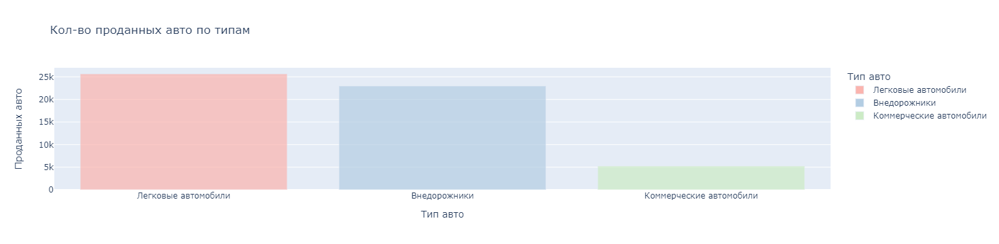

In [9]:
# столбчатая диаграмма
px.bar(gen_volume.sort_values(by='cars_saled', ascending= False),
       x='car_type',
       y='cars_saled',
       color='car_type',
       opacity=0.7,
       color_discrete_sequence=px.colors.qualitative.Pastel1,
       labels={'car_type': 'Тип авто',
               'cars_saled': 'Проданных авто'},
       title = 'Кол-во проданных авто по типам')\
  .show()

<br>

Посмотрим распределение проданных авто по типам.

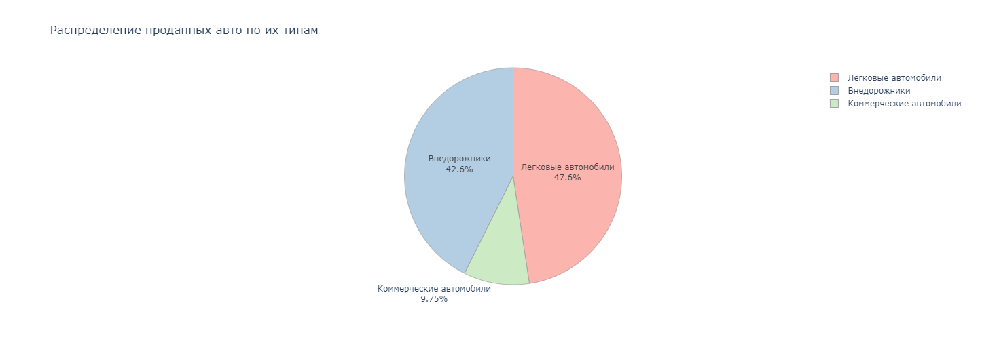

In [10]:
# круговая диаграмма
px.pie(gen_volume,
       values='cars_saled',
       names='car_type',
       color_discrete_sequence=px.colors.qualitative.Pastel1,
       title='Распределение проданных авто по их типам',
       width=1000,
       height=500)\
  .update_traces(marker_line_color='#808080',
                 marker_line_width=0.5,
                 textinfo='label+percent')\
  .show()

<span style="font-weight: 600;">Легковые автомобили лидируют по количеству проданных экземпляров. Близко от них находятся внедорожники. Сильно отстают коммерческие автомобили. По большому счёту, всё закономерно.</span>

<br>

Отобразим график выручки проданных авто по типам. 

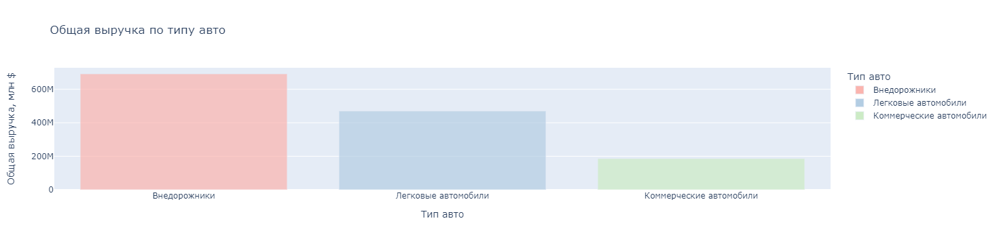

In [11]:
# столбчатая диаграмма
px.bar(gen_volume.sort_values(by='revenue', ascending=False),
       x='car_type',
       y='revenue',
       color='car_type',
       opacity=0.7,
       color_discrete_sequence=px.colors.qualitative.Pastel1,
       labels={'car_type': 'Тип авто',
               'revenue': 'Общая выручка, млн $'},
       title='Общая выручка по типу авто')\
  .show()

<br>

Посмотрим отношение выручки в долях.

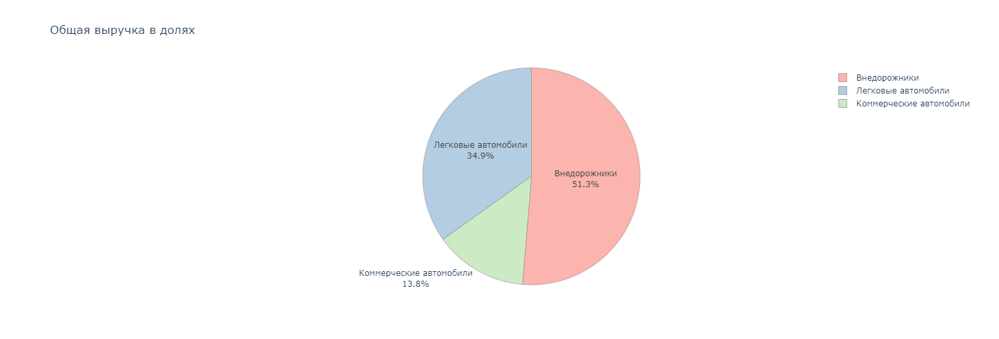

In [12]:
# круговая диаграмма
px.pie(gen_volume,
       values='revenue',
       names='car_type',
       color_discrete_sequence=px.colors.qualitative.Pastel1,
       title='Общая выручка в долях',
       width=1000,
       height=500)\
  .update_traces(marker_line_color='#808080',
                 marker_line_width=0.5,
                 textinfo='label+percent')\
  .show()

<span style="font-weight: 600;">Но главную кассу приносят внедорожники, прилично опережая легковые. Коммерческие приносят меньше всех.</span>

<br>

Посмотрим ту же картину в разбивке по месяцам. 

In [13]:
# сводная таблица
date_volume = exct('''SELECT purchase_date,
                             car_type,
                             SUM(quantity) AS cars_saled,
                             SUM(sale_usd) AS revenue
                      FROM k.df
                      GROUP BY 1, 2
                      ORDER BY 1''')

<br>

Создадим линейный график, показывающий количество проданных авто за каждый месяц по каждому типу авто.

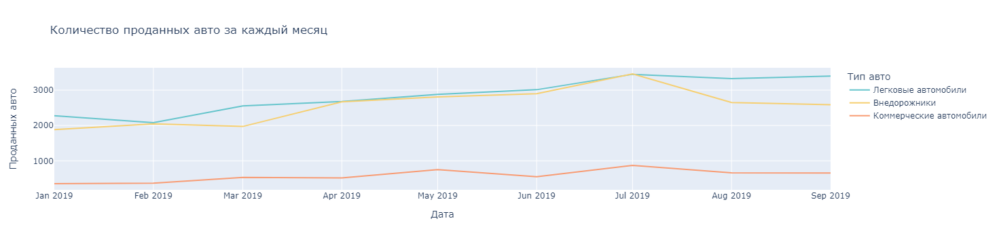

In [14]:
# линейный график
px.line(date_volume,
        x='purchase_date',
        y='cars_saled',
        color='car_type',
        color_discrete_sequence=px.colors.qualitative.Pastel,
        labels={'purchase_date': 'Дата',
                'cars_saled': 'Проданных авто',
                'car_type': 'Тип авто'},
        title='Количество проданных авто за каждый месяц')\
  .show()

<span style="font-weight: 600;">График показывает соревнование легковых авто и внедорожников в количестве проданных экземпляров, но в этой борьбе каждый месяц проигрывают внедорожники.\
Исключением является июль: там продано капельку больше (на 12 штук) внедорожников, нежели легковых.\
Ну а коммерческий транспорт закономерно находится на дне графика, слишком узконаправленная категория.</span>

<br>

Линейный график, показывающий выручку за каждый месяц по каждому типу авто.

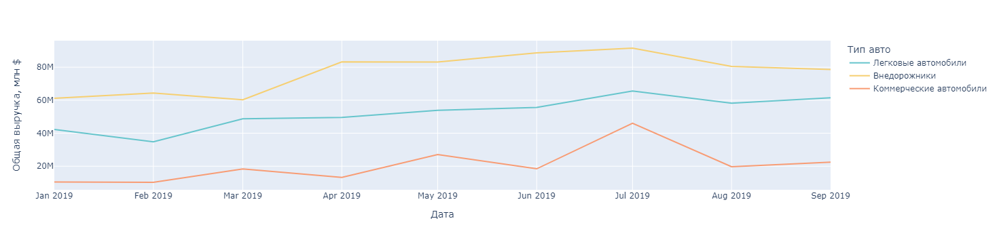

In [15]:
# линейный график
px.line(date_volume,
        x='purchase_date',
        y='revenue',
        color='car_type',
        color_discrete_sequence=px.colors.qualitative.Pastel,
        labels={'purchase_date': 'Дата',
                'revenue': 'Общая выручка, млн $',
                'car_type': 'Тип авто'})\
  .show()

<span style="font-weight: 600;">В выручке здесь чётко видно разделение, все соперники находятся на приблизительно равном расстоянии друг от друга.\
Лидируют внедорожники, затем идут легковые, а замыкают тройку коммерческие.\
Из интересного виден взрыв выручки в июле по коммерческому транспорту, а также рост выручки по внедорожникам, начиная с апреля.\
Легковые автомобили показывают стабильный линейный рост.</span>

<br>

#### Промежуточный вывод

<span style="font-weight: 600;">Итак, за весь период было продано $53$ $882$ транспортных средства, из них:</span>
* $25$ $654$ -- ($47,6\%$) — легковых;
* $22$ $973$ -- ($42,6\%$) — внедорожников;
* $5$ $255$ -- ($9,8\%$) — коммерческих.

<span style="font-weight: 600;">Общая выручка за весь период составила $1$ $347$ $681$ $000$ $\$$, из них:</span>
* $691$ $604$ $661$ $\$$ -- ($51,3\%$) — внедорожники;
* $470$ $015$ $136$ $\$$ -- ($34,9\%$) — легковые;
* $186$ $060$ $732$ $\$$ -- ($13,8\%$) — коммерческий транспорт.

<br>

<br>

### Описательная статистика

Проанализируем числовые поля датасета.\
Нас интересуют следующие поля: `engine_displacement_l`, `quantity`, `price_usd`, `sale_usd`.

В случае с объёмом двигателя `engine_displacement_l` и ценой за автомобиль `price_usd` мы должны учитывать количество автомобилей в заказе `quantity`, чтобы достоверно отобразить это в статистике.\
Ведь $1$ запись в датафрейме — это $1$ заказ в автосалоне, а клиент-юридическое лицо мог купить не $1$ автомобиль, а, например, $10$ штук.

Посмотрите пример ниже.

In [16]:
# сводная таблица
exct('''SELECT quantity AS cars_purch,
               COUNT(quantity) AS clients
        FROM k.df
        GROUP BY 1
        ORDER BY 1 DESC
        LIMIT 5''')

,cars_purch,clients
0,115,1
1,100,1
2,79,1
3,70,1
4,66,1


Пятеро клиентов разом купили очень много авто: кто-то $115$, кто-то $100$.\
Если мы будем учитывать эти $115$ автомобилей как $1$ автомобиль, это будет не совсем правильно.

<br>

In [17]:
# срез
exct('''SELECT *
        FROM k.df
        WHERE quantity IN ('115', '100') ''')

,id,purchase_date,company,car_type,brand,model,car_classification,manufacturing_year,assembly_type,manufacturing_country,fuel_type,engine_displacement_l,transmission_type,drive_type,region,city,dealer_center_name,customer_type,payment_form,quantity,price_usd,sale_usd,engine_class,price_class
0,16589,2019-05-01,БИПЭК АВТО,Внедорожники,Lada,4x4,B-SUV,2019,Локальное производство,Казахстан,Бензин,1.7,MT,4WD,Жамбылская область,Тараз,БИПЭК АВТО Тараз,Юридическое лицо,,115,9000,1035000,None,Эконом
1,28109,2019-07-01,БИПЭК АВТО,Легковые автомобили,Skoda,Octavia,C,2019,Локальное производство,Казахстан,Бензин,1.4,MT,FWD,Жамбылская область,Тараз,БИПЭК АВТО Тараз,Юридическое лицо,,100,18700,1870000,Малый,Комфорт


Вот срез по этим безумцам-бизнесменам, кто купил по $115$ и $100$ автомобилей.\
Было бы неверно считать эти $115$ Нив и $100$ Октавий как за 2 автомобиля...\
Очевидно, эти Октавии пошли на таксопарк классом комфорт.

<br>

В случае с количеством авто в заказе `quantity` и стоимости заказа `sale_usd` можно оставить всё как есть и можно описывать числовые поля напрямую с датафрейма.

In [18]:
# описание числовых данных
exct('''SELECT quantity,
               sale_usd
        FROM k.df''').describe()

,quantity,sale_usd
count,39966.000000,3.996600e+04
mean,1.348196,3.372068e+04
std,2.372886,5.064782e+04
min,1.000000,7.100000e+03
25%,1.000000,1.660575e+04
50%,1.000000,2.624000e+04
75%,1.000000,3.500000e+04
max,115.000000,3.778206e+06


Количество непропущенных значений у нас в обоих полях по $39$ $966$.

<br>

В случае с объёмом двигателя и суммой заказа нам нужно учитывать все автомобили в заказах, коих немало.\
Для этого создадим переменные с распределением объёмов двигателей и сумм заказов, которые мы будем использовать для графиков.

In [19]:
# в помощь нам  функция GENERATE_SERIES(1, quantity), которая создает последовательность чисел от 1 до quantity.
# она используется для повторения значений поля engine_displacement_l нужное количество раз, указанное в поле quantity

# распределение объёмов двигателей
eng_dist = exct('''SELECT engine_displacement_l
                   FROM (SELECT engine_displacement_l, 
                                GENERATE_SERIES(1, quantity) AS repetition
                         FROM k.df) AS subquery
                   ORDER BY engine_displacement_l;''')

In [20]:
# распределение сумм заказов
price_dist = exct('''SELECT price_usd
                     FROM (SELECT price_usd, 
                                  GENERATE_SERIES(1, quantity) AS repetition
                           FROM k.df) AS subquery
                     ORDER BY price_usd;''')

Объединим переменные.

In [21]:
# объединение
pd.concat([eng_dist.describe(), price_dist.describe()], axis=1)

,engine_displacement_l,price_usd
count,52733.000000,53882.000000
mean,2.250479,25011.701236
std,1.300610,19830.375839
min,1.200000,7100.000000
25%,1.600000,12300.000000
50%,2.000000,18852.000000
75%,2.500000,30618.000000
max,13.000000,328511.000000


Здесь у нас кол-во непропущенных значений $52$ $733$ и $53$ $882$ соответственно.

Таким образом, мы учитываем все автомобили.

**В записях метода .describe() у нас указано:**
* количество непропущенных значений;
* среднее;
* стандартное отклонение;
* минимальное значение;
* 25-перцентиль;
* 50-перцентиль;
* 75-перцентиль;
* максимальное значение.

Чем выше стандартное отклонение, тем сильнее значения в генеральной совокупности разнятся от среднего.

<br>

<br>

#### Объём двигателя

Описание поля с объёмом двигателя.\
Распределение значений.

In [22]:
eng_dist.describe()

,engine_displacement_l
count,52733.000000
mean,2.250479
std,1.300610
min,1.200000
25%,1.600000
50%,2.000000
75%,2.500000
max,13.000000


<span style="font-weight: 600;">Объём двигателя:<span>
    
Учтено: $52$ $733$ двигателя;\
Средний: $2,25$ Л;\
Медианный: $2$ Л;\
Минимальный:  $1,2$ Л;\
Максимальный: $13$ Л

<br>

10 самых популярных объёмов двигателя.

In [23]:
# сводная таблица
exct('''SELECT *,
               SUM(eng_cnt) OVER () AS eng_total,
               ROUND(eng_cnt / SUM(eng_cnt) OVER () * 100, 2) AS eng_perc
        FROM (SELECT engine_displacement_l,
                     COUNT(engine_displacement_l) + (SUM(quantity) - COUNT(engine_displacement_l)) AS eng_cnt
              FROM k.df
              WHERE engine_displacement_l IS NOT NULL
              GROUP BY 1
              ORDER BY 2 DESC) AS t
              LIMIT 10''')

,engine_displacement_l,eng_cnt,eng_total,eng_perc
0,1.6,19528,52733.0,37.03
1,2.0,9333,52733.0,17.70
2,2.5,5320,52733.0,10.09
3,2.7,4997,52733.0,9.48
4,1.7,3054,52733.0,5.79
5,1.5,1932,52733.0,3.66
6,2.4,1477,52733.0,2.80
7,1.8,1365,52733.0,2.59
8,3.5,882,52733.0,1.67
9,4.6,657,52733.0,1.25


<span style="font-weight: 600;">$19$ $528$ автомобилей $(37.03\%)$ имеют двигатели $1.6$ литра.\
Такой объём самый популярный — это модальное значение.</span>

<br>

Распределение значений на гистограмме.

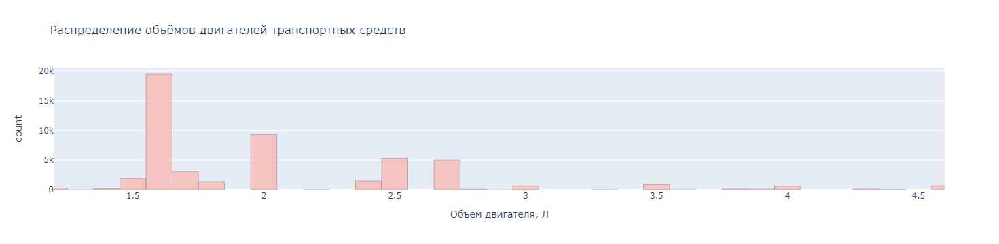

In [24]:
# гистограмма
px.histogram(eng_dist,
             x='engine_displacement_l',
             color_discrete_sequence = px.colors.qualitative.Pastel1,
             opacity=0.7,
             range_x=[1.2, 4.6],
             labels={'engine_displacement_l': 'Объём двигателя, Л'},
             title='Распределение объёмов двигателей транспортных средств').update_traces(marker_line_width=0.2,
                                                                                          marker_line_color="black")\
  .show()

Гистограмма скошена вправо, в положительную сторону, так как среднее $(2.25)$ $>$ медиана $(2)$

<br>

Распределение значений на диаграмме размаха.

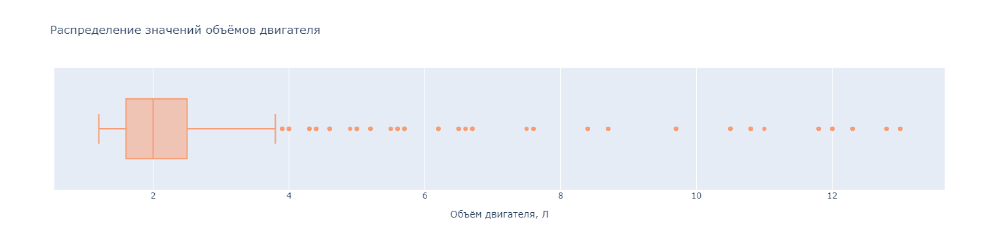

In [25]:
# ящик с усами
px.box(eng_dist,
       x='engine_displacement_l',
       color_discrete_sequence = px.colors.qualitative.Pastel[2:3],
       labels={'engine_displacement_l': 'Объём двигателя, Л'},
       title='Распределение значений объёмов двигателя')\
  .show()

Ящик с усами говорит, что диапазон нормальных значений объёмов двигателей составляет  $1.2$ - $3.8$ Л.\
Всё, что за пределами диапазона — редкие явления, исключения из правил.

In [26]:
# кол-во автомобилей с объёмом выше 3.8 делим на общее кол-во автомобилей, получаем отношение;
# полученное отношение умножаем на 100, а затем вычитаем из 100;
# получаем процент нормальных значений
exct('''WITH 
        tt AS (SELECT engine_displacement_l,
                      COUNT(engine_displacement_l) + (SUM(quantity) - COUNT(engine_displacement_l)) AS cars
               FROM k.df
               WHERE engine_displacement_l IS NOT NULL
               GROUP BY 1
               ORDER BY 2 DESC)
               
        SELECT SUM(cars) - (SELECT SUM(cars)
                            FROM tt
                            WHERE engine_displacement_l > 3.8) AS norm_values,
        100 - ROUND((SELECT SUM(cars)
                            FROM tt
                            WHERE engine_displacement_l > 3.8) / SUM(cars)::decimal * 100, 2) AS norm_values_perc
        FROM tt''')

,norm_values,norm_values_perc
0,49257.0,93.41


Этот диапазон нормальных значений составляет $93.41\%$ от всех значений. 

<span style="font-weight: 600;">Таким образом, диапазон нормальных значений объёмов двигателя — от $1.2$ до $3.8$ Л.\
    Это касается $49$ $257$ автомобилей $(93.41\%)$.</span>

<br>

Ранее мы создали порядковую переменную `engine_class`.\
Посмотрим распределение значений в ней: построим сводную таблицу, столбчатую и круговую диаграммы.

In [27]:
# сводная таблица
eng_class = exct('''SELECT *,
                           SUM(cars) OVER () AS total_cars,
                           ROUND(cars / SUM(cars) OVER () * 100, 1) AS perc
                    FROM (SELECT engine_class,
                                 SUM(quantity) AS cars
                          FROM k.df
                          GROUP BY 1) AS t''')
eng_class

,engine_class,cars,total_cars,perc
0,Большой,4492,53882.0,8.3
1,Малый,21934,53882.0,40.7
2,None,5568,53882.0,10.3
3,Средний,21888,53882.0,40.6


Класс `None` означает, что объём двигателей этих авто был неизвестен.

<br>

Отобразим распределение на столбчатой диаграмме.

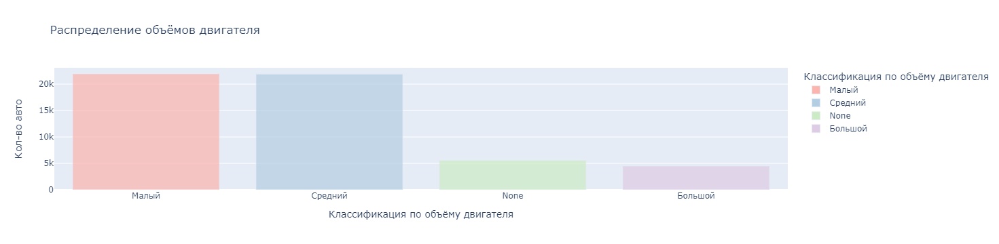

In [28]:
# столбчатая диаграмма
px.bar(eng_class.sort_values(by='cars', ascending=False),
       x='engine_class',
       y='cars',
       color='engine_class',
       opacity=0.7,
       color_discrete_sequence = px.colors.qualitative.Pastel1,
       labels={'engine_class': 'Классификация по объёму двигателя',
               'cars': 'Кол-во авто'},
       title='Распределение объёмов двигателя')\
  .show()

`Малый` и `средний` классы идут нога в ногу, только `малый` класс на шажок впереди.\
То же можно сказать и про `None` и `большой` класс, только `None` опережает своего оппонента на добрый шаг.

<br>

Отобразим распределение на круговой диаграмме.

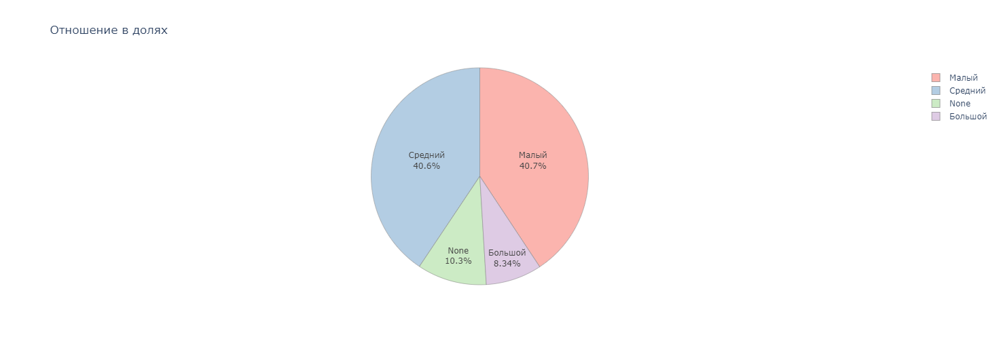

In [29]:
# круговая диаграмма
px.pie(eng_class,
       values='cars',
       names='engine_class',
       color_discrete_sequence=px.colors.qualitative.Pastel1,
       title='Отношение в долях',
       width=1000,
       height=500)\
  .update_traces(marker_line_color='#808080',
                 marker_line_width=0.5,
                 textinfo='label+percent')\
  .show()

Какая аллюзия на пацифистский символ.\
И действительно, круговая диаграмма показывает, что пары категорий живут мирно.

<br>

<span style="font-weight: 600;">Подводя итог.\
Распределение объёмов двигателей:</span>
1. Малый класс (от 1.1 до 1.7 Л) — $21$ $934$ авто $(40.7\%)$
2. Средний класс (от 1.8 до 3.4 Л) — $21$ $888$ авто $(40.6\%)$
3. None (объём неизвестен) — $5$ $568$ авто $(10.3\%)$
4. Большой класс (от 3.5 Л и  — $4$ $492$ авто $(8.34\%)$

<span style="font-weight: 600;">По диаграмме размаха диапазон нормальных значений объёмов двигателя — от $1.2$ до $3.8$ Л.\
Это касается $49$ $257$ автомобилей $(93.41\%)$.</span>

<span style="font-weight: 600;">Объём двигателя:<span>

Учтено: $52$ $733$ двигателя;\
Средний: $2.25$ Л;\
Медианный: $2$ Л;\
Минимальный:  $1.2$ Л;\
Максимальный: $13$ Л;\
Модальный: $1.6$ Л
    
<span style="font-weight: 600;">$19$ $528$ автомобилей $(37.03\%)$ имеют двигатели $1.6$ литра — модальное значение.</span>

<br>

<br>

#### Количество авто в заказе

Описание поля с количеством авто в заказе.\
Распределение значений.

Это поле показывает количество купленных авто, которые купил клиент при походе в дилерский центр.

In [30]:
# числовое описание данных
exct('''SELECT quantity
        FROM k.df''').describe()

,quantity
count,39966.000000
mean,1.348196
std,2.372886
min,1.000000
25%,1.000000
50%,1.000000
75%,1.000000
max,115.000000


Количество таких походов — $39$ $966$.\
В среднем люди покупают по $1.34$ автомобиля.\
Медианное кол-во купленных авто — $1$.\
Максимальное кол-во приобретённых авто — $115$.\
Минимальное — $1$.

<br>

Посмотрим распределение, по сколько авто люди покупают.

In [31]:
# сводная таблица
exct('''SELECT *,
               SUM(count) OVER () AS total_cnt,
               ROUND(count / SUM(count) OVER () * 100, 2) AS perc
        FROM (SELECT quantity,
                     COUNT(quantity)
              FROM k.df
              GROUP BY 1
              ORDER BY 1) AS t
        ORDER BY count DESC
        LIMIT 10''')

,quantity,count,total_cnt,perc
0,1,37210,39966.0,93.10
1,2,1017,39966.0,2.54
2,3,452,39966.0,1.13
3,4,282,39966.0,0.71
4,5,185,39966.0,0.46
5,6,120,39966.0,0.30
6,7,100,39966.0,0.25
7,8,79,39966.0,0.20
8,10,63,39966.0,0.16
9,9,61,39966.0,0.15


<span style="font-weight: 600;">$37$ $210$ сделок $(93.1\%)$ заканчиваются покупкой одного автомобиля. Мы нашли моду.</span>

<br>

Что скажет гистограмма.

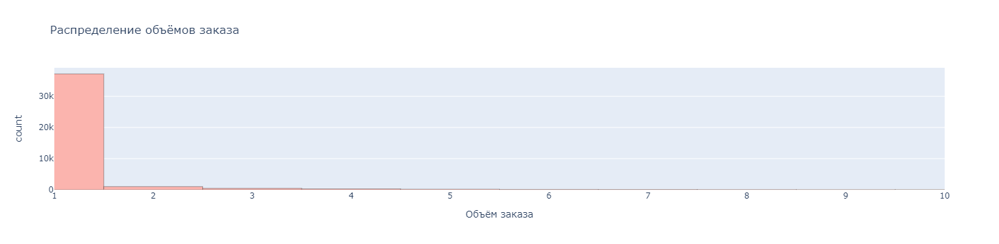

In [32]:
# гистограмма
px.histogram(df,
             x='quantity',
             nbins=115,
             title='Распределение объёмов заказа',
             labels={'quantity': 'Объём заказа'},
             range_x=[1, 10],
             color_discrete_sequence=px.colors.qualitative.Pastel1).update_traces(marker_line_width=0.2,
                                                                                  marker_line_color='black')\
  .show()

Почти все значения обосновались слева, у моды.

<br>

Что покажет боксплот.

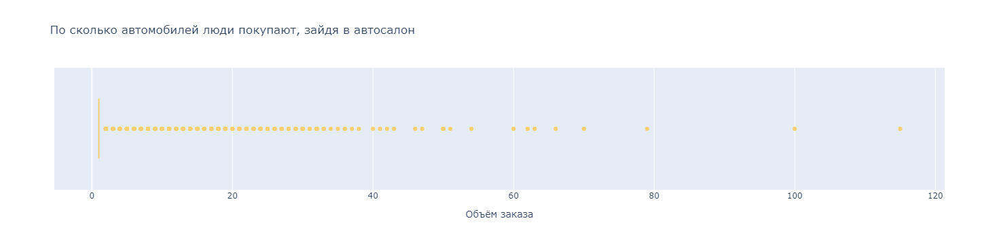

In [33]:
# диаграмма размаха
px.box(df,
       x='quantity',
       labels={'quantity': 'Объём заказа'},
       title='По сколько автомобилей люди покупают, зайдя в автосалон',
       color_discrete_sequence=px.colors.qualitative.Pastel[1:2])\
  .show()

Ящик с усами демонстрирует, что люди чаще всего приобретают $1$ автомобиль, а рантье, которые покупают по $2$ авто и больше — скорее аномалия и результат классового превосходства или признак зашкаливающей пассионарности.

<br>

<span style="font-weight: 600;">Таким образом, всего в автосалонах было совершено $39$ $966$ сделок:\
в $93.1\%$ случаев люди покупают $1$ автомобиль $(37$ $210$ сделок$)$\
$2.54\%$ приходится на 2 автомобиля $(1$ $017$ сделок$)$\
Остальные $4.36\%$ — покупка от $3$ до $115$ авто $(1$ $739$ сделок$)$.</span>
    
<span style="font-weight: 600;">Минимальное кол-во авто, входивших в сделку: $1$\
Максимальное кол-во авто: $115$.\
Среднее: $1.35$\
Медиана: $1$\
Мода: $1$</span>

<br>

<br>

#### Цена за автомобиль

Описание поля с ценой за автомобиль.\
Распределение значений.

In [34]:
# числовое описание данных
price_dist.describe()

,price_usd
count,53882.000000
mean,25011.701236
std,19830.375839
min,7100.000000
25%,12300.000000
50%,18852.000000
75%,30618.000000
max,328511.000000


<span style="font-weight: 600;">Стоимость транспортных средств:<span>
    
Приобретено: $53$ $882$ автомобиля\
Средняя: $25$ $011$ $\$$\
Медианная: $18$ $852$ $\$$\
Минимальная:  $7$ $100$ $\$$\
Максимальная: $328$ $511$ $\$$

<br>

$10$ самых часто встречаемых цен за автомобиль.

In [35]:
# сводная таблица
exct('''SELECT *,
               SUM(cars) OVER () AS total_cars,
               ROUND(cars / SUM(cars) OVER () * 100, 2) AS price_perc
        FROM (SELECT price_usd,
                     COUNT(price_usd) + (SUM(quantity) - COUNT(price_usd)) AS cars
              FROM k.df
              GROUP BY 1
              ORDER BY 2 DESC) AS t
              LIMIT 10''')

,price_usd,cars,total_cars,price_perc
0,7100,3254,53882.0,6.04
1,11600,2378,53882.0,4.41
2,9000,2273,53882.0,4.22
3,11300,1544,53882.0,2.87
4,13500,888,53882.0,1.65
5,13800,746,53882.0,1.38
6,9885,559,53882.0,1.04
7,12820,412,53882.0,0.76
8,8700,405,53882.0,0.75
9,9894,402,53882.0,0.75


<span style="font-weight: 600;">$3$ $254$ автомобиля $(6.04\%)$ проданы по $7$ $100$ $\$$ за каждый — модальное значение.\
Это самая популярная (модальная) стоимость авто, и минимальная по совместительству.</span>

<br>

Посмотрим распределение на гистограмме.

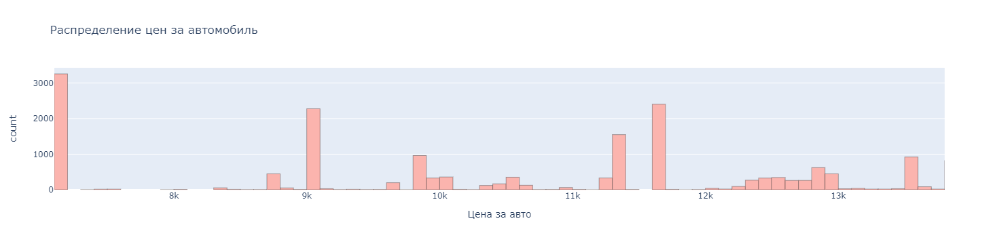

In [36]:
# гистограмма
px.histogram(price_dist,
             x='price_usd',
             nbins=3382,
             range_x=[7100, 13800],
             title='Распределение цен за автомобиль',
             labels={'price_usd': 'Цена за авто'},
             color_discrete_sequence=px.colors.qualitative.Pastel1).update_traces(marker_line_width=0.2,
                                                                                  marker_line_color='black')\
  .show()

В самом начале гистограммы как раз видна самая популярная стоимость. 

<br>

Построим боксплот.

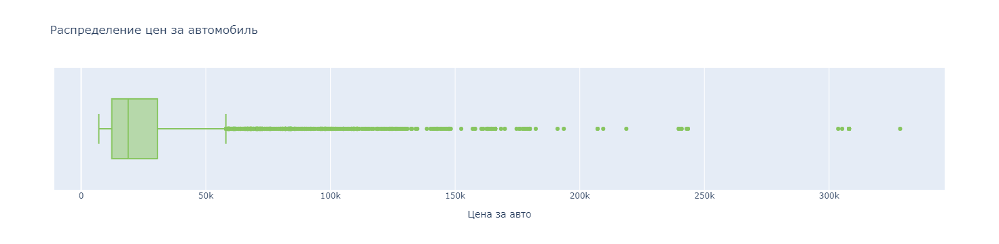

In [37]:
# ящик с усами
px.box(price_dist,
       x='price_usd',
       color_discrete_sequence=px.colors.qualitative.Pastel[4:5],
       labels={'price_usd': 'Цена за авто'},
       title='Распределение цен за автомобиль')\
  .show()

<span style="font-weight: 600;">Диаграмма размаха говорит, что диапазон нормальных значений начинается от $7$ $100$ $\$$ и заканчивается на отметке в $58$ $055$ $\$$.</span>

In [38]:
# процент нормальных значений
exct('''SELECT SUM(cars) FILTER (WHERE price_usd < 58055) AS cars,
               ROUND(SUM(cars) FILTER (WHERE price_usd < 58055) / SUM(cars) * 100, 2) AS perc        
        FROM (SELECT price_usd,
              COUNT(price_usd) + (SUM(quantity) - COUNT(price_usd)) AS cars
        FROM k.df
        GROUP BY 1
        ORDER BY 2 DESC) AS t''')

,cars,perc
0,50643.0,93.99


<span style="font-weight: 600;">Это $50$ $643$ авто, $93.99\%$ от всех значений.</span>

<br>

##### Ценовые категории авто

Когда мы категоризировали данные, мы создали поле `price_class`, которая показывает класс авто в зависимости от цены.

Посмотрим распределение классов по престижу.

In [39]:
# сводная таблица
price_class = exct('''SELECT *,
                             SUM(cars) OVER () AS total_cars,
                             ROUND(cars / SUM(cars) OVER () * 100, 2) AS class_perc
                      FROM (SELECT price_class,
                                   SUM(quantity) AS cars
                            FROM k.df
                            GROUP BY 1
                            ORDER BY 2 DESC) AS t''')
price_class

,price_class,cars,total_cars,class_perc
0,Комфорт,18058,53882.0,33.51
1,Бизнес,15902,53882.0,29.51
2,Эконом,10569,53882.0,19.62
3,None,5255,53882.0,9.75
4,Премиум,4098,53882.0,7.61


Класс `None` — это коммерческий транспорт, который не подходит под эту классификацию.

<br>

Отобразим распределение на столбчатой диаграмме.

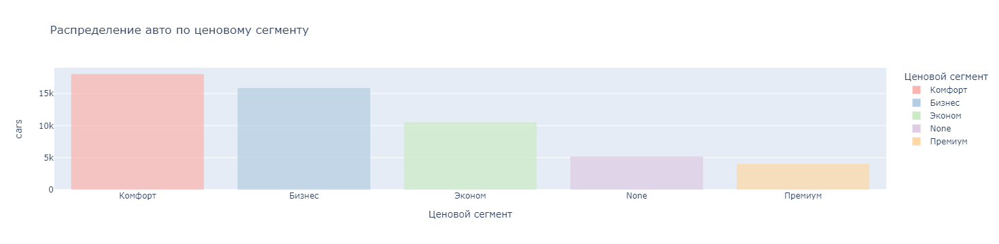

In [40]:
# столбчатая диаграмма
px.bar(price_class,
       x='price_class',
       y='cars',
       color='price_class',
       opacity=0.7,
       labels={'price_class': 'Ценовой сегмент'},
       title='Распределение авто по ценовому сегменту',
       color_discrete_sequence=px.colors.qualitative.Pastel1)\
  .show()

<br>

Посмотрим их доли.

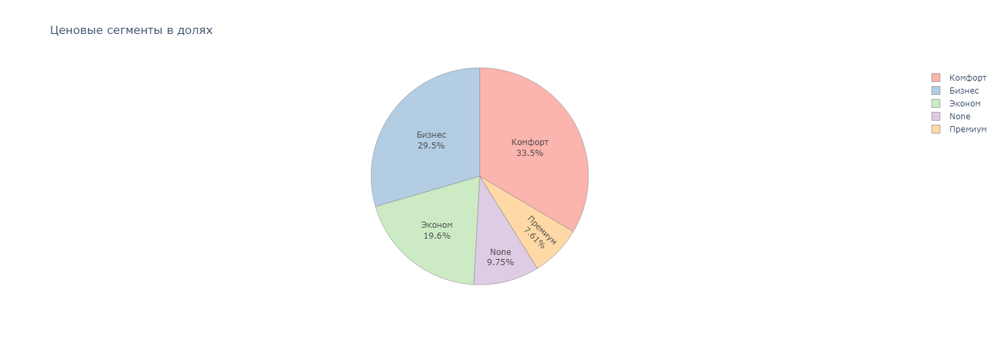

In [41]:
# круговая диаграмма
px.pie(price_class,
       values='cars',
       names='price_class',
       title='Ценовые сегменты в долях',
       color_discrete_sequence=px.colors.qualitative.Pastel1,
       width=1000,
       height=500)\
  .update_traces(marker_line_color='#808080',
                 marker_line_width=0.5,
                 textinfo='label+percent')\
  .show()

<br>

##### Зависимость стоимости авто от объёма двигателя

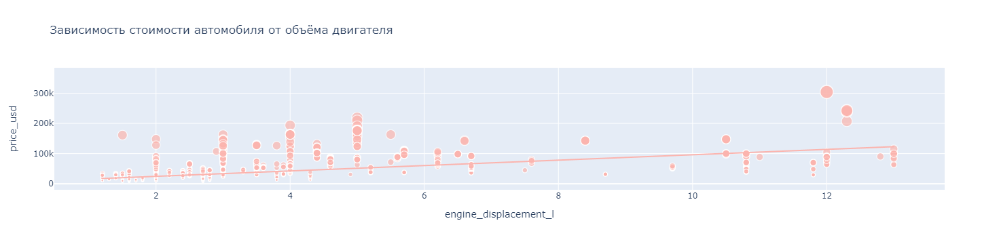

Коэффициент корреляции: 0.6316734583823599


In [42]:
px.scatter(df,
           x='engine_displacement_l',
           y='price_usd',
           trendline='ols',
           title='Зависимость стоимости автомобиля от объёма двигателя',
           size='price_usd',
           color_discrete_sequence=px.colors.qualitative.Pastel1)\
  .show()

print(f"Коэффициент корреляции: {df['engine_displacement_l'].corr(df['price_usd'])}")

Прямая корреляция: чем больше объём двигателя, тем выше стоимость автомобиля, что логично и закономерно.

<br>

<span style="font-weight: 600;">Итак, распределение автомобилей по ценовым сегментам:</span>
1. Эконом-класс (дешевле $11$ $539$ $\$$) — $10$ $569$ авто $(19.62\%)$;
2. Комфорт-класс (от $11$ $539$ $\$$ до $23$ $077$ $\$$) — $18$ $058$ авто $(33.51\%)$;
3. Бизнес-класс (от $23$ $078$ $\$$ до $46$ $154$ $\$$) — $15$ $902$ авто $(29.51\%)$;
4. Премиум-класс (дороже $46$ $154$ $\$$) — $4$ $098$ авто $(7.61\%)$;
5. Без категории (коммерческий транспорт) — $5$ $255$ транспортных средств $(9.75\%)$

Основной костяк составляют автомобили комфорт-класса и бизнес-класса.


<span style="font-weight: 600;">Стоимость транспортных средств:<span>
    
Приобретено: $53$ $882$ автомобиля\
Средняя: $25$ $011$ $\$$\
Медианная: $18$ $852$ $\$$\
Минимальная:  $7$ $100$ $\$$\
Максимальная: $328$ $511$ $\$$\
Модальная: $7$ $100$ $\$$

<span style="font-weight: 600;">$3$ $254$ автомобилей $(6.04\%)$ проданы по $7$ $100$ $\$$ за каждый — модальное значение.\
Это самая популярная (модальная) стоимость авто, и минимальная по совместительству.</span>

<span style="font-weight: 600;">Диаграмма размаха говорит, что диапазон нормальных значений начинается от $7$ $100$ $\$$ и заканчивается на отметке в $58$ $055$ $\$$.</span>\
<span style="font-weight: 600;">Это $50$ $643$ авто, $93.99\%$ от всех значений.</span>

<span style="font-weight: 600;">Наблюдается прямая корреляционная зависимость стоимости автомобиля и объёма двигателя.\
Коэффициент — $0.63$. Чем больше объём двигателя, тем выше стоимость транспортного средства.</span>

<br>

<br>

#### Стоимость сделки

Описание поля со стоимостью сделки.\
Распределение значений.

Это поле показывает, во сколько клиенту обошлась сделка.

In [43]:
# описание числовых данных
exct('''SELECT sale_usd
        FROM k.df''').describe()

,sale_usd
count,3.996600e+04
mean,3.372068e+04
std,5.064782e+04
min,7.100000e+03
25%,1.660575e+04
50%,2.624000e+04
75%,3.500000e+04
max,3.778206e+06


<span style="font-weight: 600;">Стоимость сделок:<span>
    
Состоялось — $39$ $966$ сделок;\
Средняя — $33$ $720$ $\$$;\
Медианная — $26$ $240$ $\$$;\
Минимальная — $7$ $100$ $\$$;\
Максимальная — $3$ $778$ $206$ $\$$

<br>

Посмотрим распределение стоимостей сделок.

In [44]:
# сводная таблица
exct('''SELECT *,
               SUM(sales) OVER () AS total_sales,
               ROUND(sales / SUM(sales) OVER () * 100, 2) AS perc
        FROM (SELECT sale_usd,
                     COUNT(sale_usd) AS sales
              FROM k.df
              GROUP BY 1
              ORDER BY 1) AS t
        ORDER BY sales DESC
        LIMIT 10''')

,sale_usd,sales,total_sales,perc
0,9885,559,39966.0,1.40
1,12820,412,39966.0,1.03
2,9894,402,39966.0,1.01
3,9969,315,39966.0,0.79
4,13800,232,39966.0,0.58
5,32753,222,39966.0,0.56
6,41664,214,39966.0,0.54
7,33342,210,39966.0,0.53
8,10015,208,39966.0,0.52
9,31291,181,39966.0,0.45


Чаще всего покупка обходилась в $9$ $885$ $\$$ — это происходило $559$ раз, $1.4\%$ от всех случаев.

<br>

Отобразим распределение на гистограмме.

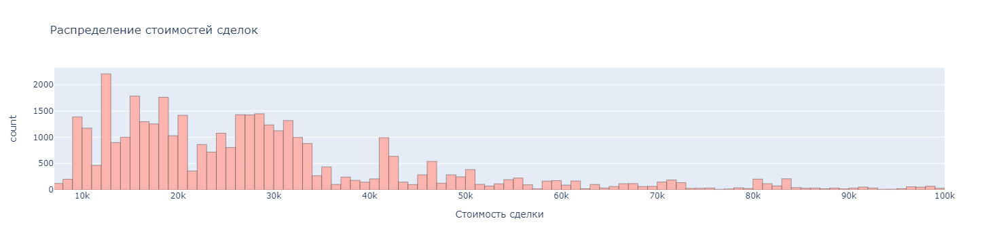

In [45]:
# гистограмма
px.histogram(df,
             x='sale_usd',
             nbins=4052,
             title='Распределение стоимостей сделок',
             labels={'sale_usd': 'Стоимость сделки'},
             range_x=[7100, 100000],
             color_discrete_sequence=px.colors.qualitative.Pastel1).update_traces(marker_line_width=0.2,
                                                                                  marker_line_color='black')\
  .show()

Скошенное вправо распределение.

<br>

Посмотрим его на диаграмме размаха.

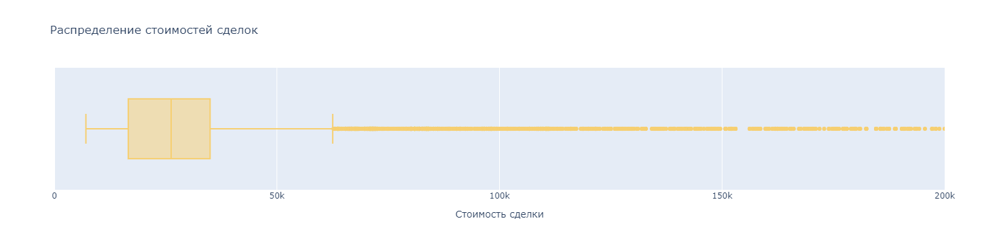

In [46]:
# диаграмма размаха
px.box(df,
       x='sale_usd',
       labels={'sale_usd': 'Стоимость сделки'},
       title='Распределение стоимостей сделок',
       range_x=[0, 200000],
       color_discrete_sequence=px.colors.qualitative.Pastel[1:2])\
  .show()

Диаграмма размаха показывает, что стоимость сделки в диапазоне от $7$ $100$ $\$$ до $62$ $535$ $\$$ — нормальные значения. 

<br>

In [47]:
# нормальные значения
exct('''SELECT SUM(sales) AS total_sales,
               SUM(sales) FILTER (WHERE sale_usd < 62535) AS norm_sales,
               ROUND(SUM(sales) FILTER (WHERE sale_usd < 62535) / SUM(sales) * 100, 2) AS norm_perc
        FROM (SELECT sale_usd,
                     COUNT(sale_usd) AS sales
              FROM k.df
              GROUP BY 1
              ORDER BY 2 DESC) AS t''')

,total_sales,norm_sales,norm_perc
0,39966.0,36464.0,91.24


Это $36$ $464$ сделки $(91.24\%)$.

<br>

<span style="font-weight: 600;">В результате, стоимость сделок:</span>

Состоялось — $39$ $966$ сделок;\
Средняя — $33$ $720$ $\$$;\
Медианная — $26$ $240$ $\$$;\
Минимальная — $7$ $100$ $\$$;\
Максимальная — $3$ $778$ $206$ $\$$\
Модальная — $9$ $885$ $\$$

<span style="font-weight: 600;">Чаще всего покупка обходилась в $9$ $885$ $\$$ — это происходило $559$ раз, $1.4\%$ от всех случаев.</span>
      
<span style="font-weight: 600;">Диаграмма размаха показывает, что стоимость сделки в диапазоне от $7$ $100$ $\$$ до $62$ $535$ $\$$ — нормальные значения.</span>

<span style="font-weight: 600;">Это $36$ $464$ сделки $(91.24\%)$.</span>

<br>

<br>

#### Промежуточный вывод

<span style="font-weight: 600;">По диаграмме размаха диапазон нормальных значений объёмов двигателя — от $1.2$ до $3.8$ Л.\
Это касается $49$ $257$ автомобилей $(93.41\%)$.</span>

<span style="font-weight: 600;">Объём двигателя:<span>

Учтено: $52$ $733$ двигателя;\
Средний: $2.25$ Л;\
Медианный: $2$ Л;\
Минимальный:  $1.2$ Л;\
Максимальный: $13$ Л;\
Модальный: $1.6$ Л
    
<span style="font-weight: 600;">$19$ $528$ автомобилей $(37.03\%)$ имеют двигатели $1.6$ литра — модальное значение.</span>

<span style="font-weight: 600;">Распределение объёмов двигателей:</span>
1. Малый класс (от 1.1 до 1.7 Л) — $21$ $934$ авто $(40.7\%)$
2. Средний класс (от 1.8 до 3.4 Л) — $21$ $888$ авто $(40.6\%)$
3. None (объём неизвестен) — $5$ $568$ авто $(10.3\%)$
4. Большой класс (от 3.5 Л и выше) — $4$ $492$ авто $(8.34\%)$

<br>

<span style="font-weight: 600;">Всего в автосалонах было совершено $39$ $966$ сделок:\
в $93.1\%$ случаев люди покупают $1$ автомобиль $(37$ $210$ сделок$)$\
$2.54\%$ приходится на 2 автомобиля $(1$ $017$ сделок$)$\
Остальные $4.36\%$ — покупка от $3$ до $115$ авто $(1$ $739$ сделок$)$.</span>
    
<span style="font-weight: 600;">Минимальное кол-во авто, входивших в сделку: $1$\
Максимальное кол-во авто: $115$.\
Среднее: $1.35$\
Медиана: $1$\
Мода: $1$</span>

<br>

<span style="font-weight: 600;">Распределение автомобилей по ценовым сегментам:</span>
1. Эконом-класс (дешевле $11$ $539$ $\$$) — $10$ $569$ авто $(19.62\%)$;
2. Комфорт-класс (от $11$ $539$ $\$$ до $23$ $077$ $\$$) — $18$ $058$ авто $(33.51\%)$;
3. Бизнес-класс (от $23$ $078$ $\$$ до $46$ $154$ $\$$) — $15$ $902$ авто $(29.51\%)$;
4. Премиум-класс (дороже $46$ $154$ $\$$) — $4$ $098$ авто $(7.61\%)$;
5. Без категории (коммерческий транспорт) — $5$ $255$ транспортных средств $(9.75\%)$

Основной костяк составляют автомобили комфорт-класса и бизнес-класса.


<span style="font-weight: 600;">Стоимость транспортных средств:<span>
    
Приобретено: $53$ $882$ автомобиля\
Средняя: $25$ $011$ $\$$\
Медианная: $18$ $852$ $\$$\
Минимальная:  $7$ $100$ $\$$\
Максимальная: $328$ $511$ $\$$\
Модальная: $7$ $100$ $\$$

<span style="font-weight: 600;">$3$ $254$ автомобилей $(6.04\%)$ проданы по $7$ $100$ $\$$ за каждый — модальное значение.\
Это самая популярная (модальная) стоимость авто, и минимальная по совместительству.</span>

<span style="font-weight: 600;">Диаграмма размаха говорит, что диапазон нормальных значений начинается от $7$ $100$ $\$$ и заканчивается на отметке в $58$ $055$ $\$$.</span>

<span style="font-weight: 600;">Это $50$ $643$ авто, $93.99\%$ от всех значений.</span>

<span style="font-weight: 600;">Наблюдается прямая корреляционная зависимость стоимости автомобиля и объёма двигателя.\
Коэффициент — $0.63$. Чем больше объём двигателя, тем выше стоимость транспортного средства.</span>

<br>

<span style="font-weight: 600;">Стоимость сделок:</span>

Состоялось — $39$ $966$ сделок;\
Средняя — $33$ $720$ $\$$;\
Медианная — $26$ $240$ $\$$;\
Минимальная — $7$ $100$ $\$$;\
Максимальная — $3$ $778$ $206$ $\$$;\
Модальная — $9$ $885$ $\$$.

<span style="font-weight: 600;">Чаще всего покупка обходилась в $9$ $885$ $\$$ — это происходило $559$ раз, $1.4\%$ от всех случаев.</span>
      
<span style="font-weight: 600;">Диаграмма размаха показывает, что стоимость сделки в диапазоне от $7$ $100$ $\$$ до $62$ $535$ $\$$ — нормальные значения.</span>

<span style="font-weight: 600;">Это $36$ $464$ сделки $(91.24\%)$.</span>

<br>

<br>

### Анализ марок, моделей, классов авто

<span style="font-weight: 600;">Создадим $15$ сводных таблиц продаж легковых и внедорожных автомобилей:</span>

$5$ таблиц с легковыми автомобилями и внедорожниками по ценовым сегментам;\
$5$ таблиц с легковыми автомобилями по ценовым сегментам;\
$5$ таблиц с внедорожниками по ценовым сегментам.

<span style="font-weight: 600;">Каждая пятёрка включает в себя таблицы, разбитые по принципу:</span>
1. Вне зависимости от престижа авто;
2. Эконом класс;
3. Комфорт класс;
4. Бизнес класс;
5. Премиум.

<br>

Создадим функцию, на вход которой будут поступать тип транспорта и его ценовой сегмент.

In [48]:
def common_cars(car_type, price_class):
    query = f'''SELECT brand,
                       model,
                       car_type,
                       car_classification,
                       model_cars,
                       ROUND(model_cars / all_the_cars * 100, 3) AS model_perc,
                       model_rev_usd,
                       brand_cars,
                       brand_perc,
                       brand_rev_usd,
                       all_the_cars,
                       all_the_cars_rev_usd,
                       inside_class_rank,
                       model_rank,
                       brand_rank,
                       CASE
                           WHEN inside_class_rank BETWEEN 1 AND 4 THEN model
                           ELSE 'Остальные'
                       END AS pie_top_inside_class_rank,
                       CASE
                           WHEN model_rank BETWEEN 1 AND 4 THEN model
                           ELSE 'Остальные'
                       END AS pie_top_model_rank,
                       CASE
                           WHEN brand_rank BETWEEN 1 AND 4 THEN brand
                           ELSE 'Остальные'
                       END AS pie_top_brand
                FROM (SELECT *,
                             ROUND(brand_cars / SUM(model_cars) OVER () * 100, 2) AS brand_perc,
                             SUM(model_cars) OVER () AS all_the_cars,
                             SUM(model_rev_usd) OVER () AS all_the_cars_rev_usd,
                             DENSE_RANK() OVER (ORDER BY brand_cars DESC) AS brand_rank,
                             DENSE_RANK() OVER (PARTITION BY car_classification ORDER BY model_cars DESC) AS inside_class_rank,
                             DENSE_RANK() OVER (ORDER BY model_cars DESC) AS model_rank
                      FROM (SELECT *,
                                   SUM(model_cars) OVER (PARTITION BY brand) AS brand_cars,
                                   SUM(model_rev_usd) OVER (PARTITION BY brand) AS brand_rev_usd
                            FROM (SELECT brand,
                                         model,
                                         car_type,
                                         car_classification,
                                         SUM(quantity) AS model_cars,
                                         SUM(sale_usd) AS model_rev_usd
                                  FROM k.df
                                  WHERE car_type IN ({','.join(map(lambda x: f"'{x}'", car_type))})
                                    AND price_class IN ({','.join(map(lambda x: f"'{x}'", price_class))})
                                  GROUP BY 1, 2, 3, 4
                                  ORDER BY 5 DESC) AS t
                            ORDER BY brand_cars DESC, model_cars DESC) AS t2) AS t3
                ORDER BY brand_cars DESC, model_cars DESC'''
    return exct(query)

<br>

Применим функцию к переменным.

In [49]:
# легковые автомобили и внедорожники по ценовым сегментам
common_cars_p4p = common_cars(car_type=['Легковые автомобили', 'Внедорожники'], price_class=['Эконом', 'Комфорт', 'Бизнес', 'Премиум'])
common_cars_econom = common_cars(car_type=['Легковые автомобили', 'Внедорожники'], price_class=['Эконом'])
common_cars_comfort = common_cars(car_type=['Легковые автомобили', 'Внедорожники'], price_class=['Комфорт'])
common_cars_business = common_cars(car_type=['Легковые автомобили', 'Внедорожники'], price_class=['Бизнес'])
common_cars_premium = common_cars(car_type=['Легковые автомобили', 'Внедорожники'], price_class=['Премиум'])

# легковые автомобили по ценовым сегментам
passenger_cars_p4p = common_cars(car_type=['Легковые автомобили'], price_class=['Эконом', 'Комфорт', 'Бизнес', 'Премиум']).sort_values(by='model_cars', ascending=False)
passenger_cars_econom = common_cars(car_type=['Легковые автомобили'], price_class=['Эконом']).sort_values(by='model_cars', ascending=False)
passenger_cars_comfort = common_cars(car_type=['Легковые автомобили'], price_class=['Комфорт']).sort_values(by='model_cars', ascending=False)
passenger_cars_business = common_cars(car_type=['Легковые автомобили'], price_class=['Бизнес']).sort_values(by='model_cars', ascending=False)
passenger_cars_premium = common_cars(car_type=['Легковые автомобили'], price_class=['Премиум']).sort_values(by='model_cars', ascending=False)

# внедорожники по ценовым сегментам
suv_cars_p4p = common_cars(car_type=['Внедорожники'], price_class=['Эконом', 'Комфорт', 'Бизнес', 'Премиум']).sort_values(by='model_cars', ascending=False)
suv_cars_econom = common_cars(car_type=['Внедорожники'], price_class=['Эконом']).sort_values(by='model_cars', ascending=False)
suv_cars_comfort = common_cars(car_type=['Внедорожники'], price_class=['Комфорт']).sort_values(by='model_cars', ascending=False)
suv_cars_business = common_cars(car_type=['Внедорожники'], price_class=['Бизнес']).sort_values(by='model_cars', ascending=False)
suv_cars_premium = common_cars(car_type=['Внедорожники'], price_class=['Премиум']).sort_values(by='model_cars', ascending=False)

<br>

#### Анализ некоммерческих авто по ценовым сегментам

Воспользуемся силой HTML и CSS, чтобы отобразить содержимое переменных.

In [50]:
# функция для создания HTML таблиц
def hyper_tables(p4p, econom, comfort, business, premium, title_1, title_2, title_3, title_4, title_5):
    # HTML разметка 
    html = "<div style='display:flex; flex-direction:column;'>"
    
    # первая строка
    html += "<br>"
    html += "<div style='text-align:center;'>"
    html += "<div style='margin:auto; display:inline-block;'><h7>{}</h7>{}</div>".format(title_1, p4p.drop_duplicates().reset_index(drop=True).head(10).to_html())
    html += "</div>"
    html += "<br>"

    # вторая строка
    html += "<div style='text-align:center;'>"
    html += "<div style='display:inline-block; margin-right:30px;'><h7>{}</h7>{}</div>".format(title_2, econom.drop_duplicates().reset_index(drop=True).head(10).to_html())
    html += "<div style='display:inline-block; margin-left:30px;'><h7>{}</h7>{}</div>".format(title_3, comfort.drop_duplicates().reset_index(drop=True).head(10).to_html())
    html += "</div>"
    html += "<br>"

    # третья строка
    html += "<div style='text-align:center;'>"
    html += "<div style='display:inline-block; margin-right:30px;'><h7>{}</h7>{}</div>".format(title_4, business.drop_duplicates().reset_index(drop=True).head(10).to_html())
    html += "<div style='display:inline-block; margin-left:30px;'><h7>{}</h7>{}</div>".format(title_5, premium.drop_duplicates().reset_index(drop=True).head(10).to_html())
    html += "</div>"
    html += "<br>"

    html += "</div>"
    
    # отображение HTML
    return HTML(html)

In [51]:
# вызов функции
hyper_tables(common_cars_p4p[['brand', 'brand_cars', 'brand_perc', 'all_the_cars', 'brand_rank', 'pie_top_brand']],
             common_cars_econom[['brand', 'brand_cars', 'brand_perc', 'all_the_cars', 'brand_rank', 'pie_top_brand']],
             common_cars_comfort[['brand', 'brand_cars', 'brand_perc', 'all_the_cars', 'brand_rank', 'pie_top_brand']],
             common_cars_business[['brand', 'brand_cars', 'brand_perc', 'all_the_cars', 'brand_rank', 'pie_top_brand']],
             common_cars_premium[['brand', 'brand_cars', 'brand_perc', 'all_the_cars', 'brand_rank', 'pie_top_brand']],
             title_1="Продажи брендов авто вне зависимости от ценового класса",
             title_2="Продажи брендов авто эконом класса",
             title_3="Продажи брендов авто комфорт класса",
             title_4="Продажи брендов авто бизнес класса",
             title_5="Продажи брендов авто премиум класса")

,brand,brand_cars,brand_perc,all_the_cars,brand_rank,pie_top_brand
0,Lada,11094.0,22.81,48627.0,1,Lada
1,Toyota,10745.0,22.10,48627.0,2,Toyota
2,Hyundai,10168.0,20.91,48627.0,3,Hyundai
3,Kia,2359.0,4.85,48627.0,4,Kia
4,Jac,1907.0,3.92,48627.0,5,Остальные
5,Ravon,1795.0,3.69,48627.0,6,Остальные
6,Renault,1788.0,3.68,48627.0,7,Остальные
7,Nissan,1664.0,3.42,48627.0,8,Остальные
8,Volkswagen,1287.0,2.65,48627.0,9,Остальные
9,Lexus,1206.0,2.48,48627.0,10,Остальные


Сводные таблицы показывают топ-10 брендов в своей ценовой категории.

<br>

Построим множественные столбчатые диаграммы, упаковав их в функцию.

In [52]:
# функция для создания столбчатых диаграмм
def car_bars(p4p, econom, comfort, business, premium, x, y, b_m):
    
    # создание подзаголовков
    titles = ['p4p', 'Эконом', 'Комфорт', 'Бизнес', 'Премиум']
    
    # создание фигуры сетки с подграфиками (subplots) с 5 строками, 1 колонкой и заголовками из titles с помощью ф-ции make_subplots
    fig = make_subplots(rows=5, cols=1, subplot_titles=titles)
    
    # данные для каждого ценового класса
    data = [p4p.drop_duplicates(),
            econom.drop_duplicates(),
            comfort.drop_duplicates(),
            business.drop_duplicates(),
            premium.drop_duplicates()]
    
    # палитра цветов Pastel1
    colors = px.colors.qualitative.Pastel1
    
    # цикл по каждому ценовому классу для построения столбчатой диаграммы в каждом subplot:
    # zip создаёт 5 кортежей, в каждом из которых по 3 элемента (data, colors, titles)
    # enumerate к каждому из этих 5 кортежей приделывает индексы
    # цикл for: `i` содержит индекс каждого кортежа, в скобках указана структура кортежей из 3-х элементов, которые будут распаковываться на каждой итерации цикла for
    # start=1 обозначает начальное значение индекса, для make_subplots из plotly.subplots важно поставить отсчёт индекса с 1
    for i, (pt, color, title) in enumerate(zip(data, colors, titles), start=1):
        # метод .add_trace() буквально "добавляет новый след графика (столбчатую диаграмму) к фигуре"
        fig.add_trace(go.Bar(x=pt[x],
                             y=pt[y],
                             name=title,
                             marker_color=color,
                             opacity=0.7),
                      row=i,       # в какой строке (row) и колонке (col) будет будет размещён график,
                      col=1)       # т.к. enumerate начинается с start=1, переменная i содержит номер текущей строки
    
    # настройка внешнего вида графика
    fig.update_layout(title_text=b_m,
                      height=1700)
    
    # отображение графика
    fig.show()

<br>

Построим диаграммы.

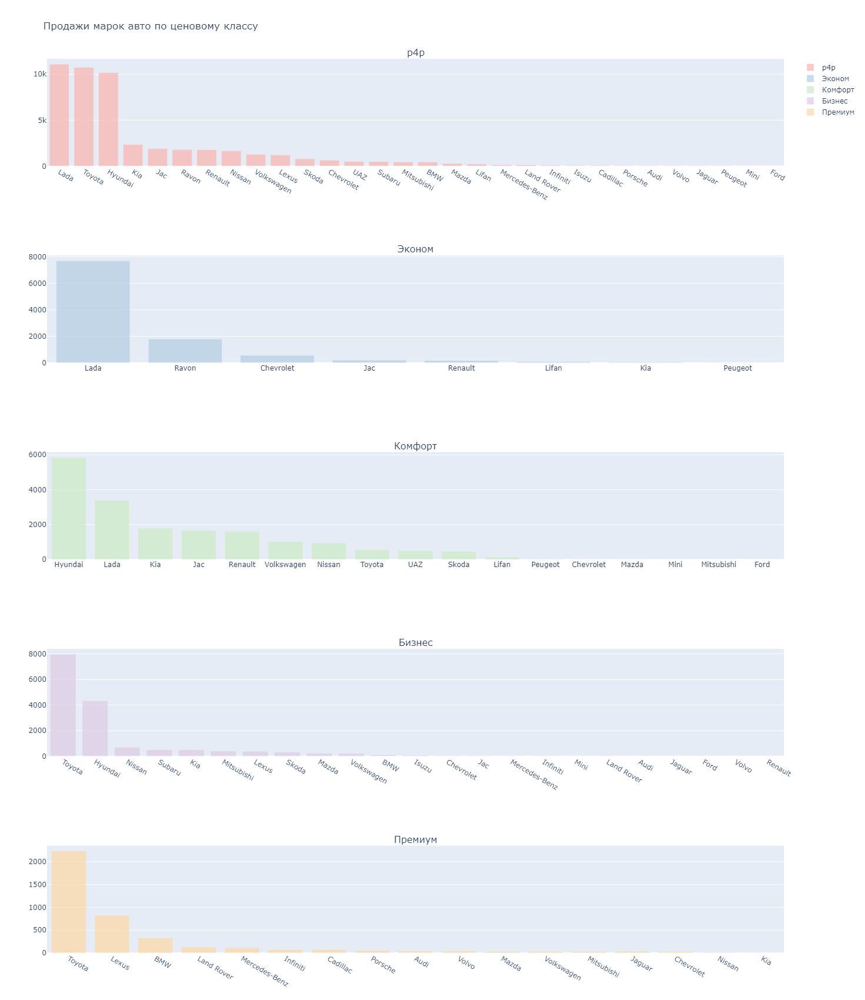

In [53]:
# вызов функции
car_bars(common_cars_p4p[['brand', 'brand_cars']],
         common_cars_econom[['brand', 'brand_cars']],
         common_cars_comfort[['brand', 'brand_cars']],
         common_cars_business[['brand', 'brand_cars']],
         common_cars_premium[['brand', 'brand_cars']],
         x='brand',
         y='brand_cars',
         b_m='Продажи марок авто по ценовому классу')

<br>

Посмотрим процентное соотношение в долях, упаковав их в функцию.

In [54]:
# функция для создания круговых диаграмм
def pie_cars(l_p4p, v_p4p, l_econom, v_econom, l_comfort, v_comfort, l_business, v_business, l_premium, v_premium, title):

    fig = make_subplots(rows=3, cols=2, 
                        specs=[[{'type':'domain'}, {'type':'domain'}],
                               [{'type':'domain'}, {'type':'domain'}],
                               [{'type':'domain'}, {'type':'domain'}]],
                        subplot_titles=['Вне зависимости от цены', 'Эконом', 'Комфорт', 'Бизнес', 'Премиум'],
                        vertical_spacing=0.1)
    
    fig.add_trace(go.Pie(labels=l_p4p,
                         values=v_p4p,
                         marker_line_color='#808080',
                         marker_line_width=0.5,
                         name="p4p"), 1, 1)
    
    fig.add_trace(go.Pie(labels=l_econom,
                         values=v_econom,
                         marker_line_color='#808080',
                         marker_line_width=0.5,
                         name="Эконом класс"), 1, 2)
    
    fig.add_trace(go.Pie(labels=l_comfort,
                         values=v_comfort,
                         marker_line_color='#808080',
                         marker_line_width=0.5,
                         name="Комфорт класс"), 2, 1)
    
    fig.add_trace(go.Pie(labels=l_business,
                         values=v_business,
                         marker_line_color='#808080',
                         marker_line_width=0.5,
                         name="Бизнес класс"), 2, 2)
    
    fig.add_trace(go.Pie(labels=l_premium,
                         values=v_premium,
                         marker_line_color='#808080',
                         marker_line_width=0.5,
                         name="Премиум класс"), 3, 1)
    
    fig.update_layout(title_text=title,
                      height=1000,
                      colorway=px.colors.qualitative.Pastel1 + px.colors.qualitative.Pastel2)
    
    fig.show()

<br>

Построим диаграммы.

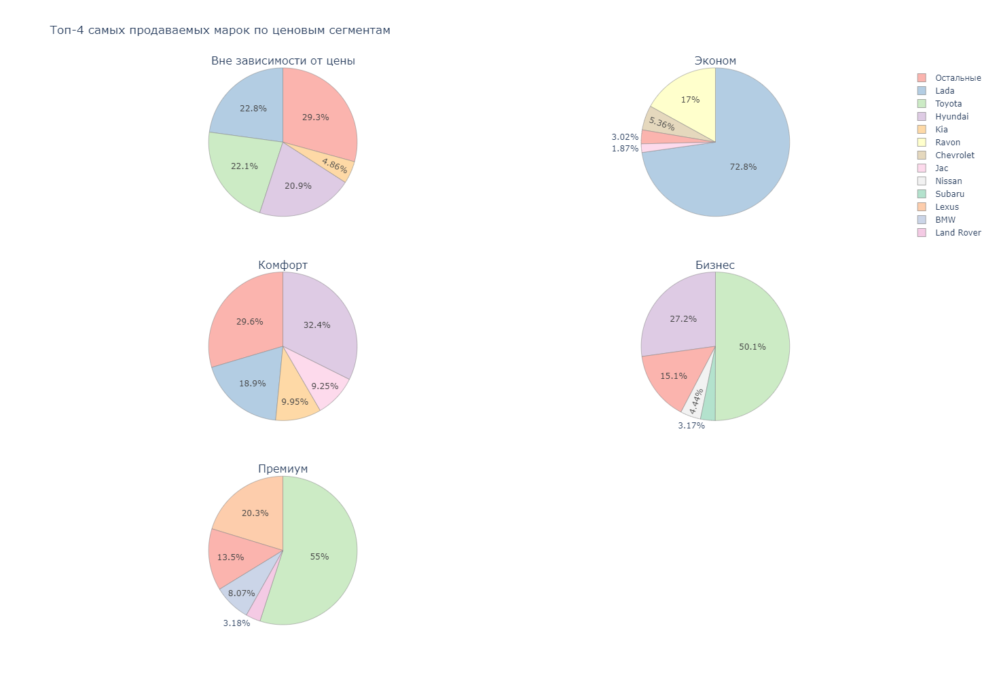

In [55]:
# вызов функции
pie_cars(common_cars_p4p[['pie_top_brand', 'brand_cars']].drop_duplicates()['pie_top_brand'],
         common_cars_p4p[['pie_top_brand', 'brand_cars']].drop_duplicates()['brand_cars'],
         common_cars_econom[['pie_top_brand', 'brand_cars']].drop_duplicates()['pie_top_brand'],
         common_cars_econom[['pie_top_brand', 'brand_cars']].drop_duplicates()['brand_cars'],
         common_cars_comfort[['pie_top_brand', 'brand_cars']].drop_duplicates()['pie_top_brand'],
         common_cars_comfort[['pie_top_brand', 'brand_cars']].drop_duplicates()['brand_cars'],
         common_cars_business[['pie_top_brand', 'brand_cars']].drop_duplicates()['pie_top_brand'],
         common_cars_business[['pie_top_brand', 'brand_cars']].drop_duplicates()['brand_cars'],
         common_cars_premium[['pie_top_brand', 'brand_cars']].drop_duplicates()['pie_top_brand'],
         common_cars_premium[['pie_top_brand', 'brand_cars']].drop_duplicates()['brand_cars'],
         title='Топ-4 самых продаваемых марок по ценовым сегментам')

<span style="font-weight: 600;">Итак, какие выводы:</span>

| Самые продаваемые марки авто в общем: |
|---------------------------------------|
| 1. Lada — $11$ $094$ авто $(22.8\%)$ |
| 2. Toyota — $10$ $745$ авто $(22.1\%)$ |
| 3. Hyundai — $10$ $168$ авто $(20.9\%)$ |
| 4. Kia — $2$ $359$ авто $(4.86\%)$ |
| 5. Все остальные — $14$ $269$ авто $(29.3\%)$ |

<br>

| Самые продаваемые марки эконом класса | Самые продаваемые марки комфорт класса | Самые продаваемые марки бизнес класса | Самые продаваемые марки премиум класса |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada — $7$ $690$ авто $(72.8\%)$ | 1. Hyundai — $5$ $843$ авто $(32.4\%)$ | 1. Toyota — $7$ $961$ авто $(50.1\%)$ | 1. Toyota — $2$ $234$ авто $(55\%)$ |
| 2. Ravon — $1$ $795$ авто $(17\%)$ | 2. Lada — $3$ $404$ авто $(18.9\%)$ | 2. Hyundai — $4$ $325$ авто $(27.2\%)$ | 2. Lexus — $824$ авто $(20.3\%)$ |
| 3. Chevrolet — $567$ авто $(5.36\%)$ | 3. Kia — $1$ $796$ авто $(9.95\%)$ | 3. Nissan — $706$ авто $(4.44\%)$ | 3. BMW — $328$ авто $(8.07\%)$ |
| 4. Jac — $198$ авто $(1.87\%)$ | 4. Jac — $1$ $671$ авто $(9.25\%)$ | 4. Subaru — $504$ авто $(3.17\%)$ | 4. Land Rover — $129$ авто $(3.18\%)$ |
| 5. Все остальные — $319$ авто $(3.02\%)$ | 5. Все остальные — $5$ $311$ авто $(29.6\%)$ | 5. Все остальные — $2$ $405$ авто $(15.1\%)$ | 5. Все остальные — $578$ авто $(13.5\%)$ |


<br>

Узнаем выручку с продажи всех марок. Снова создадим функцию.

In [56]:
# функция для создания столбчатой диаграммы по доходу
def inc_bar(car_type, br_md, br_md_rev, title, title_2):
    # столбчатая диаграмма
    fig = px.bar(car_type[[br_md, br_md_rev]].sort_values(by=br_md_rev, ascending=False).drop_duplicates(),
                 x=br_md,
                 y=br_md_rev,
                 color=br_md,
                 labels={br_md: title,
                         br_md_rev: 'Выручка'},
                 title=title_2,
                 opacity=0.7,
                 color_discrete_sequence=px.colors.qualitative.Pastel1,
                 height=500)\
            .show()
    
    return fig

<br>

Вызовем столбчатую диаграмму.

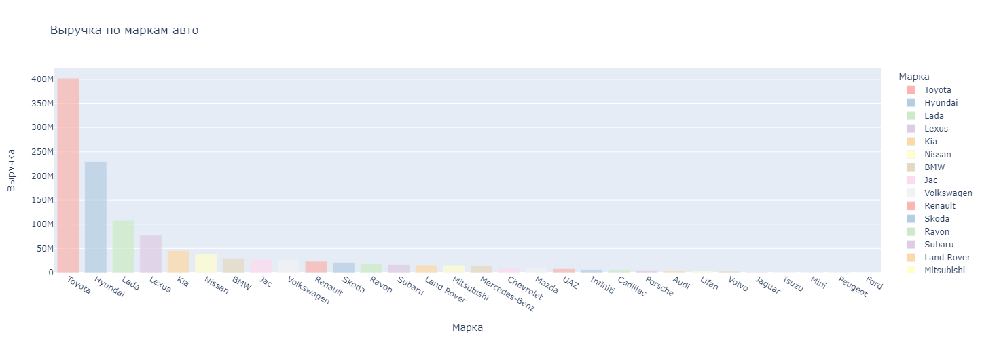

In [57]:
# столбчатая диаграмма
inc_bar(common_cars_p4p, 'brand', 'brand_rev_usd', 'Марка', 'Выручка по маркам авто')

<br>

In [58]:
# сводная таблица
common_cars_p4p[['brand', 'brand_cars', 'brand_rev_usd']].sort_values(by='brand_rev_usd', ascending=False)\
                                                         .drop_duplicates()\
                                                         .reset_index(drop=True)\
                                                         .head(10)

,brand,brand_cars,brand_rev_usd
0,Toyota,10745.0,402499853.0
1,Hyundai,10168.0,229307388.0
2,Lada,11094.0,107868380.0
3,Lexus,1206.0,77376345.0
4,Kia,2359.0,45690400.0
5,Nissan,1664.0,38356900.0
6,BMW,438.0,28735770.0
7,Jac,1907.0,26595440.0
8,Volkswagen,1287.0,25149708.0
9,Renault,1788.0,23947257.0


<br>

Создадим функцию для круговых диаграмм.

In [59]:
# функция для создания круговой диаграммы по доходу
def inc_pie(car_type, br_md, br_md_rev, title):
# выручка 9 самых доходных брендов
    top_9_brands = car_type[[br_md, br_md_rev]].sort_values(by=br_md_rev, ascending=False).drop_duplicates().head(9)
    
    # выручка остальных брендов
    other_brands_rev = car_type[br_md_rev].drop_duplicates().sum() - top_9_brands[br_md_rev].sum()
    
    # df выручки остальных брендов
    other_brands = pd.DataFrame({br_md: ['Others'],
                                 br_md_rev: other_brands_rev})
    
    # объединение выручек
    combined_df = pd.concat([top_9_brands, other_brands])
    
    # круговая диаграмма
    px.pie(combined_df,
           names=br_md,
           values=br_md_rev,
           height=600,
           color_discrete_sequence=px.colors.qualitative.Pastel,
           title=title)\
      .update_traces(marker_line_color='#808080',
                     marker_line_width=0.5,
                     textinfo='label+percent')\
      .show()

<br>

Вызовем круговую диаграмму.

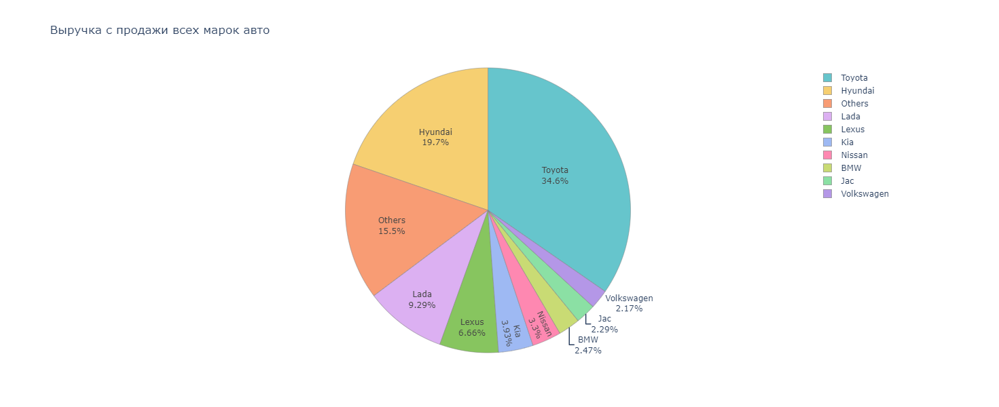

In [60]:
inc_pie(common_cars_p4p, 'brand', 'brand_rev_usd', 'Выручка с продажи всех марок авто')

| Самые доходные марки: |
|---------------------------------------|
| 1. Toyota — $402$ $499$ $853$ $\$$ $(34.6\%)$ |
| 2. Hyundai — $229$ $307$ $388$ $\$$ $(19.7\%)$ |
| 3. Остальные — $180$ $039$ $613$ $\$$ $(15.5\%)$ |
| 4. Lada — $107$ $868$ $380$ $\$$ $(9.29\%)$ |
| 5. Lexus — $77$ $376$ $345$ $\$$ $(6.66\%)$ |
| 6. Kia — $45$ $690$ $400$ $\$$ $(3.93\%)$ |
| 7. Nissan — $38$ $356$ $900$ $\$$ $(3.3\%)$ |
| 8. BMW — $28$ $735$ $770$ $\$$ $(2.47\%)$ |
| 9. Jac — $26$ $595$ $440$ $\$$ $(2.29\%)$ |
| 10. Volkswagen — $25$ $149$ $708$ $\$$ $(2.17\%)$ |

<br>

#### Анализ легковых авто по ценовым сегментам

Выведем сводные таблицы с продажами моделей легковых машин в разбивке по ценовым классам.

In [61]:
# вызов функции гипертекстовых таблиц
hyper_tables(passenger_cars_p4p[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             passenger_cars_econom[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             passenger_cars_comfort[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             passenger_cars_business[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             passenger_cars_premium[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             title_1="Продажи моделей вне зависимости от ценового класса",
             title_2="Продажи моделей эконом класса",
             title_3="Продажи моделей комфорт класса",
             title_4="Продажи моделей бизнес класса",
             title_5="Продажи моделей премиум класса")

,brand,model,car_classification,model_cars,model_perc,model_rank
0,Toyota,Camry,D,4853,18.917,1
1,Lada,Granta,B,3665,14.286,2
2,Lada,Vesta,B,2653,10.341,3
3,Hyundai,Accent,B,2211,8.619,4
4,Hyundai,Elantra,C,2062,8.038,5
5,Ravon,Nexia R3,B,1700,6.627,6
6,Lada,Largus,Компактвэн,1683,6.560,7
7,Toyota,Corolla,C,1089,4.245,8
8,Volkswagen,Polo,B,1032,4.023,9
9,Kia,Rio,B,993,3.871,10


<br>

Построим столбчатые диаграммы продаж легковых авто в разбивке по ценовым сегментам.

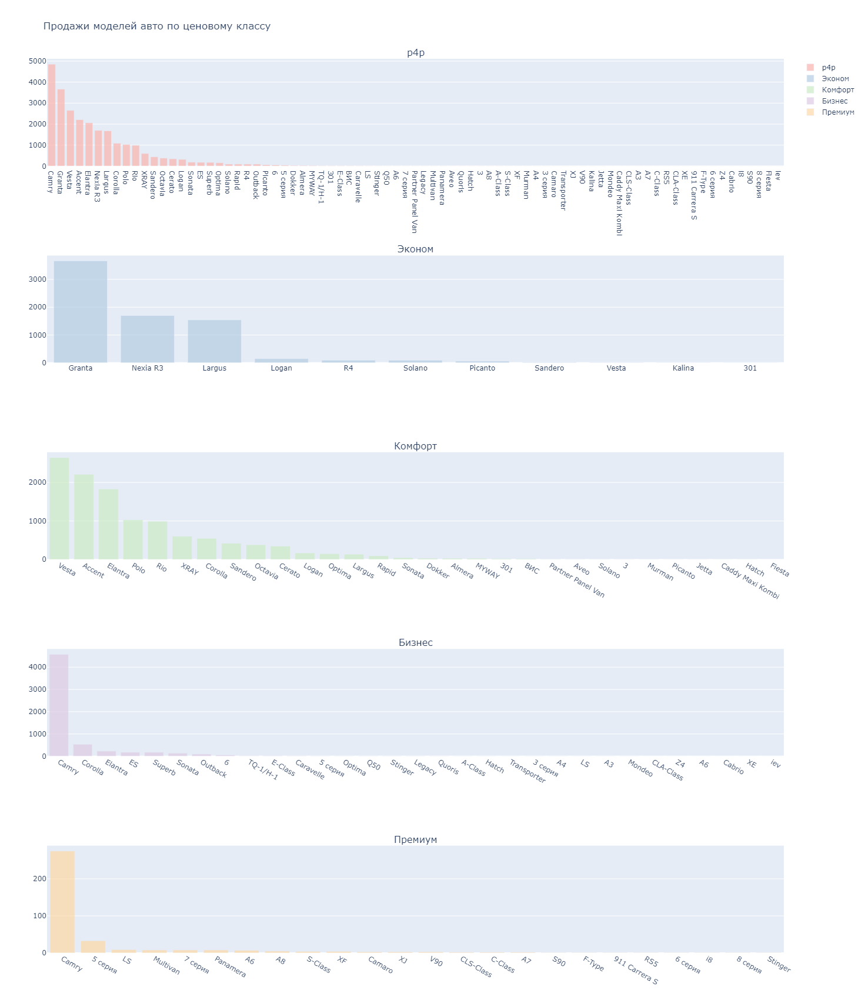

In [62]:
# столбчатые диаграммы
car_bars(passenger_cars_p4p[['model', 'model_cars']],
         passenger_cars_econom[['model', 'model_cars']],
         passenger_cars_comfort[['model', 'model_cars']],
         passenger_cars_business[['model', 'model_cars']],
         passenger_cars_premium[['model', 'model_cars']],
         x='model',
         y='model_cars',
         b_m='Продажи моделей авто по ценовому классу')

<br>

Построим круговые диаграммы.

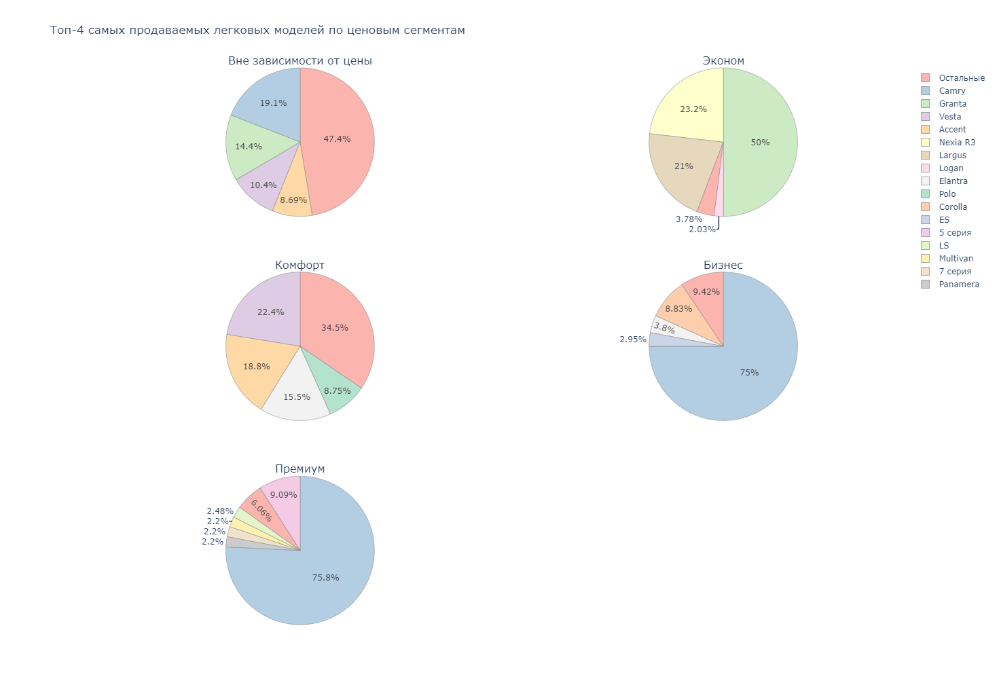

In [63]:
# круговые диаграммы
pie_cars(passenger_cars_p4p[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         passenger_cars_p4p[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         passenger_cars_econom[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         passenger_cars_econom[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         passenger_cars_comfort[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         passenger_cars_comfort[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         passenger_cars_business[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         passenger_cars_business[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         passenger_cars_premium[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         passenger_cars_premium[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         title='Топ-4 самых продаваемых легковых моделей по ценовым сегментам')

<br>

<span style="font-weight: 600;">Итак,</span>

| Самые продаваемые модели легковых авто в общем: |
|---------------------------------------|
| 1. Toyota Camry — $4$ $853$ авто $(19.1\%)$ |
| 2. Lada Granta — $3$ $665$ авто $(14.4\%)$ |
| 3. Lada Vesta — $2$ $653$ авто $(10.4\%)$ |
| 4. Hyundai Accent — $2$ $211$ авто $(8.69\%)$ |
| 5. Остальные — $12$ $061$ авто $(47.4\%)$ |

<br>

| Самые продаваемые эконом модели легковых авто  | Самые продаваемые комфорт модели легковых авто | Самые продаваемые 'бизнес' модели легковых авто | Самые продаваемые премиум модели легковых авто |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada Granta — $3$ $665$ авто $(50\%)$ | 1. Lada Vesta — $2$ $644$ авто $(22.4\%)$ | 1. Toyota Camry — $4$ $578$ авто $(75\%)$ | 1. Toyota Camry — $275$ авто $(75.8\%)$ |
| 2. Ravon Nexia R3 — $1$ $700$ авто $(23.2\%)$ | 2. Hyundai Accent — $2$ $211$ авто $(18.8\%)$ | 2. Toyota Corolla — $539$ авто $(8.83\%)$ | 2. BMW 5 серия — $33$ авто $(9.09\%)$ |
| 3. Lada Largus — $1$ $544$ авто $(21\%)$ | 3. Hyundai Elantra — $1$ $830$ авто $(15.5\%)$ | 3. Hyundai Elantra — $232$ авто $(3.8\%)$ | 3. Lexus LS — $9$ авто $(2.48\%)$ |
| 4. Renault Logan — $149$ авто $(2.03\%)$ | 4. Volkswagen Polo — $1$ $032$ авто $(8.75\%)$ | 4. Lexus ES — $180$ авто $(2.95\%)$ | 4. Volkswagen Multivan — $8$ авто $(2.2\%)$ |
| 5. Все остальные — $277$ авто $(3.78\%)$ | 5. Все остальные — $4$ $071$ авто $(34.5\%)$ | 5. Все остальные — $575$ авто $(9.42\%)$ | 4. BMW 7 серия — $8$ авто $(2.2\%)$ |
|                                          |                                              |                                          | 4. Porsche Panamera — $8$ авто $(2.2\%)$ |
|                                          |                                              |                                          | 5. Все остальные — $22$ авто $(6.06\%)$ |


<br>

Узнаем выручку с продажи моделей легковых авто, независимо от ценового класса.

Отобразим распределение на столбчатой диаграмме.

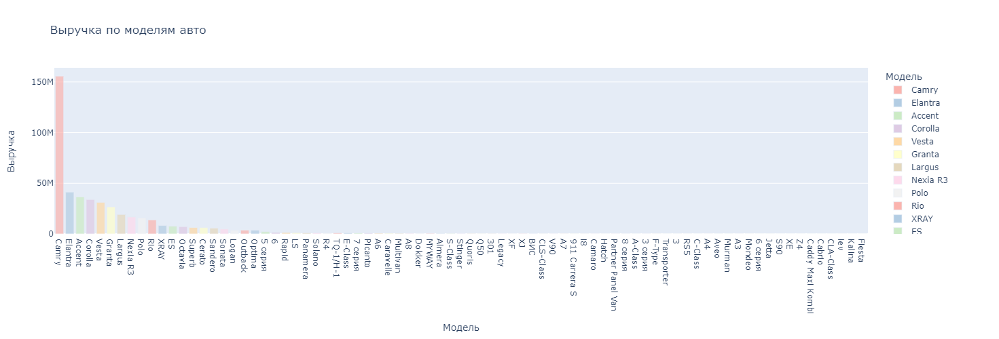

In [64]:
# столбчатая диаграмма
inc_bar(passenger_cars_p4p, 'model', 'model_rev_usd', 'Модель', 'Выручка по моделям авто')

<br>

Распределение на сводной таблице.

In [65]:
# сводная таблица
passenger_cars_p4p[['model', 'model_cars', 'model_rev_usd']].sort_values(by='model_rev_usd', ascending=False)\
                                                            .drop_duplicates()\
                                                            .reset_index(drop=True)\
                                                            .head(10)

,model,model_cars,model_rev_usd
0,Camry,4853,155748694
1,Elantra,2062,41268941
2,Accent,2211,36481919
3,Corolla,1089,33896714
4,Vesta,2653,31116276
5,Granta,3665,26679004
6,Largus,1683,19173200
7,Nexia R3,1700,16715009
8,Polo,1032,15715359
9,Rio,993,13755500


<br>

Распределение на круговой диаграмме.

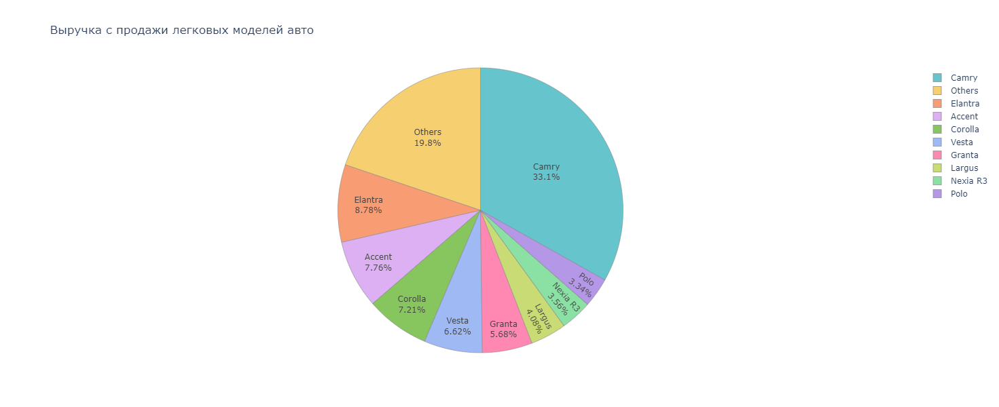

In [66]:
# круговая диаграмма
inc_pie(passenger_cars_p4p, 'model', 'model_rev_usd', 'Выручка с продажи легковых моделей авто')

<span style="font-weight: 600;">Итак,</span>

| Самые доходные модели легковых авто: |
|---------------------------------------|
| 1. Toyota Camry — $155$ $748$ $694$ $\$$ $(33.1\%)$ |
| 2. Остальные — $93$ $220$ $020$ $\$$ $(19.8\%)$ |
| 3. Hyundai Elantra — $41$ $268$ $941$ $\$$ $(8.78\%)$ |
| 4. Hyundai Accent — $36$ $481$ $919$ $\$$ $(7.76\%)$ |
| 5. Toyota Corolla — $33$ $896$ $714$ $\$$ $(7.21\%)$ |
| 6. Lada Vesta — $31$ $116$ $276$ $\$$ $(6.62\%)$ |
| 7. Lada Granta — $26$ $679$ $004$ $\$$ $(5.68\%)$ |
| 8. Lada Largus — $19$ $173$ $200$ $\$$ $(4.08\%)$ |
| 9. Ravon Nexia R3 — $16$ $715$ $009$ $\$$ $(3.56\%)$ |
| 10. Volkswagen Polo — $15$ $715$ $359$ $\$$ $(3.34\%)$ |

<br>

<br>

#### Анализ внедорожников по ценовым сегментам

Построим сводные таблицы, которые покажут продажи моделей внедорожников в разбивке по классам.

In [67]:
# вызов функции гипертекстовых таблиц
hyper_tables(suv_cars_p4p[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             suv_cars_econom[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             suv_cars_comfort[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             suv_cars_business[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             suv_cars_premium[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rank']],
             title_1="Продажи моделей вне зависимости от ценового класса",
             title_2="Продажи моделей эконом класса",
             title_3="Продажи моделей комфорт класса",
             title_4="Продажи моделей бизнес класса",
             title_5="Продажи моделей премиум класса")

,brand,model,car_classification,model_cars,model_perc,model_rank
0,Hyundai,Tucson,C-SUV,3271,14.238,1
1,Lada,4x4,B-SUV,2469,10.747,2
2,Hyundai,Creta,B-SUV,1775,7.726,3
3,Toyota,LC Prado,E-SUV,1711,7.448,4
4,Jac,S3,B-SUV,1355,5.898,5
5,Toyota,RAV4,C-SUV,1213,5.280,6
6,Toyota,HILUX DC,Pick-ups,827,3.600,7
7,Toyota,LC200,F-SUV,779,3.391,8
8,Renault,Duster,B-SUV,707,3.078,9
9,Hyundai,Santa Fe,D-SUV,639,2.782,10


<br>

Распределение на столбчатой диаграмме.

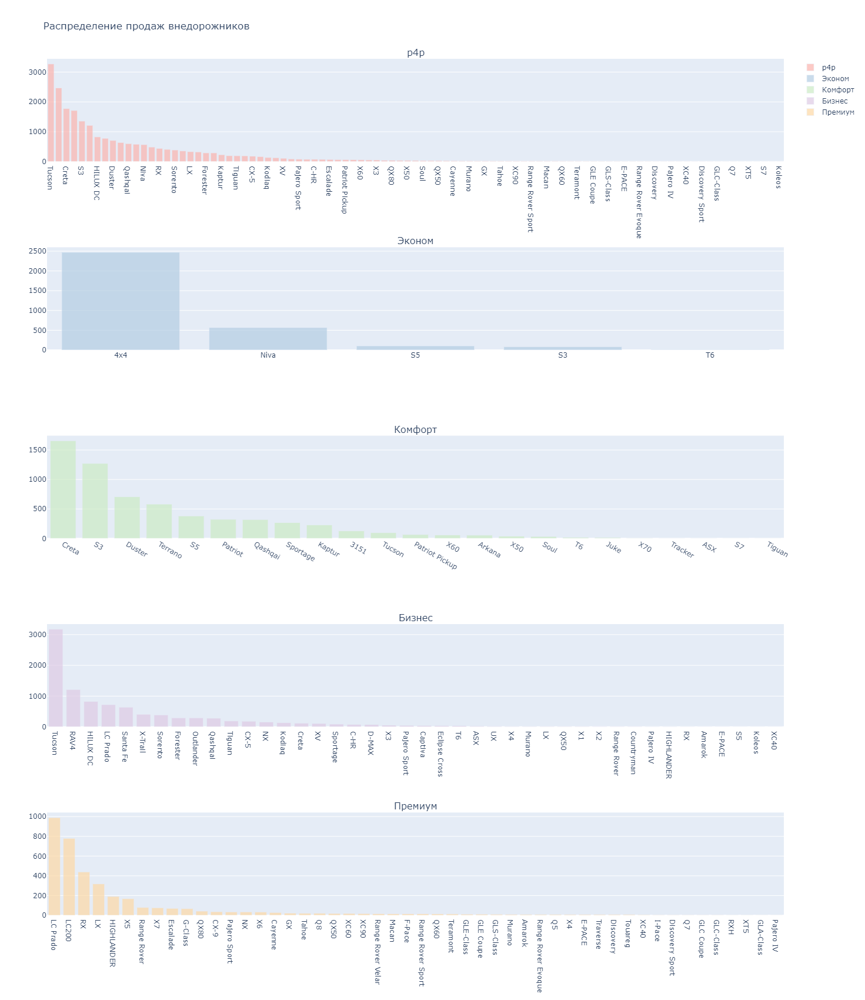

In [68]:
# столбчатые диаграммы
car_bars(suv_cars_p4p[['model', 'model_cars']],
         suv_cars_econom[['model', 'model_cars']],
         suv_cars_comfort[['model', 'model_cars']],
         suv_cars_business[['model', 'model_cars']],
         suv_cars_premium[['model', 'model_cars']],
         x='model',
         y='model_cars',
         b_m='Распределение продаж внедорожников')

<br>

Распределение на круговых диаграммах.

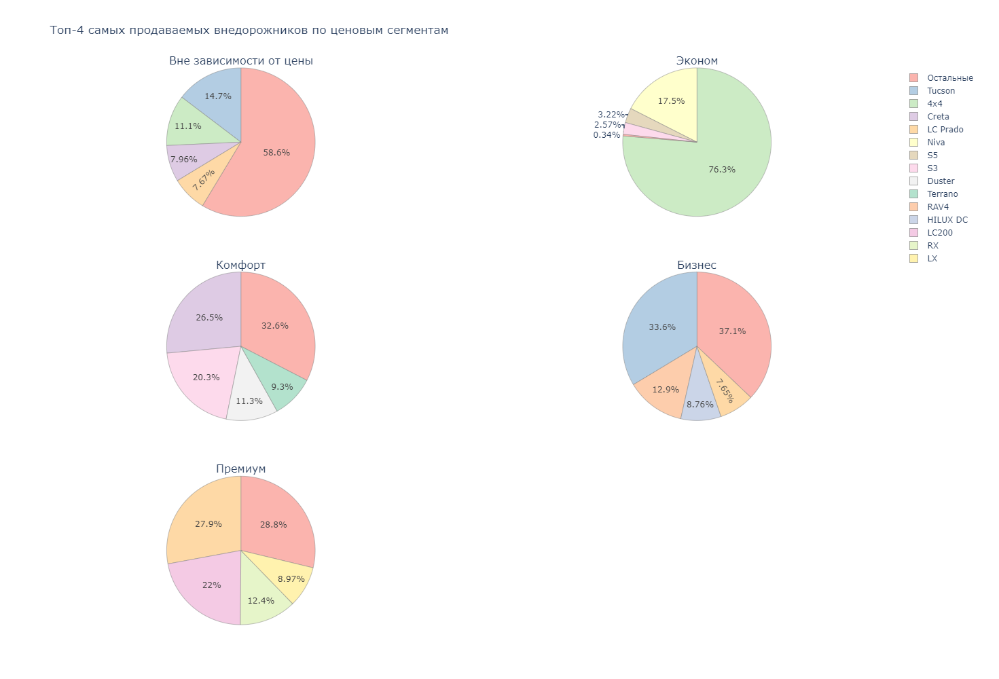

In [69]:
# круговые диаграммы
pie_cars(suv_cars_p4p[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         suv_cars_p4p[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         suv_cars_econom[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         suv_cars_econom[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         suv_cars_comfort[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         suv_cars_comfort[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         suv_cars_business[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         suv_cars_business[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         suv_cars_premium[['pie_top_model_rank', 'model_cars']].drop_duplicates()['pie_top_model_rank'],
         suv_cars_premium[['pie_top_model_rank', 'model_cars']].drop_duplicates()['model_cars'],
         title='Топ-4 самых продаваемых внедорожников по ценовым сегментам')

<br>

<span style="font-weight: 600;">Итак,</span>

| Самые продаваемые модели внедорожников в общем: |
|---------------------------------------|
| 1. Hyundai Tucson — $3$ $271$ авто $(14.7\%)$ |
| 2. Lada 4x4 — $2$ $469$ авто $(11.1\%)$ |
| 3. Hyundai Creta — $1$ $775$ авто $(7.96\%)$ |
| 4. Toyota Land Cruiser Prado — $1$ $711$ авто $(7.67\%)$ |
| 5. Остальные — $13$ $085$ авто $(58.6\%)$ |

<br>

| Самые продаваемые эконом модели внедорожников  | Самые продаваемые комфорт модели внедорожников | Самые продаваемые 'бизнес' модели внедорожников | Самые продаваемые премиум модели внедорожников |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada 4x4 — $2$ $469$ авто $(76.3\%)$ | 1. Hyundai Creta — $1$ $656$ авто $(26.5\%)$ | 1. Hyundai Creta — $3$ $174$ авто $(33.6\%)$ | 1. Toyota Land Cruiser Prado — $989$ авто $(27.9\%)$ |
| 2. Chevrolet Niva — $567$ авто $(17.5\%)$ | 2. Jac S3 — $1$ $272$ авто $(20.3\%)$ | 2. Toyota RAV4 — $1$ $213$ авто $(12.9\%)$ | 2. Toyota Land Cruiser — $779$ авто $(22\%)$ |
| 3. Jac S5 — $104$ авто $(3.22\%)$ | 3. Renault Duster — $707$ авто $(11.3\%)$ | 3. Toyota Hilux — $827$ авто $(8.76\%)$ | 3. Lexus RX — $439$ авто $(12.4\%)$ |
| 4. Jac S3 — $83$ авто $(2.57\%)$ | 4. Nissan Terrano — $582$ авто $(9.3\%)$ | 4. Toyota Land Cruiser Prado — $722$ авто $(7.65\%)$  | 4. Lexus LX — $318$ авто $(8.97\%)$ |
| 5. Остальные — $11$ авто $(0.34\%)$ | 5. Все остальные — $2$ $038$ авто $(32.6\%)$ | 5. Все остальные — $3$ $500$ авто $(37.1\%)$ | 5. Все остальные — $1$ $019$ авто $(28.8\%)$ |

<br>

Узнаем выручку с продажи всех моделей внедорожников.

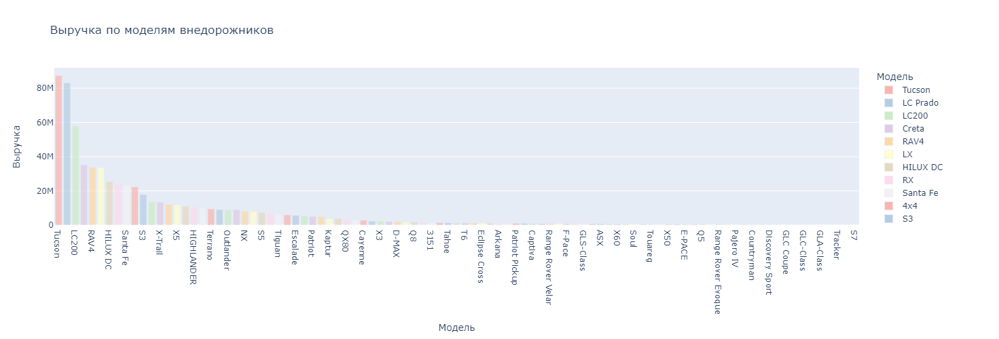

In [70]:
# столбчатая диаграмма
inc_bar(suv_cars_p4p, 'model', 'model_rev_usd', 'Модель', 'Выручка по моделям внедорожников')

<br>

Построим сводную таблицу.

In [71]:
# сводная таблица
suv_cars_p4p[['model', 'model_cars', 'model_rev_usd']].sort_values(by='model_rev_usd', ascending=False)\
                                                      .drop_duplicates()\
                                                      .reset_index(drop=True)\
                                                      .head(10)

,model,model_cars,model_rev_usd
0,Tucson,3271,87315626
1,LC Prado,1711,83134048
2,LC200,779,57893775
3,Creta,1775,35222290
4,RAV4,1213,33725122
5,LX,332,33640537
6,HILUX DC,827,25436661
7,RX,442,24363847
8,Santa Fe,639,23288672
9,4x4,2469,22338600


<br>

Отобразим распределение на круговой диаграмме.

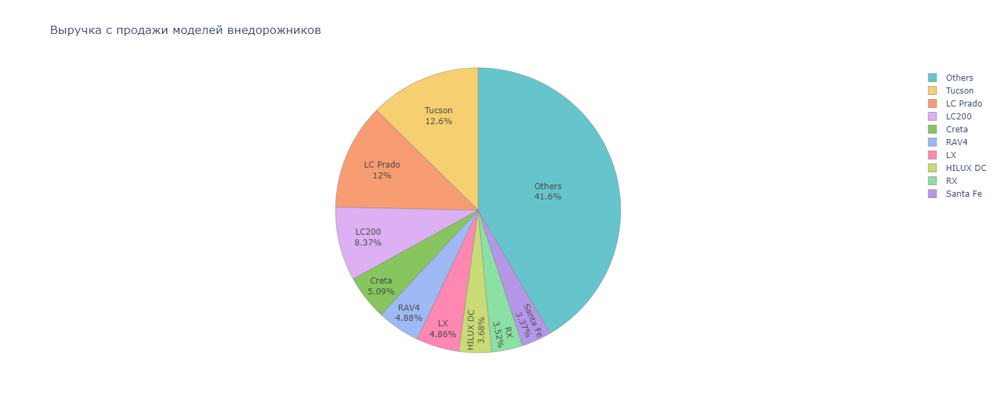

In [72]:
# круговая диаграмма
inc_pie(suv_cars_p4p, 'model', 'model_rev_usd', 'Выручка с продажи моделей внедорожников')

<span style="font-weight: 600;">Итак,</span>

| Самые доходные модели внедорожников: |
|---------------------------------------|
| 1. Остальные — $287$ $584$ $083$ $\$$ $(41.6\%)$ |
| 2. Hyundai Tucson — $87$ $315$ $626$ $\$$ $(12.6\%)$ |
| 3. Toyota Land Cruiser Prado — $83$ $134$ $048$ $\$$ $(12\%)$ |
| 4. Toyota Land Cruiser — $57$ $893$ $775$ $\$$ $(8.37\%)$ |
| 5. Hyundai Creta — $35$ $222$ $290$ $\$$ $(5.09\%)$ |
| 6. Toyota RAV4 — $33$ $725$ $122$ $\$$ $(4.88\%)$ |
| 7. Lexus LX — $33$ $640$ $537$ $\$$ $(4.86\%)$ |
| 8. Toyota Hilux — $25$ $436$ $661$ $\$$ $(3.68\%)$ |
| 9. Lexus RX — $24$ $363$ $847$ $\$$ $(3.52\%)$ |
| 10. Hyundai Santa Fe — $23$ $288$ $672$ $\$$ $(3.37\%)$ |

<br>

<br>

#### Анализ некоммерческих авто по классам 

##### Все классы

Создадим сводную таблицу.

In [73]:
# сводная таблица
classes = common_cars_p4p.pivot_table(index=['car_classification', 'car_type'], values=['model_cars', 'model_rev_usd'], aggfunc=['count', 'sum'])
classes = classes['count'].reset_index().merge(classes['sum'].reset_index(), on=['car_classification', 'car_type'])
classes = classes[['car_classification', 'car_type', 'model_cars_x', 'model_cars_y', 'model_rev_usd_y']].rename(columns={'car_classification': 'car_class',
                                                                                                                         'model_cars_x': 'models_in_class',
                                                                                                                         'model_cars_y': 'cars_in_class',
                                                                                                                         'model_rev_usd_y': 'class_revenue'})\
                                                                                                        .sort_values(by='class_revenue', ascending=False)
classes['total_cars'] = classes['cars_in_class'].sum()
classes['car_percent'] = round(classes['cars_in_class'] / classes['total_cars'] * 100, 2)
classes['total_revenue'] = classes['class_revenue'].sum()
classes['revenue_percent'] = round(classes['class_revenue'] / classes['total_revenue'] * 100, 2)
classes = classes[['car_class', 'car_type', 'models_in_class', 'cars_in_class', 'car_percent', 'total_cars', 'class_revenue', 'revenue_percent', 'total_revenue']]
classes

,car_class,car_type,models_in_class,cars_in_class,car_percent,total_cars,class_revenue,revenue_percent,total_revenue
5,D,Легковые автомобили,15,5570,11.45,48627,177188201,15.25,1161619797
4,C-SUV,Внедорожники,20,6674,13.72,48627,171391350,14.75,1161619797
1,B,Легковые автомобили,18,13880,28.54,48627,161503158,13.90,1161619797
8,E-SUV,Внедорожники,21,2841,5.84,48627,156972713,13.51,1161619797
10,F-SUV,Внедорожники,9,1425,2.93,48627,121378445,10.45,1161619797
2,B-SUV,Внедорожники,14,7986,16.42,48627,109121157,9.39,1161619797
6,D-SUV,Внедорожники,26,3007,6.18,48627,102439719,8.82,1161619797
3,C,Легковые автомобили,11,3996,8.22,48627,90062129,7.75,1161619797
11,Pick-ups,Внедорожники,5,1040,2.14,48627,30301277,2.61,1161619797
13,Компактвэн,Легковые автомобили,5,1774,3.65,48627,20552109,1.77,1161619797


Таблица показывает:
* класс авто
* тип авто
* сколько моделей представляют класс
* сколько машин в классе
* процент от машин всех классов
* всего машин
* доход, который принёс класс
* процент от дохода всех классов
* всего выручки

<br>

Построим диаграмму, которая покажет распределение кол-ва авто по классам.

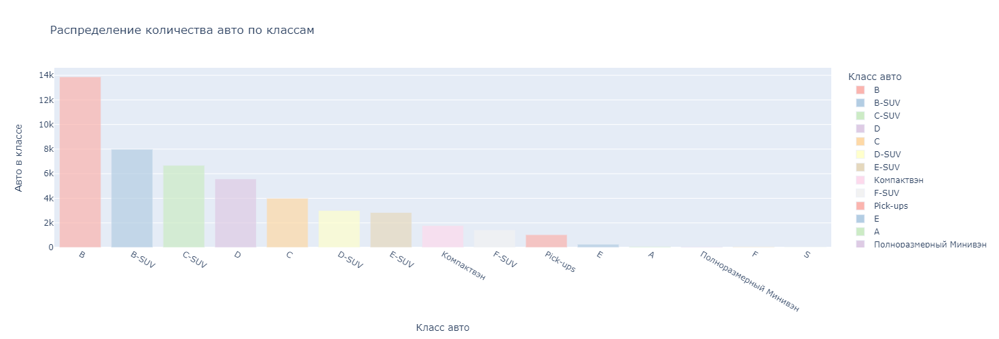

In [74]:
# столбчатая диаграмма
px.bar(classes.sort_values(by='cars_in_class', ascending=False),
       x='car_class',
       y='cars_in_class',
       color='car_class',
       title='Распределение количества авто по классам',
       labels={'car_class': 'Класс авто',
               'cars_in_class': 'Авто в классе'},
       opacity=0.7,
       height=500,
       color_discrete_sequence=px.colors.qualitative.Pastel1)\
  .show()

<br>

Построим круговые диаграммы, которые покажут процент класса от всех классов в конкретном типе авто.

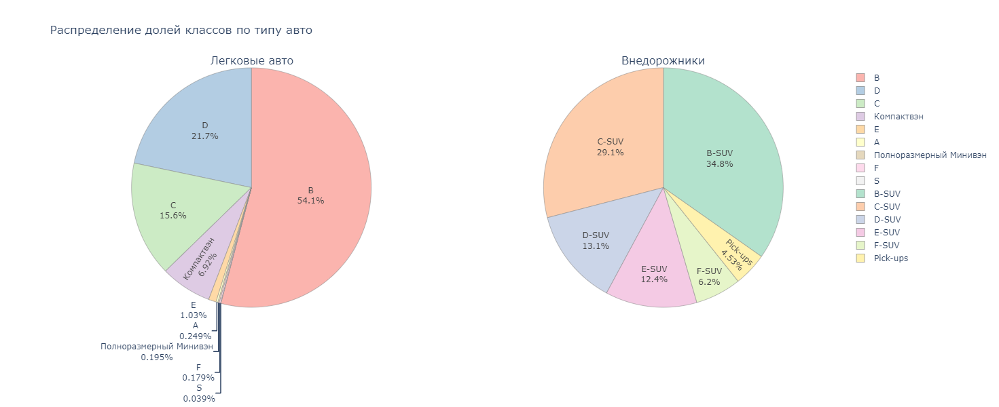

In [75]:
# круговые диаграммы
fig = make_subplots(rows=1, cols=2, 
                    specs=[[{'type':'domain'}, {'type':'domain'}]],
                    subplot_titles=['Легковые авто', 'Внедорожники'])
    
fig.add_trace(go.Pie(labels=classes.query('car_type == "Легковые автомобили"')['car_class'],
                        values=classes.query('car_type == "Легковые автомобили"')['cars_in_class'],
                        marker_line_color='#808080',
                        marker_line_width=0.5,
                        name="Легковые авто"), 1, 1)
    
fig.add_trace(go.Pie(labels=classes.query('car_type == "Внедорожники"')['car_class'],
                        values=classes.query('car_type == "Внедорожники"')['cars_in_class'],
                        marker_line_color='#808080',
                        marker_line_width=0.5,
                        name="Внедорожники"), 1, 2)

fig.update_layout(title_text='Распределение долей классов по типу авто',
                    height=600,
                    colorway=px.colors.qualitative.Pastel1 + px.colors.qualitative.Pastel2)

fig.update_traces(textinfo='percent+label')

fig.show()

<br>

Построим диаграмму, которая покажет распределение выручки с продажи авто по классам.

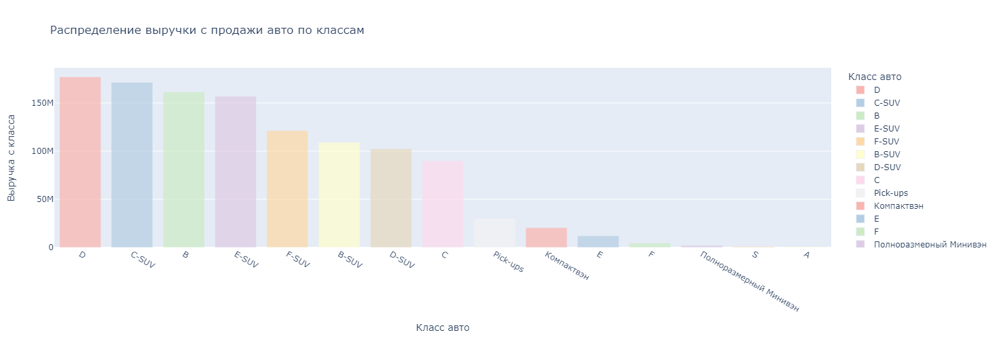

In [76]:
# столбчатая диаграмма
px.bar(classes,
       x='car_class',
       y='class_revenue',
       color='car_class',
       title='Распределение выручки с продажи авто по классам',
       labels={'car_class': 'Класс авто',
               'class_revenue': 'Выручка с класса'},
       opacity=0.7,
       height=500,
       color_discrete_sequence=px.colors.qualitative.Pastel1)\
  .show()

<br>

Построим круговые диаграммы, которые покажут процент выручки класса от всех классов в конкретном типе авто.

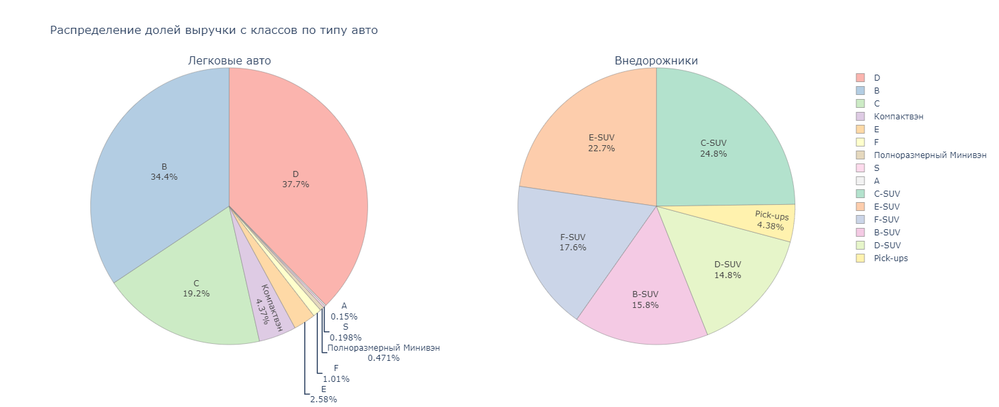

In [77]:
# круговые диаграммы
fig = make_subplots(rows=1, cols=2, 
                    specs=[[{'type':'domain'}, {'type':'domain'}]],
                    subplot_titles=['Легковые авто', 'Внедорожники'])
    
fig.add_trace(go.Pie(labels=classes.query('car_type == "Легковые автомобили"')['car_class'],
                        values=classes.query('car_type == "Легковые автомобили"')['class_revenue'],
                        marker_line_color='#808080',
                        marker_line_width=0.5,
                        marker=dict(colors=px.colors.qualitative.Pastel1),
                        name="Легковые авто"), 1, 1)
    
fig.add_trace(go.Pie(labels=classes.query('car_type == "Внедорожники"')['car_class'],
                        values=classes.query('car_type == "Внедорожники"')['class_revenue'],
                        marker_line_color='#808080',
                        marker_line_width=0.5,
                        marker=dict(colors=px.colors.qualitative.Pastel2),
                        name="Внедорожники"), 1, 2)

fig.update_layout(title_text='Распределение долей выручки с классов по типу авто',
                    height=600)
    
fig.update_traces(textinfo='percent+label')
    

fig.show()

<br>

<span style="font-weight: 600;">Итак,</span>

| $5$ самых продаваемых классов: | $5$ самых доходных классов: |
|---------------------------------------|---------------------------------------|
| 1. B — $13$ $880$ авто $(28.54\%)$ | 1. D — $177$ $188$ $201$ авто $(15.25\%)$ |
| 2. B-SUV — $7$ $986$ авто $(16.42\%)$ | 2. C-SUV — $171$ $391$ $350$ авто $(14.75\%)$ |
| 3. C-SUV — $6$ $674$ авто $(13.72\%)$ | 3. B — $161$ $503$ $158$ авто $(13.9\%)$ |
| 4. D — $5$ $570$ авто $(11.45\%)$ | 4. E-SUV — $156$ $972$ $713$ авто $(13.51\%)$ |
| 5. C — $3$ $996$ авто $(8.22\%)$ | 5. F-SUV — $121$ $378$ $445$ авто $(10.45\%)$ |
| 6. Все остальные — $10$ $521$ авто $(21.65\%)$ | 6. Все остальные — $373$ $185$ $930$ авто $(32.14\%)$ |

<span style="font-weight: 600;">Таким образом, самые релевантные классы:</span>
* Легковые (B, C, D) — $91.3\%$  от всех легковых.
* Внедорожники (B, C, D, E, F) — $95.7\%$ от всех внедорожников.

<br>

##### Релевантные классы

In [78]:
# функция для анализа релевантных классов

def top_class(car_type, car_class, title, N):
    pt = car_type[['brand', 'model', 'car_classification', 'model_cars', 'model_perc', 'model_rev_usd', 'inside_class_rank', 'model_rank', 'pie_top_inside_class_rank']].query(car_class).head(10)
    display(pt)
    
    bar = px.bar(car_type[['model', 'car_classification', 'model_cars']].query(car_class),
                 x='model',
                 y='model_cars',
                 color='model',
                 labels={'model': 'Модель',
                         'model_cars': 'Автомобилей'},
                 title=title,
                 opacity=0.7,
                 color_discrete_sequence=px.colors.qualitative.Pastel2)
    bar.show()
    
    
    # получение N наиболее часто встречающихся моделей
    top_models = car_type.query(car_class).nlargest(N, 'model_cars')
    
    # суммирование оставшихся значений
    other_count = car_type.query(car_class)['model_cars'].sum() - top_models['model_cars'].sum()
    
    # добавление строки "Другие"
    other_row = pd.DataFrame({'model': ['Другие'],
                              'model_cars': [other_count]})
    
    # объединение топ-моделей с "Другие"
    combined_df = pd.concat([top_models, other_row])
    
    # построение круговой диаграммы
    pie = go.Figure(data=[go.Pie(labels=combined_df['model'], 
                                 values=combined_df['model_cars'],
                                 textinfo='percent+label',
                                 hoverinfo='label+value+percent',
                                 marker=dict(colors=px.colors.qualitative.Pastel),
                                 marker_line_color='#808080',
                                 marker_line_width=0.5)])
    pie.update_layout(height=600, 
                      title=title,
                      title_x=0.5)
    
    # отображение диаграммы
    pie.show()

<br>

##### B класс

Сводная таблица, столбчатая и круговая диаграммы.

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
0,Lada,Granta,B,3665,14.286,26679004,1,2,Granta
1,Lada,Vesta,B,2653,10.341,31116276,2,3,Vesta
8,Hyundai,Accent,B,2211,8.619,36481919,3,4,Accent
12,Ravon,Nexia R3,B,1700,6.627,16715009,4,6,Nexia R3
20,Volkswagen,Polo,B,1032,4.023,15715359,5,9,Остальные
14,Kia,Rio,B,993,3.871,13755500,6,10,Остальные
3,Lada,XRAY,B,603,2.351,8290600,7,11,Остальные
26,Renault,Sandero,B,441,1.719,5669873,8,12,Остальные
27,Renault,Logan,B,320,1.247,3750559,9,15,Остальные
31,Skoda,Rapid,B,96,0.374,1356500,10,21,Остальные


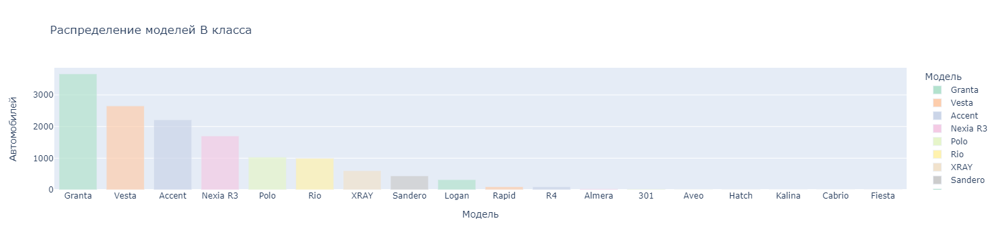

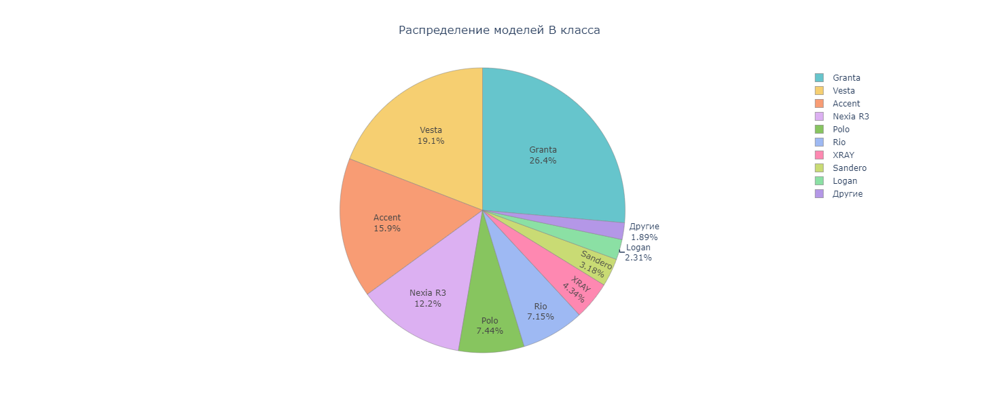

In [79]:
top_class(passenger_cars_p4p, "car_classification == 'B'", 'Распределение моделей B класса', 9)

| Самые продаваемые модели класса B: |
|---------------------------------------|
| 1. Lada Granta — $3$ $665$ авто $(26.4\%)$ |
| 2. Lada Vesta — $2$ $653$ авто $(19.1\%)$ |
| 3. Hyundai Accent — $2$ $211$ авто $(15.9\%)$ |
| 4. Ravon Nexia R3 — $1$ $700$ авто $(12.2\%)$ |
| 5. Volkswagen Polo — $1$ $032$ авто $(7.44\%)$ |
| 6. Kia Rio — $993$ авто $(7.15\%)$ |
| 7. Lada XRAY — $603$ авто $(4.34\%)$ |
| 8. Renault Sandero — $441$ авто $(3.18\%)$ |
| 9. Renault Logan — $320$ авто $(2.31\%)$ |
| 10. Остальные — $262$ авто $(1.89\%)$ |

<br>

##### C класс

Сводная таблица, столбчатая и круговая диаграммы.

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
9,Hyundai,Elantra,C,2062,8.038,41268941,1,5,Elantra
7,Toyota,Corolla,C,1089,4.245,33896714,2,8,Corolla
29,Skoda,Octavia,C,383,1.493,7188100,3,13,Octavia
15,Kia,Cerato,C,348,1.357,6208800,4,14,Cerato
34,Lifan,Solano,C,97,0.378,1077105,5,20,Остальные
40,Mazda,3,C,5,0.019,107885,6,39,Остальные
49,Mercedes-Benz,A-Class,C,5,0.019,131635,6,39,Остальные
23,Volkswagen,Jetta,C,3,0.012,53434,7,41,Остальные
61,Audi,A3,C,2,0.008,60362,8,42,Остальные
53,Mercedes-Benz,CLA-Class,C,1,0.004,38327,9,43,Остальные


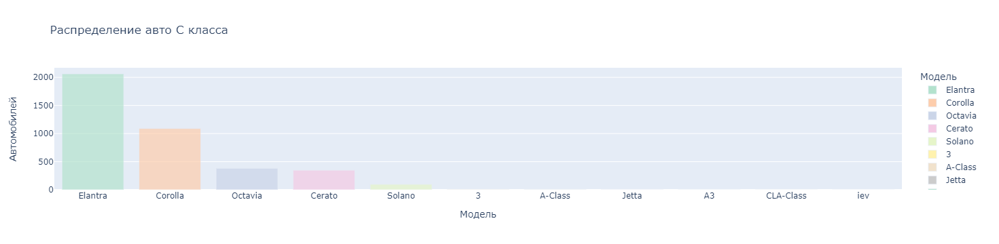

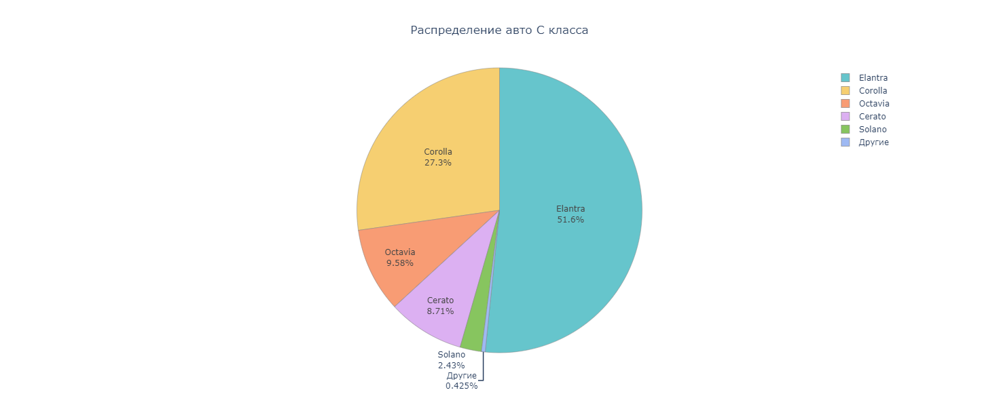

In [80]:
top_class(passenger_cars_p4p, "car_classification == 'C'", 'Распределение авто C класса', 5)

<br>

| Самые продаваемые модели C класса: |
|---------------------------------------|
| 1. Hyundai Elantra — $2$ $062$ авто $(51.6\%)$ |
| 2. Toyota Corolla — $1$ $089$ авто $(27.3\%)$ |
| 3. Skoda Octavia — $383$ авто $(9.58\%)$ |
| 4. Kia Cerato — $348$ авто $(8.71\%)$ |
| 5. Lifan Solano — $97$ авто $2.43\%$ |
| 6. Остальные — $17$ авто $(0.425\%)$ |

<br>

##### D класс

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
6,Toyota,Camry,D,4853,18.917,155748694,1,1,Camry
10,Hyundai,Sonata,D,188,0.733,4839193,2,16,Sonata
30,Skoda,Superb,D,178,0.694,6322158,3,18,Superb
16,Kia,Optima,D,160,0.624,3679000,4,19,Optima
37,Subaru,Outback,D,95,0.370,3730483,5,22,Остальные
39,Mazda,6,D,56,0.218,1436025,6,24,Остальные
18,Kia,Stinger,D,9,0.035,369000,7,35,Остальные
71,Infiniti,Q50,D,8,0.031,308465,8,36,Остальные
38,Subaru,Legacy,D,8,0.031,274871,8,36,Остальные
36,Lifan,Murman,D,4,0.016,62981,9,40,Остальные


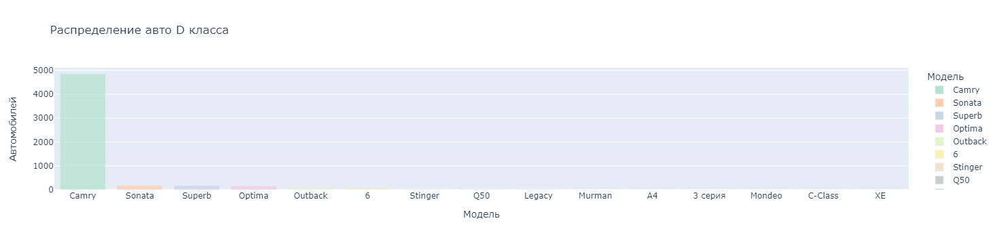

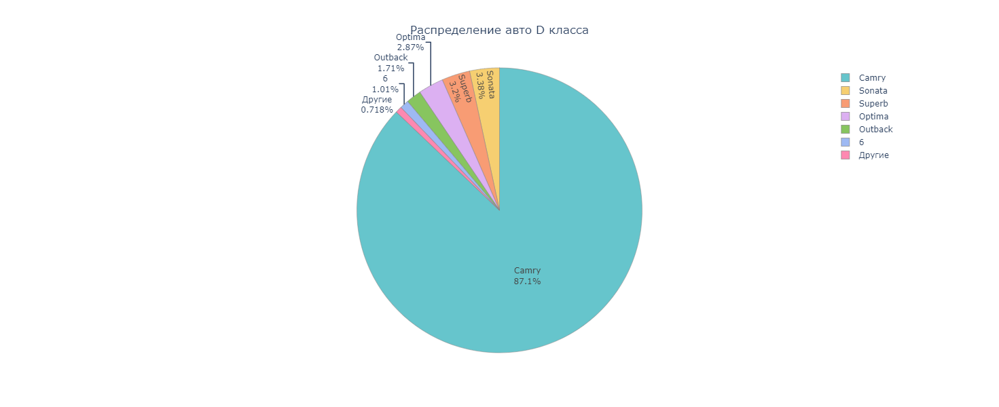

In [81]:
top_class(passenger_cars_p4p, "car_classification == 'D'", 'Распределение авто D класса', 6)

<br>

| Самые продаваемые модели D класса: |
|---------------------------------------|
| 1. Toyota Camry — $4$ $853$ авто $(81.1\%)$ |
| 2. Hyundai Sonata — $188$ авто $(3.38\%)$ |
| 3. Skoda Superb — $178$ авто $(3.2\%)$ |
| 4. Kia Optima — $160$ авто $(2.87\%)$ |
| 5. Subaru Outback — $95$ авто $(1.71\%)$ |
| 6. Mazda 6 — $56$ авто $(1.01\%)$ |
| 5. Остальные — $40$ авто $(0.718\%)$ |

<br>

##### B-SUV класс

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
9,Lada,4x4,B-SUV,2469,10.747,22338600,1,2,4x4
1,Hyundai,Creta,B-SUV,1775,7.726,35222290,2,3,Creta
10,Jac,S3,B-SUV,1355,5.898,17847506,3,5,S3
25,Renault,Duster,B-SUV,707,3.078,9085730,4,9,Duster
15,Nissan,Terrano,B-SUV,582,2.533,9462344,5,12,Остальные
32,Chevrolet,Niva,B-SUV,567,2.468,5943233,6,13,Остальные
26,Renault,Kaptur,B-SUV,230,1.001,3812606,7,22,Остальные
38,UAZ,3151,B-SUV,128,0.557,1576015,8,29,Остальные
8,Toyota,C-HR,B-SUV,76,0.331,2125916,9,33,Остальные
75,Lifan,X50,B-SUV,38,0.165,461026,10,43,Остальные


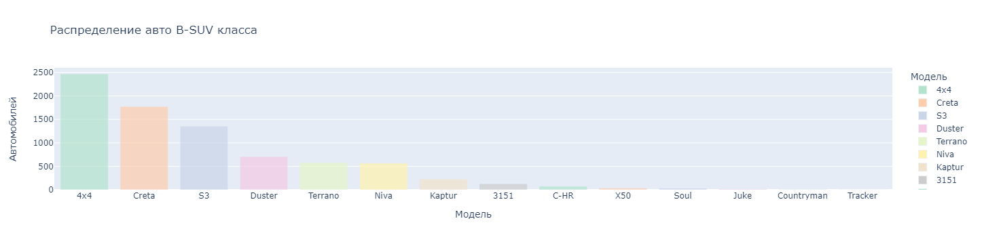

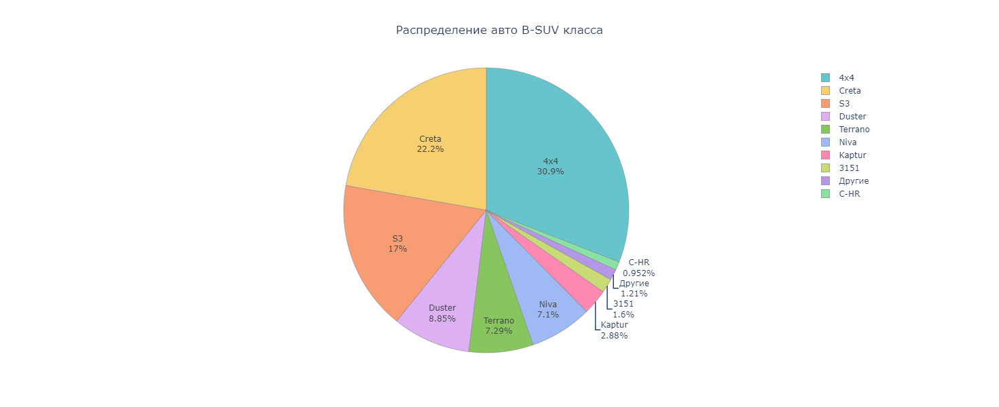

In [82]:
top_class(suv_cars_p4p, "car_classification == 'B-SUV'", 'Распределение авто B-SUV класса', 9)

| Самые продаваемые модели класса B-SUV: |
|---------------------------------------|
| 1. Lada 4x4 — $2$ $469$ авто $(30.9\%)$ |
| 2. Hyundai Creta — $1$ $775$ авто $(22.2\%)$ |
| 3. Jac S3 — $1$ $355$ авто $(17\%)$ |
| 4. Renault Duster — $707$ авто $(8.85\%)$ |
| 5. Nissan Terrano — $582$ авто $(7.29\%)$ |
| 6. Chevrolet Niva — $567$ авто $(7.1\%)$ |
| 7. Renault Kaptur — $230$ авто $(2.88\%)$ |
| 8. УАЗ 3151 — $128$ авто $(3.18\%)$ |
| 9. Остальные — $97$ авто $(1.21\%)$ |
| 10. Toyota C-HR — $76$ авто $(0.952\%)$ |

<br>

##### C-SUV класс

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
0,Hyundai,Tucson,C-SUV,3271,14.238,87315626,1,1,Tucson
4,Toyota,RAV4,C-SUV,1213,5.280,33725122,2,6,RAV4
14,Nissan,Qashqai,C-SUV,601,2.616,13567154,3,11,Qashqai
11,Jac,S5,C-SUV,486,2.116,7422826,4,14,S5
30,Kia,Sportage,C-SUV,357,1.554,7968400,5,18,Остальные
54,Volkswagen,Tiguan,C-SUV,194,0.844,6376434,6,24,Остальные
58,Mazda,CX-5,C-SUV,182,0.792,4951896,7,26,Остальные
46,Subaru,XV,C-SUV,110,0.479,3191634,8,30,Остальные
74,Lifan,X60,C-SUV,59,0.257,744667,9,39,Остальные
27,Renault,Arkana,C-SUV,55,0.239,1095030,10,40,Остальные


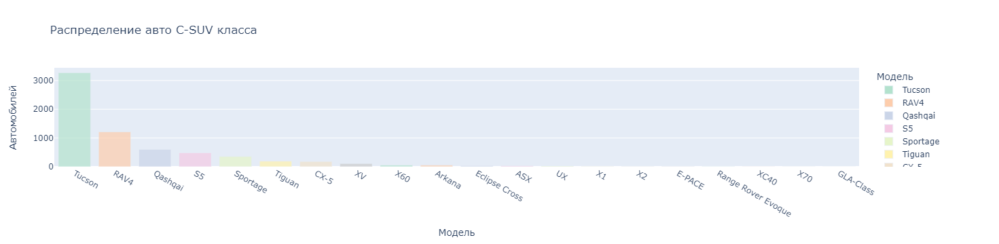

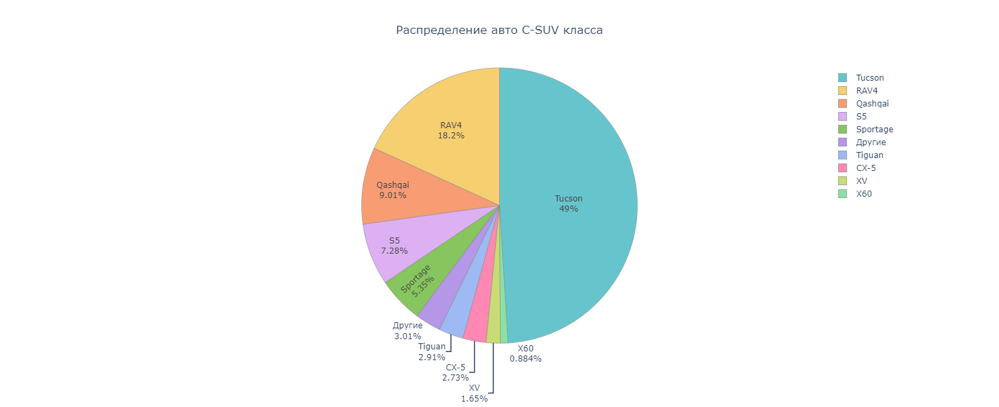

In [83]:
top_class(suv_cars_p4p, "car_classification == 'C-SUV'", 'Распределение авто C-SUV класса', 9)

<br>

| Самые продаваемые модели класса C-SUV: |
|---------------------------------------|
| 1. Hyundai Tucson — $3$ $271$ авто $(49\%)$ |
| 2. Toyota RAV4 — $1$ $213$ авто $(18.2\%)$ |
| 3. Nissan Qashqai — $601$ авто $(9.01\%)$ |
| 4. Jac S5 — $486$ авто $(7.28\%)$ |
| 5. Kia Sportage — $357$ авто $(5.35\%)$ |
| 6. Остальные — $201$ авто $(3.01\%)$ |
| 7. Volkswagen Tiguan — $194$ авто $(2.91\%)$ |
| 8. Mazda CX-5 — $182$ авто $(2.73\%)$ |
| 9. Subaru XV — $110$ авто $(1.65\%)$ |
| 10. Lifan X60 — $59$ авто $(0.884\%)$ |

<br>

##### D-SUV класс

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
2,Hyundai,Santa Fe,D-SUV,639,2.782,23288672,1,10,Santa Fe
16,Nissan,X-Trail,D-SUV,409,1.780,13414340,2,16,X-Trail
29,Kia,Sorento,D-SUV,388,1.689,12075200,3,17,Sorento
37,UAZ,Patriot,D-SUV,324,1.410,5120370,4,20,Patriot
45,Subaru,Forester,D-SUV,291,1.267,8992368,5,21,Остальные
40,Mitsubishi,Outlander,D-SUV,291,1.267,9013604,5,21,Остальные
21,Lexus,NX,D-SUV,192,0.836,8164258,6,25,Остальные
66,Skoda,Kodiaq,D-SUV,136,0.592,5416000,7,28,Остальные
41,Mitsubishi,Pajero Sport,D-SUV,81,0.353,3717719,8,32,Остальные
49,BMW,X3,D-SUV,54,0.235,2238768,9,41,Остальные


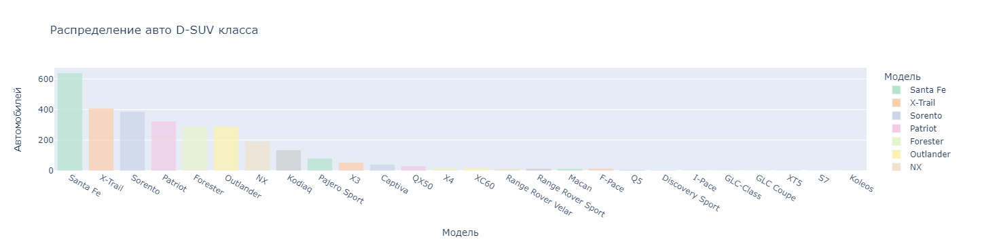

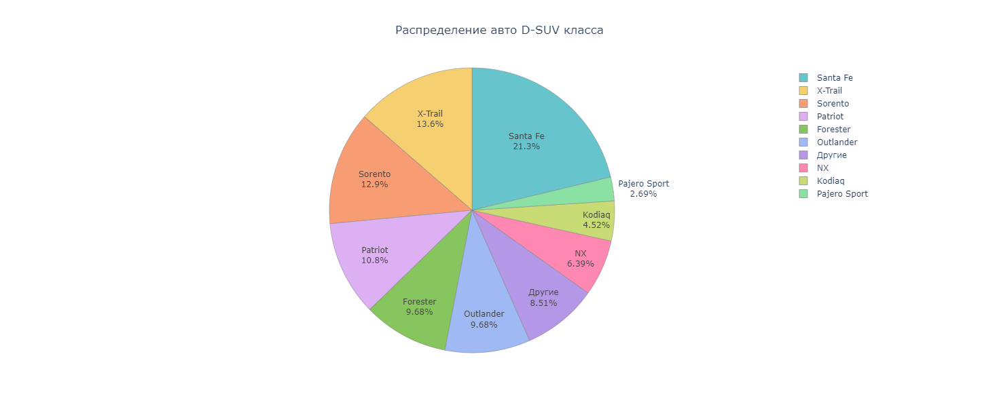

In [84]:
top_class(suv_cars_p4p, "car_classification == 'D-SUV'", 'Распределение авто D-SUV класса', 9)

<br>

| Самые продаваемые модели класса D-SUV: |
|---------------------------------------|
| 1. Hyundai Santa Fe — $639$ авто $(21.3\%)$ |
| 2. Nissan X-Trail — $409$ авто $(13.6\%)$ |
| 3. Kia Sorento — $388$ авто $(12.9\%)$ |
| 4. UAZ Patriot — $324$ авто $(10.8\%)$ |
| 5. Subaru Forester — $291$ авто $(9.68\%)$ |
| 6. Mitsubishi Outlander — $291$ авто $(9.68\%)$ |
| 7. Остальные — $256$ авто $(8.51\%)$ |
| 8. Lexus NX — $192$ авто $(6.39\%)$ |
| 9. Skoda Kodiaq — $136$ авто $(4.52\%)$ |
| 10. Mitsubishi Pajero Sport — $81$ авто $(2.69\%)$ |

<br>

##### E-SUV класс

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
3,Toyota,LC Prado,E-SUV,1711,7.448,83134048,1,4,LC Prado
19,Lexus,RX,E-SUV,442,1.924,24363847,2,15,RX
7,Toyota,HIGHLANDER,E-SUV,197,0.858,10538923,3,23,HIGHLANDER
47,BMW,X5,E-SUV,168,0.731,11760406,4,27,X5
67,Mercedes-Benz,G-Class,E-SUV,67,0.292,9815013,5,36,Остальные
59,Mazda,CX-9,E-SUV,36,0.157,1721165,6,44,Остальные
50,BMW,X6,E-SUV,33,0.144,2348620,7,45,Остальные
83,Porsche,Cayenne,E-SUV,28,0.122,2856256,8,48,Остальные
17,Nissan,Murano,E-SUV,25,0.109,1149249,9,49,Остальные
23,Lexus,GX,E-SUV,22,0.096,1320875,10,51,Остальные


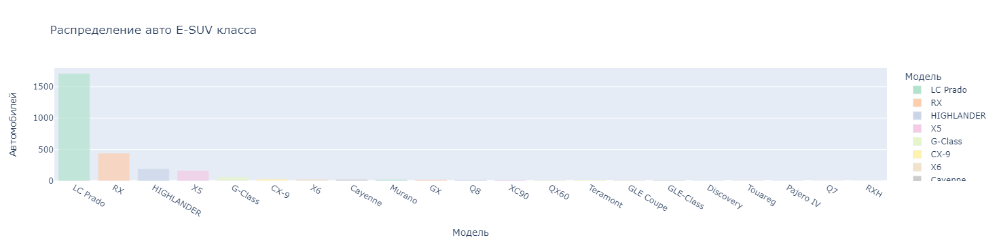

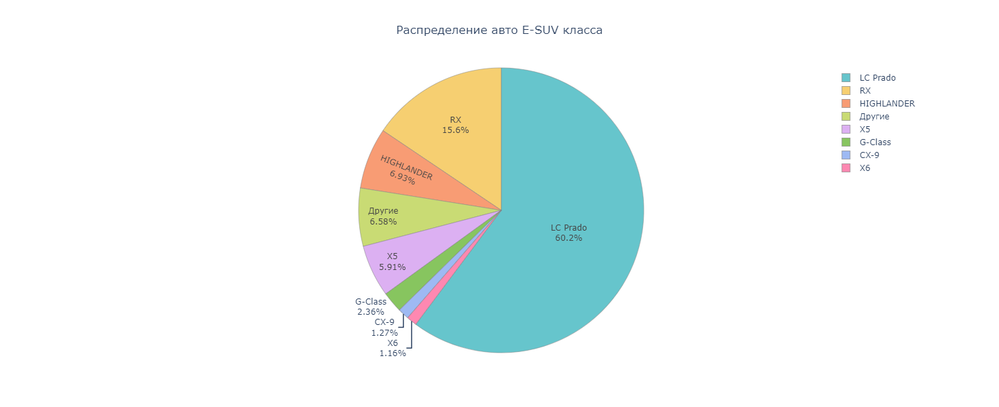

In [85]:
top_class(suv_cars_p4p, "car_classification == 'E-SUV'", 'Распределение авто E-SUV класса', 7)

<br>

| Самые продаваемые модели класса E-SUV: |
|---------------------------------------|
| 1. Toyota Land Cruiser Prado — $1$ $711$ авто $(60.2\%)$ |
| 2. Lexus RX — $442$ авто $(15.6\%)$ |
| 3. Toyota Highlander — $197$ авто $(6.93\%)$ |
| 4. Остальные — $187$ авто $(6.58\%)$ |
| 5. BMW X5 — $168$ авто $(5.91\%)$ |
| 6. Mercedes-Benz G-Class — $67$ авто $(2.36\%)$ |
| 7. Mazda CX-9 — $36$ авто $(1.27\%)$ |
| 8. BMW X6 — $33$ авто $(1.16\%)$ |

<br>

##### F-SUV класс

,brand,model,car_classification,model_cars,model_perc,model_rev_usd,inside_class_rank,model_rank,pie_top_inside_class_rank
6,Toyota,LC200,F-SUV,779,3.391,57893775,1,8,LC200
20,Lexus,LX,F-SUV,332,1.445,33640537,2,19,LX
60,Land Rover,Range Rover,F-SUV,89,0.387,11080818,3,31,Range Rover
48,BMW,X7,F-SUV,76,0.331,6868100,4,33,X7
81,Cadillac,Escalade,F-SUV,70,0.305,5738476,5,35,Остальные
77,Infiniti,QX80,F-SUV,42,0.183,3655053,6,42,Остальные
34,Chevrolet,Tahoe,F-SUV,20,0.087,1333692,7,52,Остальные
70,Mercedes-Benz,GLS-Class,F-SUV,10,0.044,791465,8,61,Остальные
35,Chevrolet,Traverse,F-SUV,7,0.030,376529,9,64,Остальные


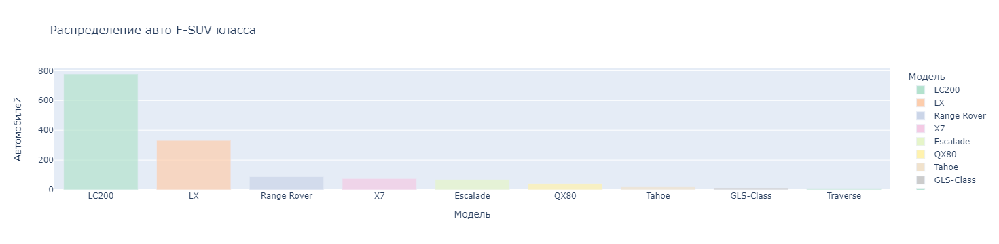

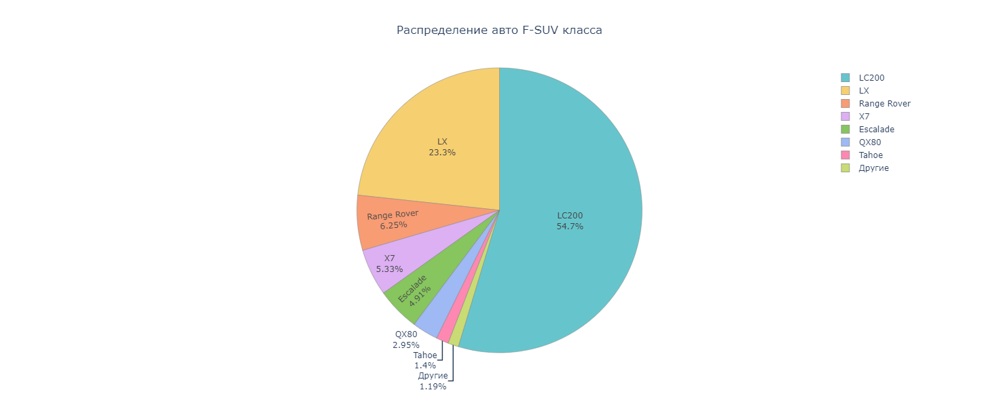

In [86]:
top_class(suv_cars_p4p, "car_classification == 'F-SUV'", 'Распределение авто F-SUV класса', 7)

<br>

| Самые продаваемые модели класса F-SUV: |
|---------------------------------------|
| 1. Toyota Land Cruiser — $779$ авто $(54.7\%)$ |
| 2. Lexus LX — $332$ авто $(23.3\%)$ |
| 3. Land Rover Range Rover — $89$ авто $(6.25\%)$ |
| 4. BMW X7 — $76$ авто $(5.33\%)$ |
| 5. Cadillac Escalade — $70$ авто $(4.91\%)$ |
| 6. Infiniti QX80 — $42$ авто $(2.95\%)$ |
| 7. Chevrolet Tahoe — $20$ авто $(1.4\%)$ |
| 8. Остальные — $17$ авто $(1.19\%)$ |

<br>

#### Промежуточный вывод

| Самые продаваемые марки авто | Самые продаваемые модели легковых авто | Самые продаваемые модели внедорожников |
|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada — $11$ $094$ авто $(22.8\%)$ | 1. Toyota Camry — $4$ $853$ авто $(19.1\%)$ | 1. Hyundai Tucson — $3$ $271$ авто $(14.7\%)$ |
| 2. Toyota — $10$ $745$ авто $(22.1\%)$ | 2. Lada Granta — $3$ $665$ авто $(14.4\%)$ | 2. Lada 4x4 — $2$ $469$ авто $(11.1\%)$ |
| 3. Hyundai — $10$ $168$ авто $(20.9\%)$ | 3. Lada Vesta — $2$ $653$ авто $(10.4\%)$ | 3. Hyundai Creta — $1$ $775$ авто $(7.96\%)$ |
| 4. Kia — $2$ $359$ авто $(4.86\%)$ | 4. Hyundai Accent — $2$ $211$ авто $(8.69\%)$ | 4. Toyota Land Cruiser Prado — $1$ $711$ авто $(7.67\%)$ |
| 5. Все остальные — $14$ $269$ авто $(29.3\%)$ | 5. Остальные — $12$ $061$ авто $(47.4\%)$ | 5. Остальные — $13$ $085$ авто $(58.6\%)$ |


<br>

| Самые продаваемые марки эконом класса | Самые продаваемые марки комфорт класса | Самые продаваемые марки бизнес класса | Самые продаваемые марки премиум класса |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada — $7$ $690$ авто $(72.8\%)$ | 1. Hyundai — $5$ $843$ авто $(32.4\%)$ | 1. Toyota — $7$ $961$ авто $(50.1\%)$ | 1. Toyota — $2$ $234$ авто $(55\%)$ |
| 2. Ravon — $1$ $795$ авто $(17\%)$ | 2. Lada — $3$ $404$ авто $(18.9\%)$ | 2. Hyundai — $4$ $325$ авто $(27.2\%)$ | 2. Lexus — $824$ авто $(20.3\%)$ |
| 3. Chevrolet — $567$ авто $(5.36\%)$ | 3. Kia — $1$ $796$ авто $(9.95\%)$ | 3. Nissan — $706$ авто $(4.44\%)$ | 3. BMW — $328$ авто $(8.07\%)$ |
| 4. Jac — $198$ авто $(1.87\%)$ | 4. Jac — $1$ $671$ авто $(9.25\%)$ | 4. Subaru — $504$ авто $(3.17\%)$ | 4. Land Rover — $129$ авто $(3.18\%)$ |
| 5. Все остальные — $319$ авто $(3.02\%)$ | 5. Все остальные — $5$ $311$ авто $(29.6\%)$ | 5. Все остальные — $2$ $405$ авто $(15.1\%)$ | 5. Все остальные — $578$ авто $(13.5\%)$ |


<br>

| Самые доходные марки авто | Самые доходные модели легковых авто | Самые доходные модели внедорожников |
|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Toyota — $402$ $499$ $853$ $\$$ $(34.6\%)$ | 1. Toyota Camry — $155$ $748$ $694$ $\$$ $(33.1\%)$ | 1. Остальные — $287$ $584$ $083$ $\$$ $(41.6\%)$ |
| 2. Hyundai — $229$ $307$ $388$ $\$$ $(19.7\%)$ | 2. Остальные — $93$ $220$ $020$ $\$$ $(19.8\%)$ | 2. Hyundai Tucson — $87$ $315$ $626$ $\$$ $(12.6\%)$ |
| 3. Остальные — $180$ $039$ $613$ $\$$ $(15.5\%)$ | 3. Hyundai Elantra — $41$ $268$ $941$ $\$$ $(8.78\%)$ | 3. Toyota Land Cruiser Prado — $83$ $134$ $048$ $\$$ $(12\%)$ |
| 4. Lada — $107$ $868$ $380$ $\$$ $(9.29\%)$ | 4. Hyundai Accent — $36$ $481$ $919$ $\$$ $(7.76\%)$ | 4. Toyota Land Cruiser — $57$ $893$ $775$ $\$$ $(8.37\%)$ |
| 5. Lexus — $77$ $376$ $345$ $\$$ $(6.66\%)$ | 5. Toyota Corolla — $33$ $896$ $714$ $\$$ $(7.21\%)$ | 5. Hyundai Creta — $35$ $222$ $290$ $\$$ $(5.09\%)$ |
| 6. Kia — $45$ $690$ $400$ $\$$ $(3.93\%)$ | 6. Lada Vesta — $31$ $116$ $276$ $\$$ $(6.62\%)$ | 6. Toyota RAV4 — $33$ $725$ $122$ $\$$ $(4.88\%)$ |
| 7. Nissan — $38$ $356$ $900$ $\$$ $(3.3\%)$ | 7. Lada Granta — $26$ $679$ $004$ $\$$ $(5.68\%)$ | 7. Lexus LX — $33$ $640$ $537$ $\$$ $(4.86\%)$ |
| 8. BMW — $28$ $735$ $770$ $\$$ $(2.47\%)$ | 8. Lada Largus — $19$ $173$ $200$ $\$$ $(4.08\%)$ | 8. Toyota Hilux — $25$ $436$ $661$ $\$$ $(3.68\%)$ |
| 9. Jac — $26$ $595$ $440$ $\$$ $(2.29\%)$ | 9. Ravon Nexia R3 — $16$ $715$ $009$ $\$$ $(3.56\%)$ | 9. Lexus RX — $24$ $363$ $847$ $\$$ $(3.52\%)$ |
| 10. Volkswagen — $25$ $149$ $708$ $\$$ $(2.17\%)$ | 10. Volkswagen Polo — $15$ $715$ $359$ $\$$ $(3.34\%)$ | 10. Hyundai Santa Fe — $23$ $288$ $672$ $\$$ $(3.37\%)$ |


<br>

| Самые продаваемые эконом модели легковых авто  | Самые продаваемые комфорт модели легковых авто | Самые продаваемые 'бизнес' модели легковых авто | Самые продаваемые премиум модели легковых авто |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada Granta — $3$ $665$ авто $(50\%)$ | 1. Lada Vesta — $2$ $644$ авто $(22.4\%)$ | 1. Toyota Camry — $4$ $578$ авто $(75\%)$ | 1. Toyota Camry — $275$ авто $(75.8\%)$ |
| 2. Ravon Nexia R3 — $1$ $700$ авто $(23.2\%)$ | 2. Hyundai Accent — $2$ $211$ авто $(18.8\%)$ | 2. Toyota Corolla — $539$ авто $(8.83\%)$ | 2. BMW 5 серия — $33$ авто $(9.09\%)$ |
| 3. Lada Largus — $1$ $544$ авто $(21\%)$ | 3. Hyundai Elantra — $1$ $830$ авто $(15.5\%)$ | 3. Hyundai Elantra — $232$ авто $(3.8\%)$ | 3. Lexus LS — $9$ авто $(2.48\%)$ |
| 4. Renault Logan — $149$ авто $(2.03\%)$ | 4. Volkswagen Polo — $1$ $032$ авто $(8.75\%)$ | 4. Lexus ES — $180$ авто $(2.95\%)$ | 4. Volkswagen Multivan — $8$ авто $(2.2\%)$ |
| 5. Все остальные — $277$ авто $(3.78\%)$ | 5. Все остальные — $4$ $071$ авто $(34.5\%)$ | 5. Все остальные — $575$ авто $(9.42\%)$ | 4. BMW 7 серия — $8$ авто $(2.2\%)$ |
|                                          |                                              |                                          | 4. Porsche Panamera — $8$ авто $(2.2\%)$ |
|                                          |                                              |                                          | 5. Все остальные — $22$ авто $(6.06\%)$ |


<br>

| Самые продаваемые эконом модели внедорожников  | Самые продаваемые комфорт модели внедорожников | Самые продаваемые 'бизнес' модели внедорожников | Самые продаваемые премиум модели внедорожников |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada 4x4 — $2$ $469$ авто $(76.3\%)$ | 1. Hyundai Creta — $1$ $656$ авто $(26.5\%)$ | 1. Hyundai Creta — $3$ $174$ авто $(33.6\%)$ | 1. Toyota Land Cruiser Prado — $989$ авто $(27.9\%)$ |
| 2. Chevrolet Niva — $567$ авто $(17.5\%)$ | 2. Jac S3 — $1$ $272$ авто $(20.3\%)$ | 2. Toyota RAV4 — $1$ $213$ авто $(12.9\%)$ | 2. Toyota Land Cruiser — $779$ авто $(22\%)$ |
| 3. Jac S5 — $104$ авто $(3.22\%)$ | 3. Renault Duster — $707$ авто $(11.3\%)$ | 3. Toyota Hilux — $827$ авто $(8.76\%)$ | 3. Lexus RX — $439$ авто $(12.4\%)$ |
| 4. Jac S3 — $83$ авто $(2.57\%)$ | 4. Nissan Terrano — $582$ авто $(9.3\%)$ | 4. Toyota Land Cruiser Prado — $722$ авто $(7.65\%)$  | 4. Lexus LX — $318$ авто $(8.97\%)$ |
| 5. Остальные — $11$ авто $(0.34\%)$ | 5. Все остальные — $2$ $038$ авто $(32.6\%)$ | 5. Все остальные — $3$ $500$ авто $(37.1\%)$ | 5. Все остальные — $1$ $019$ авто $(28.8\%)$ |

<br>

| $5$ самых продаваемых классов: | $5$ самых доходных классов: |
|---------------------------------------|---------------------------------------|
| 1. B — $13$ $880$ авто $(28.54\%)$ | 1. D — $177$ $188$ $201$ $\$$ $(15.25\%)$ |
| 2. B-SUV — $7$ $986$ авто $(16.42\%)$ | 2. C-SUV — $171$ $391$ $350$ $\$$ $(14.75\%)$ |
| 3. C-SUV — $6$ $674$ авто $(13.72\%)$ | 3. B — $161$ $503$ $158$ $\$$ $(13.9\%)$ |
| 4. D — $5$ $570$ авто $(11.45\%)$ | 4. E-SUV — $156$ $972$ $713$ $\$$ $(13.51\%)$ |
| 5. C — $3$ $996$ авто $(8.22\%)$ | 5. F-SUV — $121$ $378$ $445$ $\$$ $(10.45\%)$ |
| 6. Все остальные — $10$ $521$ авто $(21.65\%)$ | 6. Все остальные — $373$ $185$ $930$ $\$$ $(32.14\%)$ |

<span style="font-weight: 600;">Таким образом, самые релевантные классы:</span>
* Легковые (B, C, D) — $91.3\%$  от всех легковых.
* Внедорожники (B, C, D, E, F) — $95.7\%$ от всех внедорожников.

<br>

| Самые продаваемые модели B класса | Самые продаваемые модели C класса | Самые продаваемые модели D класса |
|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada Granta — $3$ $665$ авто $(26.4\%)$ | 1. Hyundai Elantra — $2$ $062$ авто $(51.6\%)$ | 1. Toyota Camry — $4$ $853$ авто $(81.1\%)$ |
| 2. Lada Vesta — $2$ $653$ авто $(19.1\%)$ | 2. Toyota Corolla — $1$ $089$ авто $(27.3\%)$ | 2. Hyundai Sonata — $188$ авто $(3.38\%)$ |
| 3. Hyundai Accent — $2$ $211$ авто $(15.9\%)$ | 3. Skoda Octavia — $383$ авто $(9.58\%)$ | 3. Skoda Superb — $178$ авто $(3.2\%)$ |
| 4. Ravon Nexia R3 — $1$ $700$ авто $(12.2\%)$ | 4. Kia Cerato — $348$ авто $(8.71\%)$ | 4. Kia Optima — $160$ авто $(2.87\%)$ |
| 5. Volkswagen Polo — $1$ $032$ авто $(7.44\%)$ | 5. Lifan Solano — $97$ авто $2.43\%$ | 5. Subaru Outback — $95$ авто $(1.71\%)$ |
| 6. Kia Rio — $993$ авто $(7.15\%)$ | 6. Остальные — $17$ авто $(0.425\%)$ | 6. Mazda 6 — $56$ авто $(1.01\%)$ |
| 7. Lada XRAY — $603$ авто $(4.34\%)$ | | 5. Остальные — $40$ авто $(0.718\%)$ |
| 8. Renault Sandero — $441$ авто $(3.18\%)$ | | |
| 9. Renault Logan — $320$ авто $(2.31\%)$ | | |
| 10. Остальные — $262$ авто $(1.89\%)$ | | |


<br>

| Самые продаваемые модели B-SUV класса | Самые продаваемые модели C-SUV класса | Самые продаваемые модели D-SUV класса | Самые продаваемые модели E-SUV класса | Самые продаваемые модели F-SUV класса |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada 4x4 — $2$ $469$ авто $(30.9\%)$ | 1. Hyundai Tucson — $3$ $271$ авто $(49\%)$ | 1. Hyundai Santa Fe — $639$ авто $(21.3\%)$ | 1. Toyota Land Cruiser Prado — $1$ $711$ авто $(60.2\%)$ | 1. Toyota Land Cruiser — $779$ авто $(54.7\%)$ |
| 2. Hyundai Creta — $1$ $775$ авто $(22.2\%)$ | 2. Toyota RAV4 — $1$ $213$ авто $(18.2\%)$ | 2. Nissan X-Trail — $409$ авто $(13.6\%)$ | 2. Lexus RX — $442$ авто $(15.6\%)$ | 2. Lexus LX — $332$ авто $(23.3\%)$ |
| 3. Jac S3 — $1$ $355$ авто $(17\%)$ | 3. Nissan Qashqai — $601$ авто $(9.01\%)$ | 3. Kia Sorento — $388$ авто $(12.9\%)$ | 3. Toyota Highlander — $197$ авто $(6.93\%)$ | 3. Land Rover Range Rover — $89$ авто $(6.25\%)$ |
| 4. Renault Duster — $707$ авто $(8.85\%)$ | 4. Jac S5 — $486$ авто $(7.28\%)$ | 4. UAZ Patriot — $324$ авто $(10.8\%)$ | 4. Остальные — $187$ авто $(6.58\%)$ | 4. BMW X7 — $76$ авто $(5.33\%)$ |
| 5. Nissan Terrano — $582$ авто $(7.29\%)$ | 5. Kia Sportage — $357$ авто $(5.35\%)$ | 5. Subaru Forester — $291$ авто $(9.68\%)$ | 5. BMW X5 — $168$ авто $(5.91\%)$ | 5. Cadillac Escalade — $70$ авто $(4.91\%)$ |
| 6. Chevrolet Niva — $567$ авто $(7.1\%)$ | 6. Остальные — $201$ авто $(3.01\%)$ | 6. Mitsubishi Outlander — $291$ авто $(9.68\%)$ | 6. Mercedes-Benz G-Class — $67$ авто $(2.36\%)$ | 6. Infiniti QX80 — $42$ авто $(2.95\%)$ |
| 7. Renault Kaptur — $230$ авто $(2.88\%)$ | 7. Volkswagen Tiguan — $194$ авто $(2.91\%)$ | 7. Остальные — $256$ авто $(8.51\%)$ |  | 7. Chevrolet Tahoe — $20$ авто $(1.4\%)$ |
| 8. УАЗ 3151 — $128$ авто $(3.18\%)$ | 8. Mazda CX-5 — $182$ авто $(2.73\%)$ | 8. Lexus NX — $192$ авто $(6.39\%)$ |  | 8. Остальные — $17$ авто $(1.19\%)$ |
| 9. Остальные — $97$ авто $(1.21\%)$ | 9. Subaru XV — $110$ авто $(1.65\%)$ | 9. Skoda Kodiaq — $136$ авто $(4.52\%)$ |  |  |
| 10. Toyota C-HR — $76$ авто $(0.952\%)$ | 10. Lifan X60 — $59$ авто $(0.884\%)$ | 10. Mitsubishi Pajero Sport — $81$ авто $(2.69\%)$ |  |  |


<span style="font-weight: 600;">Ярко выражен культ бизнес-премиум сегмента Toyota, потому что следующие модели в той или иной степени доминируют в своём классе: </span>
1. Camry ($81.1\%$ абсолютной доминации в D классе)
2. Land Cruiser Prado ($54.7\%$ доминации E-SUV классе)
3. Land Cruiser ($60.2\%$ доминации F-SUV классе)

<span style="font-weight: 600;">Также есть две культовые модели Hyundai, доминирующие в своём классе:</span>
1. Elantra ($51.6\%$ доминации в C классе)
2. Tucson ($49\%$ доминации в C-SUV классе)

У этих $5$ моделей значительный отрыв от ближайших конкурентов.

Пузырь `Toyota Camry` настолько сильно раздут, что в цене эта модель существенно обходит своих конкурентов по классу, которые ничуть не уступают в качестве.

<br>

<br>

### Детали

#### Производитель

Посмотрим, в каких странах производились машины и в каком количестве.

In [87]:
# сводная таблица
production = exct('''WITH 
                     pt AS (SELECT assembly_type,
                                   manufacturing_country,
                                   brand,
                                   SUM(quantity) AS cars
                            FROM k.df
                            GROUP BY 1, 2, 3
                            ORDER BY 4 DESC)
                     SELECT *,
                            SUM(cars) OVER (PARTITION BY assembly_type) AS is_abroad_cars_cnt,
                            SUM(cars) OVER (PARTITION BY manufacturing_country) AS country_cars_cnt
                     FROM pt
                     ORDER BY 6 DESC, cars DESC''')
# случайная выборка
production.sample(5)

,assembly_type,manufacturing_country,brand,cars,is_abroad_cars_cnt,country_cars_cnt
8,Локальное производство,Казахстан,KAMAZ,571,31373.0,31373.0
60,Импорт,Германия,Porsche,52,22509.0,357.0
75,Импорт,Швеция,Volvo,21,22509.0,21.0
65,Импорт,Великобритания,Jaguar,37,22509.0,206.0
40,Импорт,Япония,Toyota,2687,22509.0,4612.0


<br>

Посмотрим распределение отечественной и зарубежной сборки.

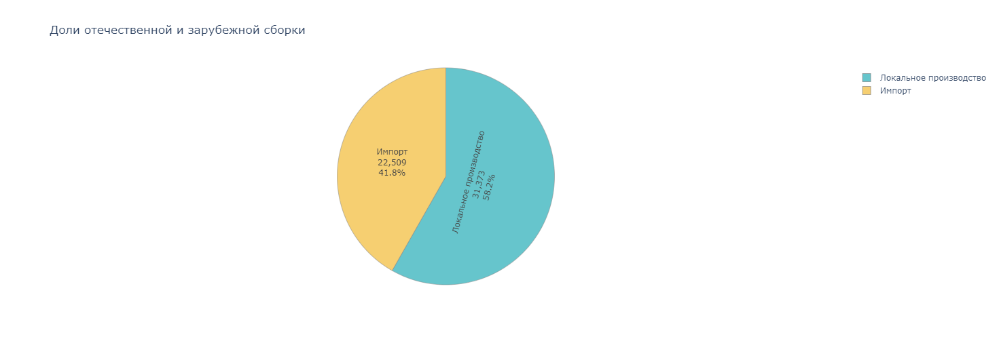

In [88]:
# круговая диаграмма
px.pie(production[['assembly_type', 'is_abroad_cars_cnt']].drop_duplicates(),
       names='assembly_type',
       values='is_abroad_cars_cnt',
       color_discrete_sequence=px.colors.qualitative.Pastel,
       height=500,
       title='Доли отечественной и зарубежной сборки')\
  .update_traces(textinfo='percent+label+value',
                 marker_line_color='#808080',
                 marker_line_width=0.5)\
  .show()

<span style="font-weight: 600;">$31$ $373$ автомобиля $(31.373\%)$ собраны локально, в Казахстане.\
$22$ $509$ машин $(41.8\%)$ собраны за границей.</span>

<br>

In [89]:
# кол-во стран-производителей
exct('''SELECT COUNT(DISTINCT manufacturing_country) AS unique_countries
        FROM k.df''')

,unique_countries
0,19


<span style="font-weight: 600;">Всего имеем $19$ стран-производителей.</span>

<br>

Посмотрим распределение зарубежной сборки ($18$ стран).

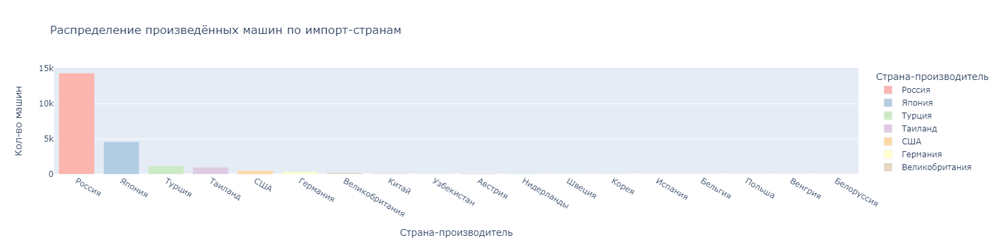

In [90]:
# столбчатая диаграмма
px.bar(production[['manufacturing_country', 'country_cars_cnt']].query("manufacturing_country != ('Казахстан')").drop_duplicates(),
       x='manufacturing_country',
       y='country_cars_cnt',
       color='manufacturing_country',
       labels={'manufacturing_country': 'Страна-производитель',
               'country_cars_cnt': 'Кол-во машин'},
       title='Распределение произведённых машин по импорт-странам',
       color_discrete_sequence=px.colors.qualitative.Pastel1)\
  .show()

<br>

Построим круговую диаграмму с кол-вом произведённых машин из топ-$7$ стран, а также из всех оставшихся стран.

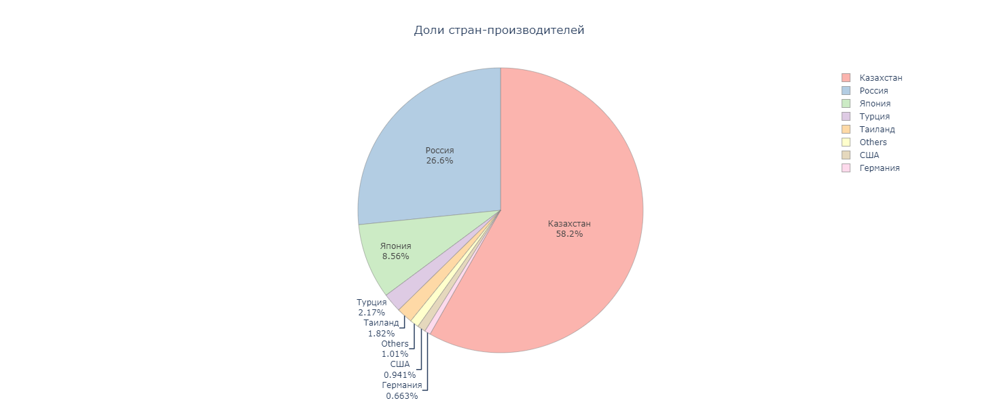

In [91]:
# 7 наиболее часто встречающихся стран
top_countries = production[['manufacturing_country', 'country_cars_cnt']].drop_duplicates().nlargest(7, 'country_cars_cnt')

# кол-во машин не из топ-7 стран
others = production[['manufacturing_country', 'country_cars_cnt']].drop_duplicates()['country_cars_cnt'].sum() - top_countries['country_cars_cnt'].sum()

# другие страны и их машины
others_df = pd.DataFrame({'manufacturing_country': 'Others',
                          'country_cars_cnt': [others]})
    
# объединение топ-7 и других
pie_pt = pd.concat([top_countries, others_df]).reset_index(drop=True)

# круговая диаграмма
px.pie(pie_pt,
       names='manufacturing_country',
       values='country_cars_cnt',
       height=600,
       width=1000,
       color_discrete_sequence=px.colors.qualitative.Pastel1,
       title='Доли стран-производителей')\
  .update_traces(marker_line_color='#808080',
                 marker_line_width=0.5,
                 textinfo='percent+label')\
  .update_layout(title_x=0.5)\
  .show()

Львиная доля всех машин собрана в Казахстане и России $(84.8\%)$.

<br>

<span style="font-weight: 600;">Итак, всего имеем $19$ стран-производителей.</span>

<span style="font-weight: 600;">$31$ $373$ автомобиля $(31.373\%)$ собраны локально, в Казахстане.\
$22$ $509$ машин $(41.8\%)$ собраны за границей.</span>

<span style="font-weight: 600;">Доли произведённых машин по странам:</span>
1. Казахстан — $31$ $373$ $(58.2\%)$
2. Казахстан — $14$ $341$ $(26.6\%)$
3. Япония — $4$ $612$ $(8.56\%)$
4. Турция — $1$ $167$ $(2.17\%)$
5. Таиланд — $981$ $(1.82\%)$
6. Другие — $544$ $(1.01\%)$
7. США — $507$ $(0.941\%)$
8. Германия — $357$ $(0.663\%)$

<br>

#### Тип топлива

In [92]:
# сводная таблица
exct('''WITH
        fuel AS (SELECT fuel_type,
                        SUM(quantity) AS cars
                 FROM k.df
                 GROUP BY 1
                 ORDER BY 2 DESC)
        SELECT *,
               ROUND(cars / SUM(cars) OVER () * 100, 2) AS perc
        FROM fuel''')

,fuel_type,cars,perc
0,Бензин,51016,94.68
1,Дизель,2842,5.27
2,Электричество,14,0.03
3,Гибрид,10,0.02


<span style="font-weight: 600;">Источники энергии автомобилей:</span>
1. Бензин — $5$1 $016$ авто $(94.68\%)$
2. Дизель — $2$ $842$ авто $(5.27\%)$
3. Электричество — $14$ авто $(0.03\%)$
4. Гибрид — $10$ авто $(0.02\%)$

<br>

#### Тип трансмиссии

In [93]:
# сводная таблица
exct('''WITH
        transmiss AS (SELECT transmission_type,
                             SUM(quantity) AS cars
                      FROM k.df
                      GROUP BY 1
                      ORDER BY 2 DESC)
        SELECT *,
               ROUND(cars / SUM(cars) OVER () * 100, 2) AS perc
        FROM transmiss''')

,transmission_type,cars,perc
0,AT,27051,50.20
1,MT,17261,32.03
2,CVT,4222,7.84
3,,3927,7.29
4,AMT,1407,2.61
5,Редуктор,14,0.03


Пробел означает пропущенное значение.

<span style="font-weight: 600;">Типы трансмиссий автомобилей:</span>
1. AT (автомат) — $27$ $051$ авто $(50.20\%)$
2. MT (механика) — $17$ $261$ авто $(32.03\%)$
3. CVT (вариатор) — $4$ $222$ авто $(7.84\%)$
4. Трансмиссия не указана — $3$ $927$ авто $(7.29\%)$
5. AMT (робот) — $1$ $407$ авто $(2.61\%)$
6. Редуктор — $14$ авто $(0.03\%)$

<br>

#### Тип привода

In [94]:
# сводная таблица
exct('''WITH
        drive AS (SELECT drive_type,
                         SUM(quantity) AS cars
                  FROM k.df
                  GROUP BY 1
                  ORDER BY 2 DESC)
        SELECT *,
               ROUND(cars / SUM(cars) OVER () * 100, 2) AS perc
        FROM drive''')

,drive_type,cars,perc
0,FWD,30283,56.20
1,4WD,17550,32.57
2,RWD,3813,7.08
3,,1179,2.19
4,AWD,1057,1.96


Пробел означает пропущенное значение.

<span style="font-weight: 600;">Типы приводов автомобилей:</span>
1. FWD (передний привод) — $30$ $283$ авто $(56.20\%)$
2. 4WD (полный привод) — $17$ $550$ авто $(32.57\%)$
3. RWD (задний привод) — $3$ $813$ авто $(7.08\%)$
4. Тип привода не указан — $1$ $179$ авто $(2.19\%)$
5. AWD (полный привод по необходимости) — $1$ $179$ авто $(1.96\%)$

<br>

<br>

#### Промежуточный вывод

<br>

<span style="font-weight: 600;">Итак, всего имеем $19$ стран-производителей.</span>

<span style="font-weight: 600;">$31$ $373$ автомобиля $(31.373\%)$ собраны локально, в Казахстане.\
$22$ $509$ машин $(41.8\%)$ собраны за границей.</span>

<span style="font-weight: 600;">Доли произведённых машин по странам:</span>
1. Казахстан — $31$ $373$ $(58.2\%)$
2. Казахстан — $14$ $341$ $(26.6\%)$
3. Япония — $4$ $612$ $(8.56\%)$
4. Турция — $1$ $167$ $(2.17\%)$
5. Таиланд — $981$ $(1.82\%)$
6. Другие — $544$ $(1.01\%)$
7. США — $507$ $(0.941\%)$
8. Германия — $357$ $(0.663\%)$

<br>

<span style="font-weight: 600;">Источники энергии автомобилей:</span>
1. Бензин — $5$1 $016$ авто $(94.68\%)$
2. Дизель — $2$ $842$ авто $(5.27\%)$
3. Электричество — $14$ авто $(0.03\%)$
4. Гибрид — $10$ авто $(0.02\%)$

<br>

<span style="font-weight: 600;">Типы трансмиссий автомобилей:</span>
1. AT (автомат) — $27$ $051$ авто $(50.20\%)$
2. MT (механика) — $17$ $261$ авто $(32.03\%)$
3. CVT (вариатор) — $4$ $222$ авто $(7.84\%)$
4. Трансмиссия не указана — $3$ $927$ авто $(7.29\%)$
5. AMT (робот) — $1$ $407$ авто $(2.61\%)$
6. Редуктор — $14$ авто $(0.03\%)$

<br>

<span style="font-weight: 600;">Типы приводов автомобилей:</span>
1. FWD (передний привод) — $30$ $283$ авто $(56.20\%)$
2. 4WD (полный привод) — $17$ $550$ авто $(32.57\%)$
3. RWD (задний привод) — $3$ $813$ авто $(7.08\%)$
4. Тип привода не указан — $1$ $179$ авто $(2.19\%)$
5. AWD (полный привод по необходимости) — $1$ $179$ авто $(1.96\%)$

<br>

<br>

### Компании и дилерские центры, города и регионы

#### Направление компаний

Узнаем активность компаний и их дилерских центров.

In [95]:
exct('''SELECT COUNT(DISTINCT company) AS companies
        FROM k.df''')

,companies
0,32


В Казахстане $32$ компании, которые занимаются продажей автомобилей.

<br>

In [96]:
# сводная таблица
exct('''SELECT company AS commer_cars_companies,
               COUNT(company) OVER () AS cnt
        FROM (SELECT DISTINCT company
        FROM k.df
        WHERE car_type = 'Коммерческие автомобили'
        EXCEPT
        SELECT DISTINCT company
        FROM k.df
        WHERE car_type <> 'Коммерческие автомобили') AS t
        LIMIT 5''')

,commer_cars_companies,cnt
0,СемАЗ,7
1,Scania Central Asia,7
2,ТК КАМАЗ,7
3,Hyundai Com Trans Kazakhstan,7
4,Hino Motors,7


$7$ из них занимаются дистрибуцией исключительно коммерческих автомобилей:
* СемАЗ
* Scania Central Asia
* ТК КАМАЗ
* Hyundai Com Trans Kazakhstan
* Hino Motors
* MAN Truck & Bus Kazakhstan
* Daewoo Bus Kazakhstan

<br>

In [97]:
# сводная таблица
exct('''SELECT company AS common_cars_companies,
               COUNT(company) OVER () AS cnt
        FROM (SELECT DISTINCT company
              FROM k.df
              WHERE car_type <> 'Коммерческие автомобили'
              EXCEPT
              SELECT DISTINCT company
              FROM k.df
              WHERE car_type = 'Коммерческие автомобили') AS t
        LIMIT 5''')

,common_cars_companies,cnt
0,Almaty Motors Premium,17
1,Nissan Manufacturing RUS,17
2,Toyota Motor Kazakhstan,17
3,Автомир-Центр,17
4,Автодом Motors KST,17


$17$ из них занимаются распространением только легковых авто и внедорожников:

* Almaty Motors Premium
* Nissan Manufacturing RUS
* Toyota Motor Kazakhstan
* Автомир-Центр
* Автодом Motors KST
* Scandinavian Motors
* Автоцентр-Бавария
* ММС Рус
* Eurasia Motor Premium
* Astana Motors
* Ravon Motors Kazakstan
* TERRA MOTORS
* Лифан Моторс Рус
* УзАвто-Казахстан
* Caspian Motors
* Eurasia Motor Zhaik
* Subaru Kazakhstan

<br>

In [98]:
# сводная таблица
exct('''SELECT company AS any_cars_companies,
               COUNT(company) OVER () AS cnt
        FROM (SELECT DISTINCT company
              FROM k.df
              WHERE car_type <> 'Коммерческие автомобили'
              INTERSECT
              SELECT DISTINCT company
              FROM k.df
              WHERE car_type = 'Коммерческие автомобили') AS t
        LIMIT 5''')

,any_cars_companies,cnt
0,Volkswagen Group Rus,8
1,Autokapital,8
2,Renault Россия,8
3,Вираж,8
4,БИПЭК АВТО,8


И только $8$ из них занимаются как коммерческим, так и некоммерческим видом транспорта:
* Volkswagen Group Rus
* Autokapital
* Renault Россия
* Вираж
* БИПЭК АВТО
* СВС-ТРАНС
* Allur Auto
* Mercur Auto

<br>

#### Лучшие компании

##### По выручке и объёму продаж

Посмотрим распределение транспортных средств по компаниям, а также их выручку.

In [99]:
# сводная таблица
comp_cars = exct('''SELECT *,
                           SUM(cars) OVER (PARTITION BY company) AS company_sales,
                           SUM(revenue) OVER (PARTITION BY company) AS company_revenue
                    FROM (SELECT company,
                                 car_type,
                                 SUM(quantity) AS cars,
                                 SUM(sale_usd) AS revenue
                          FROM k.df
                          GROUP BY 1, 2
                          ORDER BY company, car_type) AS t
                    ORDER BY company_sales DESC''')
comp_cars.head()

,company,car_type,cars,revenue,company_sales,company_revenue
0,БИПЭК АВТО,Легковые автомобили,10870,125521338,15139.0,186159938.0
1,БИПЭК АВТО,Внедорожники,3737,53598700,15139.0,186159938.0
2,БИПЭК АВТО,Коммерческие автомобили,532,7039900,15139.0,186159938.0
3,Toyota Motor Kazakhstan,Легковые автомобили,6133,198456906,11951.0,479876198.0
4,Toyota Motor Kazakhstan,Внедорожники,5818,281419292,11951.0,479876198.0


<br>

Построим столбчатые диаграммы.

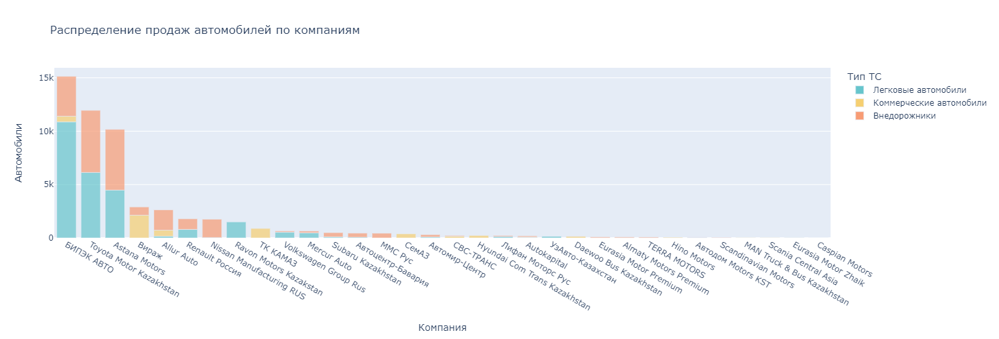

In [100]:
# столбчатая диаграмма по продажам ТС

comp_cars = comp_cars.sort_values(by='company_sales', ascending=False)

px.bar(comp_cars,
       x='company',
       y='cars',
       color='car_type',
       category_orders={'company': comp_cars['company']},
       labels={'company': 'Компания',
               'cars': 'Автомобили',
               'car_type': 'Тип ТС'},
       height=500,
       title='Распределение продаж автомобилей по компаниям',
       color_discrete_sequence=px.colors.qualitative.Pastel,
       opacity=0.7)\
  .show()

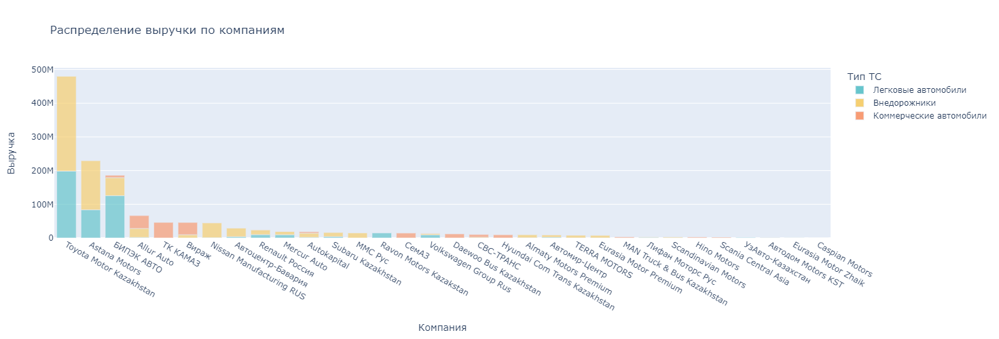

In [101]:
# столбчатая диаграмма по выручке 

comp_cars = comp_cars.sort_values(by='company_revenue', ascending=False)

px.bar(comp_cars,
       x='company',
       y='revenue',
       color='car_type',
       category_orders={'company': comp_cars['company']},
       labels={'company': 'Компания',
               'revenue': 'Выручка',
               'car_type': 'Тип ТС'},
       height=500,
       title='Распределение выручки по компаниям',
       color_discrete_sequence=px.colors.qualitative.Pastel,
       opacity=0.7)\
  .show()

<br>

Построим круговые диаграммы, предварительно сначала поделив на самые продающие и доходные компании.

In [102]:
# самые продающие компании
top_9_comp = comp_cars[['company', 'company_sales']].drop_duplicates().nlargest(9, 'company_sales')

other_comp_sales = comp_cars[['company', 'company_sales']]['company_sales'].drop_duplicates().sum() - top_9_comp['company_sales'].sum()

other_comp_str = pd.DataFrame({'company': 'Others',
                               'company_sales': [other_comp_sales]})

pie_comp_sales = pd.concat([top_9_comp, other_comp_str])

# самые доходные компании
top_9_comp = comp_cars[['company', 'company_revenue']].drop_duplicates().nlargest(9, 'company_revenue')

other_comp_revenue = comp_cars[['company', 'company_revenue']]['company_revenue'].drop_duplicates().sum() - top_9_comp['company_revenue'].sum()

other_comp_str = pd.DataFrame({'company': 'Others',
                               'company_revenue': [other_comp_revenue]})

pie_comp_rev = pd.concat([top_9_comp, other_comp_str])

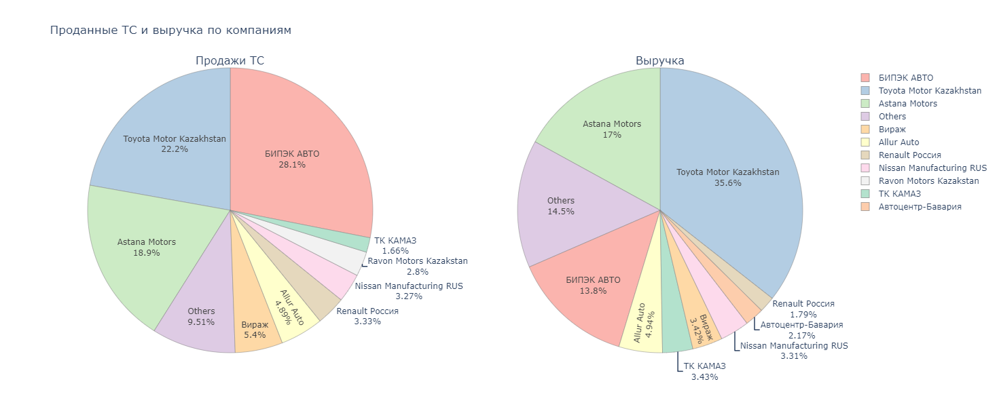

In [103]:
# круговые диаграммы
fig = make_subplots(rows=1, cols=2, 
                    specs=[[{'type':'domain'}, {'type':'domain'}]],
                    subplot_titles=['Продажи ТС', 'Выручка'])
    
fig.add_trace(go.Pie(labels=pie_comp_sales['company'],
                     values=pie_comp_sales['company_sales'],
                     marker_line_color='#808080',
                     marker_line_width=0.5,
                     name='Продажи ТС',
                     textinfo='percent+label'), 1, 1)
    
fig.add_trace(go.Pie(labels=pie_comp_rev['company'],
                     values=pie_comp_rev['company_revenue'],
                     marker_line_color='#808080',
                     marker_line_width=0.5,
                     name='Выручка',
                     textinfo='percent+label'), 1, 2)

fig.update_layout(title_text='Проданные ТС и выручка по компаниям',
                  height=600,
                  colorway=px.colors.qualitative.Pastel1 + px.colors.qualitative.Pastel2)
    

fig.show()

<br>

| $10$ самых продающих компаний:                          | $10$ самых доходных компаний: |
|---------------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО — $15$ $139$ авто $(28.1\%)$              | 1. Toyota Motor Kazakhstan — $479$ $876$ $198$ $\$$ $(35.6\%)$ |
| 2. Toyota Motor Kazakhstan — $11$ $951$ авто $(22.2\%)$ | 2. Astana Motors — $229$ $338$ $396$ $\$$ $(17\%)$ |
| 3. Astana Motors — $10$ $169$ авто $(18.9\%)$           | 3. Остальные — $195$ $414$ $762$ $\$$ $(14.5\%)$ |
| 4. Остальные — $5$ $122$ авто $(9.51\%)$                | 4. БИПЭК АВТО — $186$ $159$ $938$ $\$$ $(13.8\%)$ |
| 5. Вираж — $2$ $909$ авто $(5.4\%)$                     | 5. Allur Auto — $66$ $512$ $384$ $\$$ $(4.94\%)$ |
| 6. Allur Auto — $2$ $636$ авто $(4.89\%)$               | 6. ТК КАМАЗ — $46$ $215$ $916$ $\$$ $(3.43\%)$ |
| 7. Renault Россия — $1$ $796$ авто $(3.33\%)$           | 7. ВИРАЖ — $46$ $124$ $684$ $\$$ $(3.42\%)$ |
| 8. Nissan Manufacturing RUS — $1$ $760$ авто $(3.27\%)$ | 8. Nissan Manufacturing RUS — $44$ $633$ $622$ $\$$ $(3.31\%)$ |
| 9. Ravon Motors Kazakhstan — $1$ $507$ авто $(2.8\%)$   | 9. Автоцентр-Бавария — $29$ $219$ $724$ $\$$ $(2.17\%)$ |
| 10. ТК КАМАЗ — $893$ авто $(1.66\%)$                    | 10. Renault Россия — $24$ $184$ $905$ $\$$ $(1.79\%)$ |

<br>

<br>

У каждой компании есть свои дилерские центры.

In [104]:
exct('''SELECT COUNT(DISTINCT dealer_center_name) AS dealer_centers
        FROM k.df''')

,dealer_centers
0,204


У $32$ компаний есть $204$ дилерских центра, в которых продаются автомобили.

<br>

##### По эффективности

<span style="font-weight: 600;">Выведем:</span>
1. Кол-во центров у компании
2. Кол-во проданных машин
3. Выручку с проданных машин

<span style="font-weight: 600;">А также оценим, насколько эффективны компании в своей деятельности, выведя:</span>
1. Среднее кол-во проданных машин на центр
2. Среднюю выручку с проданных машин на центр

In [105]:
# сводная таблица
comp_centers = exct('''SELECT *,
                              cars_sold / centers AS avg_cars,
                              revenue / centers AS avg_revenue
                       FROM (SELECT company,
                                    COUNT(DISTINCT dealer_center_name) AS centers,
                                    SUM(quantity) AS cars_sold,
                                    SUM(sale_usd) AS revenue
                             FROM k.df
                             GROUP BY 1
                             ORDER BY 2 DESC) AS t
                       ORDER BY centers DESC''')
comp_centers

,company,centers,cars_sold,revenue,avg_cars,avg_revenue
0,Ravon Motors Kazakstan,36,1507,14938185,41,414949
1,Allur Auto,35,2636,66512384,75,1900353
2,Astana Motors,24,10169,229338396,423,9555766
3,Toyota Motor Kazakhstan,23,11951,479876198,519,20864182
4,СемАЗ,21,389,14609879,18,695708
5,БИПЭК АВТО,20,15139,186159938,756,9307996
6,УзАвто-Казахстан,18,152,1531552,8,85086
7,Вираж,18,2909,46124684,161,2562482
8,Subaru Kazakhstan,17,503,16158348,29,950491
9,Nissan Manufacturing RUS,16,1760,44633622,110,2789601


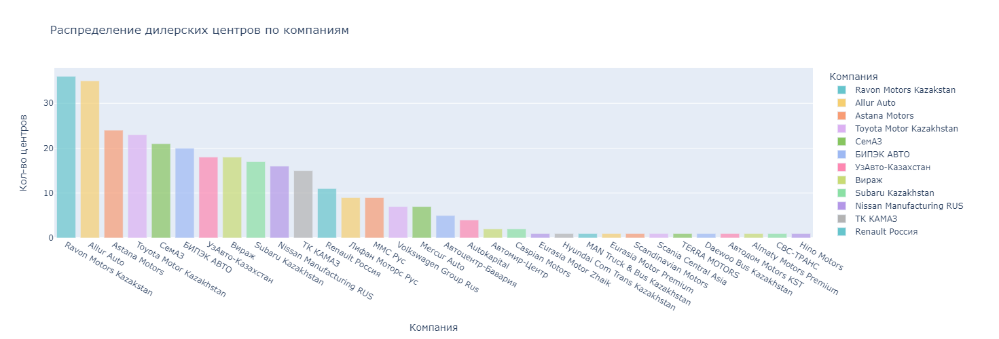

In [106]:
# столбчатая диаграмма по кол-ву центров на компанию
px.bar(comp_centers,
       x='company',
       y='centers',
       color='company',
       title='Распределение дилерских центров по компаниям',
       labels={'company':'Компания',
               'centers':'Кол-во центров'},
       height=500,
       opacity=0.7,
       color_discrete_sequence=px.colors.qualitative.Pastel)\
  .show()

<br>

Посмотрим, какие доли занимают компании с самым большим кол-вом центров.

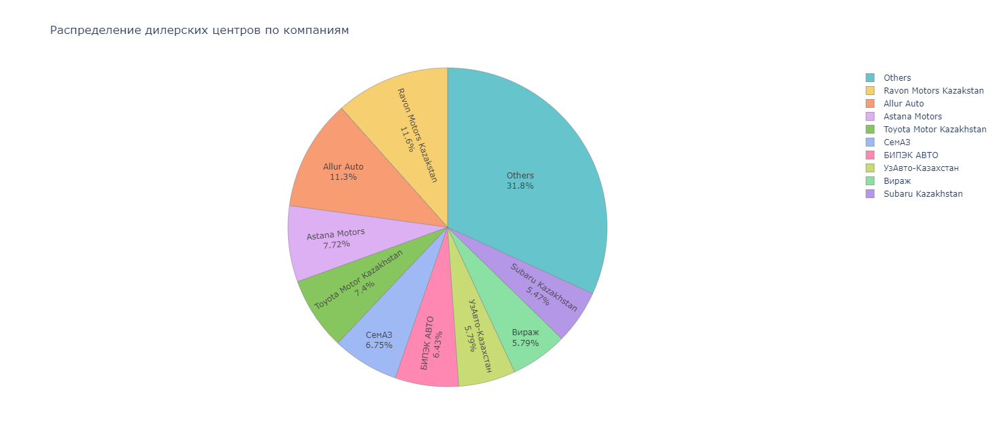

In [107]:
# компании с самым большим кол-вом центров
top_9_comp = comp_centers[['company', 'centers']].nlargest(9, 'centers')

other_comp_centers = comp_centers[['company', 'centers']]['centers'].sum() - top_9_comp['centers'].sum()

other_comp_str = pd.DataFrame({'company': 'Others',
                               'centers': [other_comp_centers]})

pie_comp_cent = pd.concat([top_9_comp, other_comp_str])

# круговая диаграмма
px.pie(pie_comp_cent,
       names='company',
       values='centers',
       height=650,
       title='Распределение дилерских центров по компаниям',
       color_discrete_sequence=px.colors.qualitative.Pastel)\
  .update_traces(textinfo='percent+label',
                 marker_line_color='#808080',
                 marker_line_width=0.5)\
  .show()

| $10$ компаний с наибольшим кол-вом центров              |
|---------------------------------------------------------|
| 1. Другие — $99$ центров $(31.8\%)$              |
| 2. Ravon Motors Kazakhstan — $36$ центров $(11.6\%)$ |
| 3. Allur Auto — $35$ центров $(11.3\%)$           |
| 4. Astana Motors — $24$ центров $(7.72\%)$                |
| 5. Toyota Motor Kazakhstan — $23$ центров $(7.4\%)$                     |
| 6. СемАЗ — $21$ центров $(6.75\%)$               |
| 7. БИПЭК АВТО — $20$ центров $(6.43\%)$           |
| 8. УзАвто-Казахстан — $18$ центров $(5.79\%)$ |
| 9. Вираж — $18$ центров $(5.79\%)$   |
| 10. Subaru Kazakhstan — $17$ центров $(5.47\%)$                    |

<br>

Посмотрим, насколько хороши дела у компаний в целом.\
Для этого отобразим компании по кол-ву проданных авто на центр, а также компании по выручке на центр.

In [108]:
# HTML разметка 
html = "<div style='display:flex; flex-direction:column;'>"

# таблицы
html += "<div style='text-align:center;'>"
html += "<div style='display:inline-block; margin-right:30px;'><h7>Компании по кол-ву проданных авто на центр</h7>{}</div>".format(comp_centers.sort_values(by='avg_cars', ascending=False).reset_index(drop=True).to_html())
html += "<div style='display:inline-block; margin-left:30px;'><h7>Компании по выручке на центр</h7>{}</div>".format(comp_centers.sort_values(by='avg_revenue', ascending=False).reset_index(drop=True).to_html())
html += "</div>"
html += "<br>"

html += "</div>"

# отображение HTML
HTML(html)

,company,centers,cars_sold,revenue,avg_cars,avg_revenue
0,БИПЭК АВТО,20,15139,186159938,756,9307996
1,Toyota Motor Kazakhstan,23,11951,479876198,519,20864182
2,Astana Motors,24,10169,229338396,423,9555766
3,СВС-ТРАНС,1,240,10313413,240,10313413
4,Hyundai Com Trans Kazakhstan,1,236,9710599,236,9710599
5,Renault Россия,11,1796,24184905,163,2198627
6,Вираж,18,2909,46124684,161,2562482
7,Автомир-Центр,2,313,8877524,156,4438762
8,Daewoo Bus Kazakhstan,1,146,12162702,146,12162702
9,Nissan Manufacturing RUS,16,1760,44633622,110,2789601


Таблицы показывают, что достаточно иметь всего лишь $1$ центр, чтобы быть в числе самых эффективных компаний.\
И напротив, большое количество дилерских центров не означает, что компания приносит дивиденды.

Субъективно, метрика `количество проданных авто на 1 центр` прямопропорционально влияет на положение дел компании, но не так ярко, как метрика `средняя выручка на дилерский центр`.

Так, `Ravon Motors Kazakhstan`, специализирующаяся на узбекских автомобилях эконом класса `Ravon`, имеет $36$ центров, и в среднем за $9$ месяцев они принесли по $414$ $949$ $\$$ выручки.\
А у `Daewoo Bus Kazakhstan`, продающей автобусы, всего $1$ центр, но принёс он $12$ $162$ $702$ $\$$ выручки.

Несмотря на это, у первой компании на $2,7$ млн $\$$ дохода больше. Считаю, что это не показатель превосходства `Ravon` над `Daewoo`.\
Потому что чем больше центров, тем больше персонала, которому нужно платить зарплату, тем больше расходов за аренду, тем больше операционных расходов.

Поэтому, я считаю, что чем лучше метрика `средняя выручка на дилерский центр`, тем больше компания получает прибыли.

<br>

| Топ-$10$ компаний по проданным авто на 1 центр      | Топ-$10$ компаний по выручке на 1 центр |
|-----------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО — $756$ ($20$ центров)                | 1. Toyota Motor Kazakhstan — $20$ $864$ $182$ $\$$ ($23$ центра)  |
| 2. Toyota Motor Kazakhstan — $519$ ($23$ центра)    | 2. Daewoo Bus Kazakhstan — $12$ $162$ $702$ $\$$ ($1$ центр) |
| 3. Astana Motors — $423$ ($24$ центра)              | 3. СВС-ТРАНС — $10$ $313$ $413$ $\$$ ($1$ центр) |
| 4. СВС-ТРАНС — $240$ ($1$ центр)                    | 4. Hyundai Com Trans Kazakhstan — $9$ $710$ $599$ $\$$ ($1$ центр) |
| 5. Hyundai Com Trans Kazakhstan — $236$ ($1$ центр) | 5. Almaty Motors Premium — $9$ $657$ $734$ $\$$ ($1$ центр)  |
| 6. Renault Россия — $163$ ($11$ центров)            | 6. Astana Motors — $9$ $555$ $766$ $\$$ ($24$ центра)  |
| 7. Вираж — $161$ ($18$ центров)                     | 7. БИПЭК АВТО — $9$ $307$ $996$ $\$$ ($20$ центров)  |
| 8. Автомир-Центр — $156$ ($2$ центра)               | 8. TERRA MOTORS — $7$ $978$ $602$ $\$$ ($1$ центр)  |
| 9. Daewoo Bus Kazakhstan — $146$ ($1$ центр)        | 9. Eurasia Motor Premium — $7$ $724$ $919$ $\$$ ($1$ центр)  |
| 10. Nissan Manufacturing RUS — $110$ ($16$ центров) | 10. Автоцентр-Бавария — $5$ $843$ $944$ $\$$ ($5$ центров)  |

<br>

#### Лучшие дилерские центры

##### По выручке и объёму продаж

Посмотрим топ-10 дилерских центров по продажам и топ-10 по выручке.

Сначала построим сводную таблицу.

In [109]:
# сводная таблица
centers = exct('''WITH
                  centers AS (SELECT company,
                                     dealer_center_name,
                                     SUM(quantity) AS cars_saled,
                                     SUM(sale_usd) AS revenue,
                                     ROUND(SUM(quantity) / SUM(SUM(quantity)) OVER (PARTITION BY company) * 100, 2) AS cars_saled_perc,
                                     ROUND(SUM(sale_usd) / SUM(SUM(sale_usd)) OVER (PARTITION BY company) * 100, 2) AS revenue_perc,
                                     ROUND(SUM(quantity) / SUM(SUM(quantity)) OVER () * 100, 2) AS all_the_cars_perc,
                                     ROUND(SUM(sale_usd) / SUM(SUM(sale_usd)) OVER () * 100, 2) AS all_the_revenue_perc,                                       
                                     SUM(SUM(quantity)) OVER (PARTITION BY company) AS company_cars,
                                     SUM(SUM(sale_usd)) OVER (PARTITION BY company) AS company_revenue,
                                     ROUND(SUM(SUM(quantity)) OVER (PARTITION BY company) / SUM(SUM(quantity)) OVER () * 100, 2) AS company_cars_perc,
                                     ROUND(SUM(SUM(sale_usd)) OVER (PARTITION BY company) / SUM(SUM(sale_usd)) OVER () * 100, 2) AS company_revenue_perc,
                                     SUM(SUM(quantity)) OVER () AS all_the_cars,
                                     SUM(SUM(sale_usd)) OVER () AS all_the_revenue
                              FROM k.df
                              GROUP BY 1, 2
                              ORDER BY 3 DESC)
                  SELECT *
                  FROM centers ''')
centers.head()

,company,dealer_center_name,cars_saled,revenue,cars_saled_perc,revenue_perc,all_the_cars_perc,all_the_revenue_perc,company_cars,company_revenue,company_cars_perc,company_revenue_perc,all_the_cars,all_the_revenue
0,БИПЭК АВТО,БИПЭК АВТО Алматы,2271,31097511,15.00,16.70,4.21,2.31,15139.0,186159938.0,28.10,13.81,53882.0,1.347681e+09
1,БИПЭК АВТО,БИПЭК АВТО Астана,1882,27034438,12.43,14.52,3.49,2.01,15139.0,186159938.0,28.10,13.81,53882.0,1.347681e+09
2,Astana Motors,Hyundai Premium Almaty,1600,36086782,15.73,15.74,2.97,2.68,10169.0,229338396.0,18.87,17.02,53882.0,1.347681e+09
3,Astana Motors,Hyundai Premium Astana,1385,31017929,13.62,13.52,2.57,2.30,10169.0,229338396.0,18.87,17.02,53882.0,1.347681e+09
4,БИПЭК АВТО,БИПЭК АВТО Атырау,1358,15897404,8.97,8.54,2.52,1.18,15139.0,186159938.0,28.10,13.81,53882.0,1.347681e+09


<br>

Посмотрим, что покажет столбчатая диаграмма: сделаем срез, чтобы центр продал не меньше $100$ автомобилей.

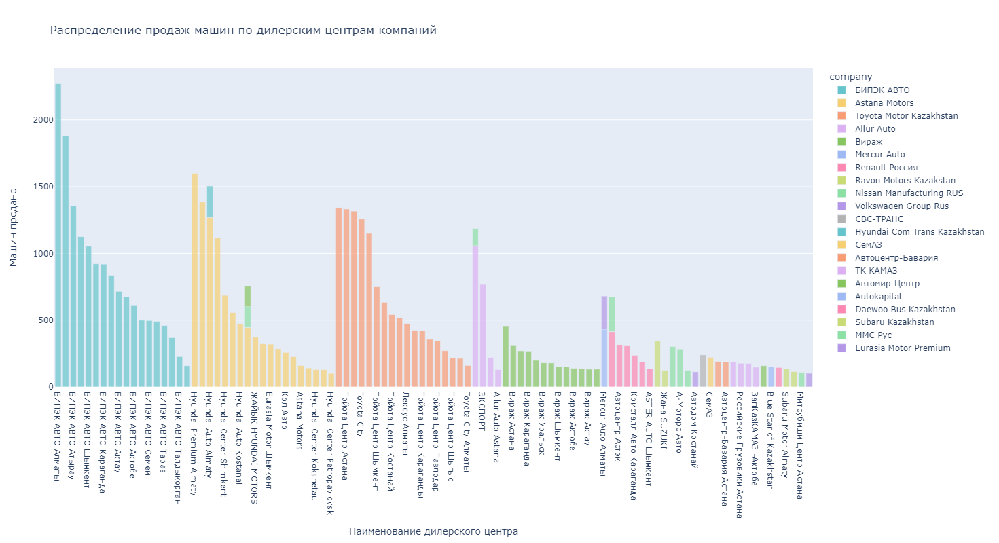

In [110]:
# столбчатая диаграмма
px.bar(centers.query('cars_saled >= 100 '),
       x='dealer_center_name',
       y='cars_saled',
       color='company',
       height=800,
       opacity=0.7,
       labels={'dealer_center_name': 'Наименование дилерского центра',
               'cars_saled': 'Машин продано'},
       title='Распределение продаж машин по дилерским центрам компаний',
       color_discrete_sequence=px.colors.qualitative.Pastel)\
  .show()

Цвета чётко выделяют компании и их центры.\
Забавно, некоторые центры принадлежат сразу нескольким компаниям, это видно по их пёстрости.\
С чем это связано, непонятно.

<br>

Узнаем $10$ самых продающих дилерских центров.

In [111]:
centers.nlargest(10, 'cars_saled')

,company,dealer_center_name,cars_saled,revenue,cars_saled_perc,revenue_perc,all_the_cars_perc,all_the_revenue_perc,company_cars,company_revenue,company_cars_perc,company_revenue_perc,all_the_cars,all_the_revenue
0,БИПЭК АВТО,БИПЭК АВТО Алматы,2271,31097511,15.00,16.70,4.21,2.31,15139.0,186159938.0,28.10,13.81,53882.0,1.347681e+09
1,БИПЭК АВТО,БИПЭК АВТО Астана,1882,27034438,12.43,14.52,3.49,2.01,15139.0,186159938.0,28.10,13.81,53882.0,1.347681e+09
2,Astana Motors,Hyundai Premium Almaty,1600,36086782,15.73,15.74,2.97,2.68,10169.0,229338396.0,18.87,17.02,53882.0,1.347681e+09
3,Astana Motors,Hyundai Premium Astana,1385,31017929,13.62,13.52,2.57,2.30,10169.0,229338396.0,18.87,17.02,53882.0,1.347681e+09
4,БИПЭК АВТО,БИПЭК АВТО Атырау,1358,15897404,8.97,8.54,2.52,1.18,15139.0,186159938.0,28.10,13.81,53882.0,1.347681e+09
5,Toyota Motor Kazakhstan,Тойота Центр Алматы,1343,50407449,11.24,10.50,2.49,3.74,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
6,Toyota Motor Kazakhstan,Тойота Центр Астана,1333,48323597,11.15,10.07,2.47,3.59,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
7,Toyota Motor Kazakhstan,Toyota City Астана,1317,47043790,11.02,9.80,2.44,3.49,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
8,Astana Motors,Hyundai Auto Almaty,1270,27980328,12.49,12.20,2.36,2.08,10169.0,229338396.0,18.87,17.02,53882.0,1.347681e+09
9,Toyota Motor Kazakhstan,Toyota City,1258,48204747,10.53,10.05,2.33,3.58,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09


<br>

Узнаем $10$ самых доходных дилерских центров.

In [112]:
centers.nlargest(10, 'revenue')

,company,dealer_center_name,cars_saled,revenue,cars_saled_perc,revenue_perc,all_the_cars_perc,all_the_revenue_perc,company_cars,company_revenue,company_cars_perc,company_revenue_perc,all_the_cars,all_the_revenue
5,Toyota Motor Kazakhstan,Тойота Центр Алматы,1343,50407449,11.24,10.50,2.49,3.74,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
6,Toyota Motor Kazakhstan,Тойота Центр Астана,1333,48323597,11.15,10.07,2.47,3.59,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
9,Toyota Motor Kazakhstan,Toyota City,1258,48204747,10.53,10.05,2.33,3.58,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
7,Toyota Motor Kazakhstan,Toyota City Астана,1317,47043790,11.02,9.80,2.44,3.49,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
13,Allur Auto,Allur Auto Almaty,1058,44213917,40.14,66.47,1.96,3.28,2636.0,66512384.0,4.89,4.94,53882.0,1.347681e+09
10,Toyota Motor Kazakhstan,Тойота Центр Жетысу,1150,44037319,9.62,9.18,2.13,3.27,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
2,Astana Motors,Hyundai Premium Almaty,1600,36086782,15.73,15.74,2.97,2.68,10169.0,229338396.0,18.87,17.02,53882.0,1.347681e+09
27,Toyota Motor Kazakhstan,Лексус Астана,519,32283757,4.34,6.73,0.96,2.40,11951.0,479876198.0,22.18,35.61,53882.0,1.347681e+09
0,БИПЭК АВТО,БИПЭК АВТО Алматы,2271,31097511,15.00,16.70,4.21,2.31,15139.0,186159938.0,28.10,13.81,53882.0,1.347681e+09
3,Astana Motors,Hyundai Premium Astana,1385,31017929,13.62,13.52,2.57,2.30,10169.0,229338396.0,18.87,17.02,53882.0,1.347681e+09


<br>

| $10$ самых продающих дилерских центров                          | $10$ самых доходных дилерских центров |
|---------------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО Алматы — $2$ $271$ авто $(4.21\%)$              | 1. Тойота Центр Алматы — $50$ $407$ $449$ $\$$ $(3.74\%)$ |
| 2. БИПЭК АВТО Астана — $1$ $882$ авто $(3.49\%)$ | 2. Тойота Центр Астана — $48$ $323$ $597$ $\$$ $(3.59\%)$ |
| 3. Hyundai Premium Almaty — $1$ $600$ авто $(2.97\%)$           | 3. Toyota City — $48$ $204$ $747$ $\$$ $(3.58\%)$ |
| 4. Hyundai Premium Astana — $1$ $385$ авто $(2.57\%)$                | 4. Toyota City Астана — $47$ $043$ $790$ $\$$ $(3.49\%)$ |
| 5. БИПЭК АВТО Атырау — $1$ $358$ авто $(2.52\%)$                     | 5. Allur Auto Almaty — $44$ $213$ $917$ $\$$ $(3.28\%)$ |
| 6. Тойота Центр Алматы — $1$ $343$ авто $(2.49\%)$               | 6. Тойота Центр Жетысу — $44$ $037$ $319$ $\$$ $(3.27\%)$ |
| 7. Тойота Центр Астана — $1$ $333$ авто $(2.47\%)$           | 7. Hyundai Premium Almaty — $36$ $086$ $782$ $\$$ $(2.68\%)$ |
| 8. Toyota City Астана — $1$ $317$ авто $(2.44\%)$ | 8. Лексус Астана — $32$ $283$ $757$ $\$$ $(2.4\%)$ |
| 9. Hyundai Auto Almaty — $1$ $270$ авто $(2.36\%)$   | 9. БИПЭК АВТО Алматы — $31$ $097$ $511$ $\$$ $(2.31\%)$ |
| 10. Toyota City — $1$ $258$ авто $(2.33\%)$                    | 10. Hyundai Premium Astana — $31$ $017$ $929$ $\$$ $(2.3\%)$ |

Проценты указывают на их долю среди всех дилерских центров.

<br>

#### Лучшие города

##### По выручке и объёму продаж

Посмотрим распределение продаж по регионам и городам.

In [113]:
# сводная таблица
city_sales = exct('''SELECT *,
                            SUM(cars) OVER () AS total_cars,
                            SUM(revenue) OVER () AS total_revenue,
                            ROUND(cars / SUM(cars) OVER () * 100, 2) AS cars_perc,
                            ROUND(revenue / SUM(revenue) OVER () * 100, 2) AS rev_perc
                     FROM (SELECT region,
                                  city,
                                  SUM(quantity) AS cars,
                                  SUM(sale_usd) AS revenue
                           FROM k.df
                           GROUP BY 1, 2
                           ORDER BY 3 DESC) AS t''')
city_sales

,region,city,cars,revenue,total_cars,total_revenue,cars_perc,rev_perc
0,г.Алматы,Алматы,13949,425962749,53882.0,1.347681e+09,25.89,31.61
1,г.Нур-Султан,Нур-Султан,10159,292291966,53882.0,1.347681e+09,18.85,21.69
2,Южно-Казахстанская область,Шымкент,3749,81763974,53882.0,1.347681e+09,6.96,6.07
3,Атырауская область,Атырау,3393,74433881,53882.0,1.347681e+09,6.30,5.52
4,Костанайская область,Костанай,3258,87788687,53882.0,1.347681e+09,6.05,6.51
5,Карагандинская область,Караганда,2984,59927490,53882.0,1.347681e+09,5.54,4.45
6,Западно-Казахстанская область,Уральск,2180,45829869,53882.0,1.347681e+09,4.05,3.40
7,Восточно-Казахстанская область,Усть-Каменогорск,2097,40676974,53882.0,1.347681e+09,3.89,3.02
8,Мангистауская область,Актау,2049,46674557,53882.0,1.347681e+09,3.80,3.46
9,Экспорт область,ЭКСПОРТ,1919,37882111,53882.0,1.347681e+09,3.56,2.81


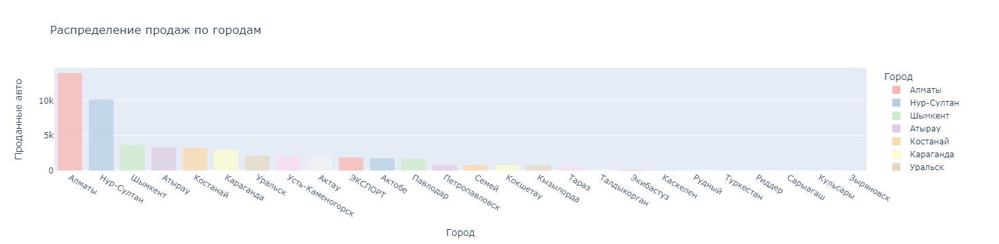

In [114]:
# столбчатая диаграмма
px.bar(city_sales,
       x='city',
       y='cars',
       color='city',
       opacity=0.7,
       labels={'city': 'Город',
               'cars': 'Проданные авто'},
       title='Распределение продаж по городам',
       color_discrete_sequence=px.colors.qualitative.Pastel1)\
  .show()

Алматы и Астана ожидаемо занимают первые места в списке проданных авто, ведь это крупнейшие города Казахстана.\
Город `Экспорт` означает, что автомобиль ушёл за границу.

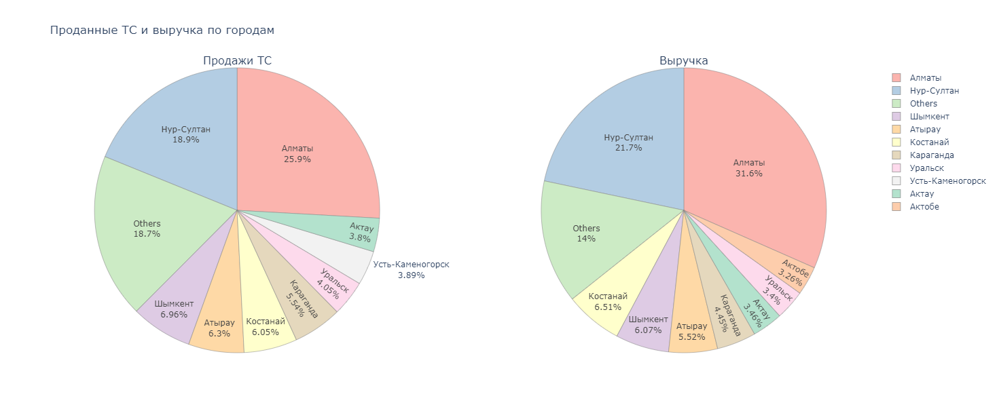

In [115]:
# города с самым большим кол-вом продаж
top_9_cities_s = city_sales[['city', 'cars']].nlargest(9, 'cars')

other_cities_s = city_sales[['city', 'cars']]['cars'].sum() - top_9_cities_s['cars'].sum()

other_cities_str_s = pd.DataFrame({'city': 'Others',
                                   'cars': [other_cities_s]})

pie_city_sales_s = pd.concat([top_9_cities_s, other_cities_str_s])

# города с самой большой выручкой
top_9_cities_r = city_sales[['city', 'revenue']].nlargest(9, 'revenue')

other_cities_r = city_sales[['city', 'revenue']]['revenue'].sum() - top_9_cities_r['revenue'].sum()

other_cities_str_r = pd.DataFrame({'city': 'Others',
                                   'revenue': [other_cities_r]})

pie_city_sales_r = pd.concat([top_9_cities_r, other_cities_str_r])


# круговые диаграммы
fig = make_subplots(rows=1, cols=2, 
                    specs=[[{'type':'domain'}, {'type':'domain'}]],
                    subplot_titles=['Продажи ТС', 'Выручка'])
    
fig.add_trace(go.Pie(labels=pie_city_sales_s['city'],
                     values=pie_city_sales_s['cars'],
                     marker_line_color='#808080',
                     marker_line_width=0.5,
                     name='Продажи ТС',
                     textinfo='percent+label'), 1, 1)
    
fig.add_trace(go.Pie(labels=pie_city_sales_r['city'],
                     values=pie_city_sales_r['revenue'],
                     marker_line_color='#808080',
                     marker_line_width=0.5,
                     name='Выручка',
                     textinfo='percent+label'), 1, 2)

fig.update_layout(title_text='Проданные ТС и выручка по городам',
                  height=600,
                  colorway=px.colors.qualitative.Pastel1 + px.colors.qualitative.Pastel2)
    

fig.show()

| $10$ городов с наибольшим кол-вом проданных авто   || $10$ городов с наибольшей выручкой                      |
|----------------------------------------------------||---------------------------------------------------------|
| 1. Алматы — $13$ $949$ авто $(25.9\%)$             || 1. Алматы — $425$ $962$ $749$ $\$$ $(31.6\%)$           |
| 2. Астана — $10$ $159$ авто $(18.9\%)$             || 2. Астана — $292$ $291$ $966$ $\$$ $(21.7\%)$           |
| 3. Остальные города — $10$ $064$ авто $(18.7\%)$   || 3. Остальные города — $189$ $008$ $798$ $\$$ $(14\%)$ |
| 4. Шымкент — $3$ $749$ авто $(6.96\%)$             || 4. Костанай — $87$ $788$ $687$ $\$$ $(6.51\%)$          |
| 5. Атырау — $3$ $393$ авто $(6.3\%)$               || 5. Шымкент — $81$ $763$ $974$ $\$$ $(6.07\%)$           |
| 6. Костанай — $3$ $258$ авто $(6.05\%)$            || 6. Атырау — $74$ $433$ $881$ $\$$ $(5.52\%)$            |
| 7. Караганда — $2$ $984$ авто $(5.54\%)$           || 7. Караганда — $59$ $927$ $490$ $\$$ $(4.45\%)$         |
| 8. Уральск — $2$ $180$ авто $(4.05\%)$             || 8. Актау — $46$ $674$ $557$ $\$$ $(3.46\%)$             |
| 9. Усть-Каменогорск — $2$ $097$ авто $(3.89\%)$    || 9. Уральск — $45$ $829$ $869$ $\$$ $(3.4\%)$            |
| 10. Актау — $2$ $049$ авто $(3.8\%)$               || 10. Актобе — $43$ $998$ $558$ $\$$ $(3.26\%)$           |

<br>

#### Промежуточный вывод

В Казахстане $32$ компании, которые занимаются продажей автомобилей.

$7$ из них занимаются дистрибуцией исключительно коммерческих автомобилей:
* СемАЗ
* Scania Central Asia
* ТК КАМАЗ
* Hyundai Com Trans Kazakhstan
* Hino Motors
* MAN Truck & Bus Kazakhstan
* Daewoo Bus Kazakhstan

$17$ из них занимаются распространением только легковых авто и внедорожников:

* Almaty Motors Premium
* Nissan Manufacturing RUS
* Toyota Motor Kazakhstan
* Автомир-Центр
* Автодом Motors KST
* Scandinavian Motors
* Автоцентр-Бавария
* ММС Рус
* Eurasia Motor Premium
* Astana Motors
* Ravon Motors Kazakstan
* TERRA MOTORS
* Лифан Моторс Рус
* УзАвто-Казахстан
* Caspian Motors
* Eurasia Motor Zhaik
* Subaru Kazakhstan

И только $8$ из них занимаются как коммерческим, так и некоммерческим видом транспорта:
* Volkswagen Group Rus
* Autokapital
* Renault Россия
* Вираж
* БИПЭК АВТО
* СВС-ТРАНС
* Allur Auto
* Mercur Auto

<br>

| $10$ самых продающих компаний:                          | $10$ самых доходных компаний: |
|---------------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО — $15$ $139$ авто $(28.1\%)$              | 1. Toyota Motor Kazakhstan — $479$ $876$ $198$ $\$$ $(35.6\%)$ |
| 2. Toyota Motor Kazakhstan — $11$ $951$ авто $(22.2\%)$ | 2. Astana Motors — $229$ $338$ $396$ $\$$ $(17\%)$ |
| 3. Astana Motors — $10$ $169$ авто $(18.9\%)$           | 3. Остальные — $195$ $414$ $762$ $\$$ $(14.5\%)$ |
| 4. Остальные — $5$ $122$ авто $(9.51\%)$                | 4. БИПЭК АВТО — $186$ $159$ $938$ $\$$ $(13.8\%)$ |
| 5. Вираж — $2$ $909$ авто $(5.4\%)$                     | 5. Allur Auto — $66$ $512$ $384$ $\$$ $(4.94\%)$ |
| 6. Allur Auto — $2$ $636$ авто $(4.89\%)$               | 6. ТК КАМАЗ — $46$ $215$ $916$ $\$$ $(3.43\%)$ |
| 7. Renault Россия — $1$ $796$ авто $(3.33\%)$           | 7. ВИРАЖ — $46$ $124$ $684$ $\$$ $(3.42\%)$ |
| 8. Nissan Manufacturing RUS — $1$ $760$ авто $(3.27\%)$ | 8. Nissan Manufacturing RUS — $44$ $633$ $622$ $\$$ $(3.31\%)$ |
| 9. Ravon Motors Kazakhstan — $1$ $507$ авто $(2.8\%)$   | 9. Автоцентр-Бавария — $29$ $219$ $724$ $\$$ $(2.17\%)$ |
| 10. ТК КАМАЗ — $893$ авто $(1.66\%)$                    | 10. Renault Россия — $24$ $184$ $905$ $\$$ $(1.79\%)$ |

<br>

У $32$ компаний есть $204$ дилерских центра, в которых продаются автомобили.

| $10$ компаний с наибольшим кол-вом центров              |
|---------------------------------------------------------|
| 1. Другие — $99$ центров $(31.8\%)$              |
| 2. Ravon Motors Kazakhstan — $36$ центров $(11.6\%)$ |
| 3. Allur Auto — $35$ центров $(11.3\%)$           |
| 4. Astana Motors — $24$ центра $(7.72\%)$                |
| 5. Toyota Motor Kazakhstan — $23$ центра $(7.4\%)$                     |
| 6. СемАЗ — $21$ центр $(6.75\%)$               |
| 7. БИПЭК АВТО — $20$ центров $(6.43\%)$           |
| 8. УзАвто-Казахстан — $18$ центров $(5.79\%)$ |
| 9. Вираж — $18$ центров $(5.79\%)$   |
| 10. Subaru Kazakhstan — $17$ центров $(5.47\%)$                    |

<br>

| Топ-$10$ компаний по проданным авто на 1 центр      | Топ-$10$ компаний по выручке на 1 центр |
|-----------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО — $756$ ($20$ центров)                | 1. Toyota Motor Kazakhstan — $20$ $864$ $182$ $\$$ ($23$ центра)  |
| 2. Toyota Motor Kazakhstan — $519$ ($23$ центра)    | 2. Daewoo Bus Kazakhstan — $12$ $162$ $702$ $\$$ ($1$ центр) |
| 3. Astana Motors — $423$ ($24$ центра)              | 3. СВС-ТРАНС — $10$ $313$ $413$ $\$$ ($1$ центр) |
| 4. СВС-ТРАНС — $240$ ($1$ центр)                    | 4. Hyundai Com Trans Kazakhstan — $9$ $710$ $599$ $\$$ ($1$ центр) |
| 5. Hyundai Com Trans Kazakhstan — $236$ ($1$ центр) | 5. Almaty Motors Premium — $9$ $657$ $734$ $\$$ ($1$ центр)  |
| 6. Renault Россия — $163$ ($11$ центров)            | 6. Astana Motors — $9$ $555$ $766$ $\$$ ($24$ центра)  |
| 7. Вираж — $161$ ($18$ центров)                     | 7. БИПЭК АВТО — $9$ $307$ $996$ $\$$ ($20$ центров)  |
| 8. Автомир-Центр — $156$ ($2$ центра)               | 8. TERRA MOTORS — $7$ $978$ $602$ $\$$ ($1$ центр)  |
| 9. Daewoo Bus Kazakhstan — $146$ ($1$ центр)        | 9. Eurasia Motor Premium — $7$ $724$ $919$ $\$$ ($1$ центр)  |
| 10. Nissan Manufacturing RUS — $110$ ($16$ центров) | 10. Автоцентр-Бавария — $5$ $843$ $944$ $\$$ ($5$ центров)  |

Таблицы показывают, что достаточно иметь всего лишь $1$ центр, чтобы быть в числе самых эффективных компаний.\
И напротив, большое количество дилерских центров не означает, что компания приносит дивиденды.

Субъективно, метрика `количество проданных авто на 1 центр` прямопропорционально влияет на положение дел компании, но не так ярко, как метрика `средняя выручка на дилерский центр`.

Так, `Ravon Motors Kazakhstan`, специализирующаяся на узбекских автомобилях эконом класса `Ravon`, имеет $36$ центров, и в среднем за $9$ месяцев они принесли по $414$ $949$ $\$$ выручки.\
А у `Daewoo Bus Kazakhstan`, продающей автобусы, всего $1$ центр, но принёс он $12$ $162$ $702$ $\$$ выручки.

Несмотря на это, у первой компании на $2,7$ млн $\$$ дохода больше. Считаю, что это не показатель превосходства `Ravon` над `Daewoo`.\
Потому что чем больше центров, тем больше персонала, которому нужно платить зарплату, тем больше расходов за аренду, тем больше операционных расходов.

Поэтому, я считаю, что чем лучше метрика `средняя выручка на дилерский центр`, тем больше компания получает прибыли.

Некоторые центры принадлежат сразу нескольким компаниям. С чем это связано, непонятно.

<br>

| $10$ самых продающих дилерских центров                          | $10$ самых доходных дилерских центров |
|---------------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО Алматы — $2$ $271$ авто $(4.21\%)$              | 1. Тойота Центр Алматы — $50$ $407$ $449$ $\$$ $(3.74\%)$ |
| 2. БИПЭК АВТО Астана — $1$ $882$ авто $(3.49\%)$ | 2. Тойота Центр Астана — $48$ $323$ $597$ $\$$ $(3.59\%)$ |
| 3. Hyundai Premium Almaty — $1$ $600$ авто $(2.97\%)$           | 3. Toyota City — $48$ $204$ $747$ $\$$ $(3.58\%)$ |
| 4. Hyundai Premium Astana — $1$ $385$ авто $(2.57\%)$                | 4. Toyota City Астана — $47$ $043$ $790$ $\$$ $(3.49\%)$ |
| 5. БИПЭК АВТО Атырау — $1$ $358$ авто $(2.52\%)$                     | 5. Allur Auto Almaty — $44$ $213$ $917$ $\$$ $(3.28\%)$ |
| 6. Тойота Центр Алматы — $1$ $343$ авто $(2.49\%)$               | 6. Тойота Центр Жетысу — $44$ $037$ $319$ $\$$ $(3.27\%)$ |
| 7. Тойота Центр Астана — $1$ $333$ авто $(2.47\%)$           | 7. Hyundai Premium Almaty — $36$ $086$ $782$ $\$$ $(2.68\%)$ |
| 8. Toyota City Астана — $1$ $317$ авто $(2.44\%)$ | 8. Лексус Астана — $32$ $283$ $757$ $\$$ $(2.4\%)$ |
| 9. Hyundai Auto Almaty — $1$ $270$ авто $(2.36\%)$   | 9. БИПЭК АВТО Алматы — $31$ $097$ $511$ $\$$ $(2.31\%)$ |
| 10. Toyota City — $1$ $258$ авто $(2.33\%)$                    | 10. Hyundai Premium Astana — $31$ $017$ $929$ $\$$ $(2.3\%)$ |

<br>

| $10$ городов с наибольшим кол-вом проданных авто   || $10$ городов с наибольшей выручкой                      |
|----------------------------------------------------||---------------------------------------------------------|
| 1. Алматы — $13$ $949$ авто $(25.9\%)$             || 1. Алматы — $425$ $962$ $749$ $\$$ $(31.6\%)$           |
| 2. Астана — $10$ $159$ авто $(18.9\%)$             || 2. Астана — $292$ $291$ $966$ $\$$ $(21.7\%)$           |
| 3. Остальные города — $10$ $064$ авто $(18.7\%)$   || 3. Остальные города — $189$ $008$ $798$ $\$$ $(14\%)$ |
| 4. Шымкент — $3$ $749$ авто $(6.96\%)$             || 4. Костанай — $87$ $788$ $687$ $\$$ $(6.51\%)$          |
| 5. Атырау — $3$ $393$ авто $(6.3\%)$               || 5. Шымкент — $81$ $763$ $974$ $\$$ $(6.07\%)$           |
| 6. Костанай — $3$ $258$ авто $(6.05\%)$            || 6. Атырау — $74$ $433$ $881$ $\$$ $(5.52\%)$            |
| 7. Караганда — $2$ $984$ авто $(5.54\%)$           || 7. Караганда — $59$ $927$ $490$ $\$$ $(4.45\%)$         |
| 8. Уральск — $2$ $180$ авто $(4.05\%)$             || 8. Актау — $46$ $674$ $557$ $\$$ $(3.46\%)$             |
| 9. Усть-Каменогорск — $2$ $097$ авто $(3.89\%)$    || 9. Уральск — $45$ $829$ $869$ $\$$ $(3.4\%)$            |
| 10. Актау — $2$ $049$ авто $(3.8\%)$               || 10. Актобе — $43$ $998$ $558$ $\$$ $(3.26\%)$           |

<br>

<br>

### Общий вывод

<span style="font-weight: 600;">За весь период было продано $53$ $882$ транспортных средства, из них:</span>
* $25$ $654$ -- ($47,6\%$) — легковых
* $22$ $973$ -- ($42,6\%$) — внедорожников
* $5$ $255$ -- ($9,8\%$) — коммерческих

<span style="font-weight: 600;">Общая выручка за весь период составила $1$ $347$ $681$ $000$ $\$$, из них:</span>
* $691$ $604$ $661$ $\$$ -- ($51,3\%$) — внедорожники
* $470$ $015$ $136$ $\$$ -- ($34,9\%$) — легковые
* $186$ $060$ $732$ $\$$ -- ($13,8\%$) — коммерческий транспорт

<br>

<span style="font-weight: 600;">По диаграмме размаха диапазон нормальных значений объёмов двигателя — от $1.2$ до $3.8$ Л.\
Это касается $49$ $257$ автомобилей $(93.41\%)$.</span>

<span style="font-weight: 600;">Объём двигателя:<span>

Учтено: $52$ $733$ двигателя;\
Средний: $2.25$ Л;\
Медианный: $2$ Л;\
Минимальный:  $1.2$ Л;\
Максимальный: $13$ Л;\
Модальный: $1.6$ Л
    
<span style="font-weight: 600;">$19$ $528$ автомобилей $(37.03\%)$ имеют двигатели $1.6$ литра — модальное значение.</span>

<span style="font-weight: 600;">Распределение объёмов двигателей:</span>
1. Малый класс (от 1.1 до 1.7 Л) — $21$ $934$ авто $(40.7\%)$
2. Средний класс (от 1.8 до 3.4 Л) — $21$ $888$ авто $(40.6\%)$
3. None (объём неизвестен) — $5$ $568$ авто $(10.3\%)$
4. Большой класс (от 3.5 Л и выше) — $4$ $492$ авто $(8.34\%)$

<br>

<span style="font-weight: 600;">Всего в автосалонах было совершено $39$ $966$ сделок:\
в $93.1\%$ случаев люди покупают $1$ автомобиль $(37$ $210$ сделок$)$\
$2.54\%$ приходится на 2 автомобиля $(1$ $017$ сделок$)$\
Остальные $4.36\%$ — покупка от $3$ до $115$ авто $(1$ $739$ сделок$)$.</span>
    
<span style="font-weight: 600;">Минимальное кол-во авто, входивших в сделку: $1$\
Максимальное кол-во авто: $115$.\
Среднее: $1.35$\
Медиана: $1$\
Мода: $1$</span>

<br>

<span style="font-weight: 600;">Распределение автомобилей по ценовым сегментам:</span>
1. Эконом-класс (дешевле $11$ $539$ $\$$) — $10$ $569$ авто $(19.62\%)$;
2. Комфорт-класс (от $11$ $539$ $\$$ до $23$ $077$ $\$$) — $18$ $058$ авто $(33.51\%)$;
3. Бизнес-класс (от $23$ $078$ $\$$ до $46$ $154$ $\$$) — $15$ $902$ авто $(29.51\%)$;
4. Премиум-класс (дороже $46$ $154$ $\$$) — $4$ $098$ авто $(7.61\%)$;
5. Без категории (коммерческий транспорт) — $5$ $255$ транспортных средств $(9.75\%)$

Основной костяк составляют автомобили комфорт-класса и бизнес-класса.


<span style="font-weight: 600;">Стоимость транспортных средств:<span>
    
Приобретено: $53$ $882$ автомобиля\
Средняя: $25$ $011$ $\$$\
Медианная: $18$ $852$ $\$$\
Минимальная:  $7$ $100$ $\$$\
Максимальная: $328$ $511$ $\$$\
Модальная: $7$ $100$ $\$$

<span style="font-weight: 600;">$3$ $254$ автомобилей $(6.04\%)$ проданы по $7$ $100$ $\$$ за каждый — модальное значение.\
Это самая популярная (модальная) стоимость авто, и минимальная по совместительству.</span>

<span style="font-weight: 600;">Диаграмма размаха говорит, что диапазон нормальных значений начинается от $7$ $100$ $\$$ и заканчивается на отметке в $58$ $055$ $\$$.</span>

<span style="font-weight: 600;">Это $50$ $643$ авто, $93.99\%$ от всех значений.</span>

<span style="font-weight: 600;">Наблюдается прямая корреляционная зависимость стоимости автомобиля и объёма двигателя.\
Коэффициент — $0.63$. Чем больше объём двигателя, тем выше стоимость транспортного средства.</span>

<br>

<span style="font-weight: 600;">Стоимость сделок:</span>

Состоялось — $39$ $966$ сделок;\
Средняя — $33$ $720$ $\$$;\
Медианная — $26$ $240$ $\$$;\
Минимальная — $7$ $100$ $\$$;\
Максимальная — $3$ $778$ $206$ $\$$;\
Модальная — $9$ $885$ $\$$.

<span style="font-weight: 600;">Чаще всего покупка обходилась в $9$ $885$ $\$$ — это происходило $559$ раз, $1.4\%$ от всех случаев.</span>
      
<span style="font-weight: 600;">Диаграмма размаха показывает, что стоимость сделки в диапазоне от $7$ $100$ $\$$ до $62$ $535$ $\$$ — нормальные значения.</span>

<span style="font-weight: 600;">Это $36$ $464$ сделки $(91.24\%)$.</span>

<br>

| Самые продаваемые марки авто | Самые продаваемые модели легковых авто | Самые продаваемые модели внедорожников |
|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada — $11$ $094$ авто $(22.8\%)$ | 1. Toyota Camry — $4$ $853$ авто $(19.1\%)$ | 1. Hyundai Tucson — $3$ $271$ авто $(14.7\%)$ |
| 2. Toyota — $10$ $745$ авто $(22.1\%)$ | 2. Lada Granta — $3$ $665$ авто $(14.4\%)$ | 2. Lada 4x4 — $2$ $469$ авто $(11.1\%)$ |
| 3. Hyundai — $10$ $168$ авто $(20.9\%)$ | 3. Lada Vesta — $2$ $653$ авто $(10.4\%)$ | 3. Hyundai Creta — $1$ $775$ авто $(7.96\%)$ |
| 4. Kia — $2$ $359$ авто $(4.86\%)$ | 4. Hyundai Accent — $2$ $211$ авто $(8.69\%)$ | 4. Toyota Land Cruiser Prado — $1$ $711$ авто $(7.67\%)$ |
| 5. Все остальные — $14$ $269$ авто $(29.3\%)$ | 5. Остальные — $12$ $061$ авто $(47.4\%)$ | 5. Остальные — $13$ $085$ авто $(58.6\%)$ |


<br>

| Самые продаваемые марки эконом класса | Самые продаваемые марки комфорт класса | Самые продаваемые марки бизнес класса | Самые продаваемые марки премиум класса |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada — $7$ $690$ авто $(72.8\%)$ | 1. Hyundai — $5$ $843$ авто $(32.4\%)$ | 1. Toyota — $7$ $961$ авто $(50.1\%)$ | 1. Toyota — $2$ $234$ авто $(55\%)$ |
| 2. Ravon — $1$ $795$ авто $(17\%)$ | 2. Lada — $3$ $404$ авто $(18.9\%)$ | 2. Hyundai — $4$ $325$ авто $(27.2\%)$ | 2. Lexus — $824$ авто $(20.3\%)$ |
| 3. Chevrolet — $567$ авто $(5.36\%)$ | 3. Kia — $1$ $796$ авто $(9.95\%)$ | 3. Nissan — $706$ авто $(4.44\%)$ | 3. BMW — $328$ авто $(8.07\%)$ |
| 4. Jac — $198$ авто $(1.87\%)$ | 4. Jac — $1$ $671$ авто $(9.25\%)$ | 4. Subaru — $504$ авто $(3.17\%)$ | 4. Land Rover — $129$ авто $(3.18\%)$ |
| 5. Все остальные — $319$ авто $(3.02\%)$ | 5. Все остальные — $5$ $311$ авто $(29.6\%)$ | 5. Все остальные — $2$ $405$ авто $(15.1\%)$ | 5. Все остальные — $578$ авто $(13.5\%)$ |


<br>

| Самые доходные марки авто | Самые доходные модели легковых авто | Самые доходные модели внедорожников |
|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Toyota — $402$ $499$ $853$ $\$$ $(34.6\%)$ | 1. Toyota Camry — $155$ $748$ $694$ $\$$ $(33.1\%)$ | 1. Остальные — $287$ $584$ $083$ $\$$ $(41.6\%)$ |
| 2. Hyundai — $229$ $307$ $388$ $\$$ $(19.7\%)$ | 2. Остальные — $93$ $220$ $020$ $\$$ $(19.8\%)$ | 2. Hyundai Tucson — $87$ $315$ $626$ $\$$ $(12.6\%)$ |
| 3. Остальные — $180$ $039$ $613$ $\$$ $(15.5\%)$ | 3. Hyundai Elantra — $41$ $268$ $941$ $\$$ $(8.78\%)$ | 3. Toyota Land Cruiser Prado — $83$ $134$ $048$ $\$$ $(12\%)$ |
| 4. Lada — $107$ $868$ $380$ $\$$ $(9.29\%)$ | 4. Hyundai Accent — $36$ $481$ $919$ $\$$ $(7.76\%)$ | 4. Toyota Land Cruiser — $57$ $893$ $775$ $\$$ $(8.37\%)$ |
| 5. Lexus — $77$ $376$ $345$ $\$$ $(6.66\%)$ | 5. Toyota Corolla — $33$ $896$ $714$ $\$$ $(7.21\%)$ | 5. Hyundai Creta — $35$ $222$ $290$ $\$$ $(5.09\%)$ |
| 6. Kia — $45$ $690$ $400$ $\$$ $(3.93\%)$ | 6. Lada Vesta — $31$ $116$ $276$ $\$$ $(6.62\%)$ | 6. Toyota RAV4 — $33$ $725$ $122$ $\$$ $(4.88\%)$ |
| 7. Nissan — $38$ $356$ $900$ $\$$ $(3.3\%)$ | 7. Lada Granta — $26$ $679$ $004$ $\$$ $(5.68\%)$ | 7. Lexus LX — $33$ $640$ $537$ $\$$ $(4.86\%)$ |
| 8. BMW — $28$ $735$ $770$ $\$$ $(2.47\%)$ | 8. Lada Largus — $19$ $173$ $200$ $\$$ $(4.08\%)$ | 8. Toyota Hilux — $25$ $436$ $661$ $\$$ $(3.68\%)$ |
| 9. Jac — $26$ $595$ $440$ $\$$ $(2.29\%)$ | 9. Ravon Nexia R3 — $16$ $715$ $009$ $\$$ $(3.56\%)$ | 9. Lexus RX — $24$ $363$ $847$ $\$$ $(3.52\%)$ |
| 10. Volkswagen — $25$ $149$ $708$ $\$$ $(2.17\%)$ | 10. Volkswagen Polo — $15$ $715$ $359$ $\$$ $(3.34\%)$ | 10. Hyundai Santa Fe — $23$ $288$ $672$ $\$$ $(3.37\%)$ |


<br>

| Самые продаваемые эконом модели легковых авто  | Самые продаваемые комфорт модели легковых авто | Самые продаваемые 'бизнес' модели легковых авто | Самые продаваемые премиум модели легковых авто |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada Granta — $3$ $665$ авто $(50\%)$ | 1. Lada Vesta — $2$ $644$ авто $(22.4\%)$ | 1. Toyota Camry — $4$ $578$ авто $(75\%)$ | 1. Toyota Camry — $275$ авто $(75.8\%)$ |
| 2. Ravon Nexia R3 — $1$ $700$ авто $(23.2\%)$ | 2. Hyundai Accent — $2$ $211$ авто $(18.8\%)$ | 2. Toyota Corolla — $539$ авто $(8.83\%)$ | 2. BMW 5 серия — $33$ авто $(9.09\%)$ |
| 3. Lada Largus — $1$ $544$ авто $(21\%)$ | 3. Hyundai Elantra — $1$ $830$ авто $(15.5\%)$ | 3. Hyundai Elantra — $232$ авто $(3.8\%)$ | 3. Lexus LS — $9$ авто $(2.48\%)$ |
| 4. Renault Logan — $149$ авто $(2.03\%)$ | 4. Volkswagen Polo — $1$ $032$ авто $(8.75\%)$ | 4. Lexus ES — $180$ авто $(2.95\%)$ | 4. Volkswagen Multivan — $8$ авто $(2.2\%)$ |
| 5. Все остальные — $277$ авто $(3.78\%)$ | 5. Все остальные — $4$ $071$ авто $(34.5\%)$ | 5. Все остальные — $575$ авто $(9.42\%)$ | 4. BMW 7 серия — $8$ авто $(2.2\%)$ |
|                                          |                                              |                                          | 4. Porsche Panamera — $8$ авто $(2.2\%)$ |
|                                          |                                              |                                          | 5. Все остальные — $22$ авто $(6.06\%)$ |


<br>

| Самые продаваемые эконом модели внедорожников  | Самые продаваемые комфорт модели внедорожников | Самые продаваемые 'бизнес' модели внедорожников | Самые продаваемые премиум модели внедорожников |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada 4x4 — $2$ $469$ авто $(76.3\%)$ | 1. Hyundai Creta — $1$ $656$ авто $(26.5\%)$ | 1. Hyundai Creta — $3$ $174$ авто $(33.6\%)$ | 1. Toyota Land Cruiser Prado — $989$ авто $(27.9\%)$ |
| 2. Chevrolet Niva — $567$ авто $(17.5\%)$ | 2. Jac S3 — $1$ $272$ авто $(20.3\%)$ | 2. Toyota RAV4 — $1$ $213$ авто $(12.9\%)$ | 2. Toyota Land Cruiser — $779$ авто $(22\%)$ |
| 3. Jac S5 — $104$ авто $(3.22\%)$ | 3. Renault Duster — $707$ авто $(11.3\%)$ | 3. Toyota Hilux — $827$ авто $(8.76\%)$ | 3. Lexus RX — $439$ авто $(12.4\%)$ |
| 4. Jac S3 — $83$ авто $(2.57\%)$ | 4. Nissan Terrano — $582$ авто $(9.3\%)$ | 4. Toyota Land Cruiser Prado — $722$ авто $(7.65\%)$  | 4. Lexus LX — $318$ авто $(8.97\%)$ |
| 5. Остальные — $11$ авто $(0.34\%)$ | 5. Все остальные — $2$ $038$ авто $(32.6\%)$ | 5. Все остальные — $3$ $500$ авто $(37.1\%)$ | 5. Все остальные — $1$ $019$ авто $(28.8\%)$ |

<br>

| $5$ самых продаваемых классов: | $5$ самых доходных классов: |
|---------------------------------------|---------------------------------------|
| 1. B — $13$ $880$ авто $(28.54\%)$ | 1. D — $177$ $188$ $201$ авто $(15.25\%)$ |
| 2. B-SUV — $7$ $986$ авто $(16.42\%)$ | 2. C-SUV — $171$ $391$ $350$ авто $(14.75\%)$ |
| 3. C-SUV — $6$ $674$ авто $(13.72\%)$ | 3. B — $161$ $503$ $158$ авто $(13.9\%)$ |
| 4. D — $5$ $570$ авто $(11.45\%)$ | 4. E-SUV — $156$ $972$ $713$ авто $(13.51\%)$ |
| 5. C — $3$ $996$ авто $(8.22\%)$ | 5. F-SUV — $121$ $378$ $445$ авто $(10.45\%)$ |
| 6. Все остальные — $10$ $521$ авто $(21.65\%)$ | 6. Все остальные — $373$ $185$ $930$ авто $(32.14\%)$ |

<span style="font-weight: 600;">Таким образом, самые релевантные классы:</span>
* Легковые (B, C, D) — $91.3\%$  от всех легковых.
* Внедорожники (B, C, D, E, F) — $95.7\%$ от всех внедорожников.

<br>

| Самые продаваемые модели B класса | Самые продаваемые модели C класса | Самые продаваемые модели D класса |
|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada Granta — $3$ $665$ авто $(26.4\%)$ | 1. Hyundai Elantra — $2$ $062$ авто $(51.6\%)$ | 1. Toyota Camry — $4$ $853$ авто $(81.1\%)$ |
| 2. Lada Vesta — $2$ $653$ авто $(19.1\%)$ | 2. Toyota Corolla — $1$ $089$ авто $(27.3\%)$ | 2. Hyundai Sonata — $188$ авто $(3.38\%)$ |
| 3. Hyundai Accent — $2$ $211$ авто $(15.9\%)$ | 3. Skoda Octavia — $383$ авто $(9.58\%)$ | 3. Skoda Superb — $178$ авто $(3.2\%)$ |
| 4. Ravon Nexia R3 — $1$ $700$ авто $(12.2\%)$ | 4. Kia Cerato — $348$ авто $(8.71\%)$ | 4. Kia Optima — $160$ авто $(2.87\%)$ |
| 5. Volkswagen Polo — $1$ $032$ авто $(7.44\%)$ | 5. Lifan Solano — $97$ авто $2.43\%$ | 5. Subaru Outback — $95$ авто $(1.71\%)$ |
| 6. Kia Rio — $993$ авто $(7.15\%)$ | 6. Остальные — $17$ авто $(0.425\%)$ | 6. Mazda 6 — $56$ авто $(1.01\%)$ |
| 7. Lada XRAY — $603$ авто $(4.34\%)$ | | 5. Остальные — $40$ авто $(0.718\%)$ |
| 8. Renault Sandero — $441$ авто $(3.18\%)$ | | |
| 9. Renault Logan — $320$ авто $(2.31\%)$ | | |
| 10. Остальные — $262$ авто $(1.89\%)$ | | |


<br>

| Самые продаваемые модели B-SUV класса | Самые продаваемые модели C-SUV класса | Самые продаваемые модели D-SUV класса | Самые продаваемые модели E-SUV класса | Самые продаваемые модели F-SUV класса |
|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|---------------------------------------|
| 1. Lada 4x4 — $2$ $469$ авто $(30.9\%)$ | 1. Hyundai Tucson — $3$ $271$ авто $(49\%)$ | 1. Hyundai Santa Fe — $639$ авто $(21.3\%)$ | 1. Toyota Land Cruiser Prado — $1$ $711$ авто $(60.2\%)$ | 1. Toyota Land Cruiser — $779$ авто $(54.7\%)$ |
| 2. Hyundai Creta — $1$ $775$ авто $(22.2\%)$ | 2. Toyota RAV4 — $1$ $213$ авто $(18.2\%)$ | 2. Nissan X-Trail — $409$ авто $(13.6\%)$ | 2. Lexus RX — $442$ авто $(15.6\%)$ | 2. Lexus LX — $332$ авто $(23.3\%)$ |
| 3. Jac S3 — $1$ $355$ авто $(17\%)$ | 3. Nissan Qashqai — $601$ авто $(9.01\%)$ | 3. Kia Sorento — $388$ авто $(12.9\%)$ | 3. Toyota Highlander — $197$ авто $(6.93\%)$ | 3. Land Rover Range Rover — $89$ авто $(6.25\%)$ |
| 4. Renault Duster — $707$ авто $(8.85\%)$ | 4. Jac S5 — $486$ авто $(7.28\%)$ | 4. UAZ Patriot — $324$ авто $(10.8\%)$ | 4. Остальные — $187$ авто $(6.58\%)$ | 4. BMW X7 — $76$ авто $(5.33\%)$ |
| 5. Nissan Terrano — $582$ авто $(7.29\%)$ | 5. Kia Sportage — $357$ авто $(5.35\%)$ | 5. Subaru Forester — $291$ авто $(9.68\%)$ | 5. BMW X5 — $168$ авто $(5.91\%)$ | 5. Cadillac Escalade — $70$ авто $(4.91\%)$ |
| 6. Chevrolet Niva — $567$ авто $(7.1\%)$ | 6. Остальные — $201$ авто $(3.01\%)$ | 6. Mitsubishi Outlander — $291$ авто $(9.68\%)$ | 6. Mercedes-Benz G-Class — $67$ авто $(2.36\%)$ | 6. Infiniti QX80 — $42$ авто $(2.95\%)$ |
| 7. Renault Kaptur — $230$ авто $(2.88\%)$ | 7. Volkswagen Tiguan — $194$ авто $(2.91\%)$ | 7. Остальные — $256$ авто $(8.51\%)$ |  | 7. Chevrolet Tahoe — $20$ авто $(1.4\%)$ |
| 8. УАЗ 3151 — $128$ авто $(3.18\%)$ | 8. Mazda CX-5 — $182$ авто $(2.73\%)$ | 8. Lexus NX — $192$ авто $(6.39\%)$ |  | 8. Остальные — $17$ авто $(1.19\%)$ |
| 9. Остальные — $97$ авто $(1.21\%)$ | 9. Subaru XV — $110$ авто $(1.65\%)$ | 9. Skoda Kodiaq — $136$ авто $(4.52\%)$ |  |  |
| 10. Toyota C-HR — $76$ авто $(0.952\%)$ | 10. Lifan X60 — $59$ авто $(0.884\%)$ | 10. Mitsubishi Pajero Sport — $81$ авто $(2.69\%)$ |  |  |


<span style="font-weight: 600;">Ярко выражен культ бизнес-премиум сегмента Toyota, потому что следующие модели в той или иной степени доминируют в своём классе: </span>
1. Camry ($81.1\%$ абсолютной доминации в D классе)
2. Land Cruiser Prado ($54.7\%$ доминации E-SUV классе)
3. Land Cruiser ($60.2\%$ доминации F-SUV классе)

<span style="font-weight: 600;">Также есть две культовые модели Hyundai, доминирующие в своём классе:</span>
1. Elantra ($51.6\%$ доминации в C классе)
2. Tucson ($49\%$ доминации в C-SUV классе)

У этих $5$ моделей значительный отрыв от ближайших конкурентов.

Пузырь `Toyota Camry` настолько сильно раздут, что в цене эта модель существенно обходит своих конкурентов по классу, которые ничуть не уступают в качестве.

<br>

<span style="font-weight: 600;">Всего имеем $19$ стран-производителей.</span>

<span style="font-weight: 600;">$31$ $373$ автомобиля $(31.373\%)$ собраны локально, в Казахстане.\
$22$ $509$ машин $(41.8\%)$ собраны за границей.</span>

<span style="font-weight: 600;">Доли произведённых машин по странам:</span>
1. Казахстан — $31$ $373$ $(58.2\%)$
2. Казахстан — $14$ $341$ $(26.6\%)$
3. Япония — $4$ $612$ $(8.56\%)$
4. Турция — $1$ $167$ $(2.17\%)$
5. Таиланд — $981$ $(1.82\%)$
6. Другие — $544$ $(1.01\%)$
7. США — $507$ $(0.941\%)$
8. Германия — $357$ $(0.663\%)$

<span style="font-weight: 600;">Источники энергии автомобилей:</span>
1. Бензин — $5$1 $016$ авто $(94.68\%)$
2. Дизель — $2$ $842$ авто $(5.27\%)$
3. Электричество — $14$ авто $(0.03\%)$
4. Гибрид — $10$ авто $(0.02\%)$

<span style="font-weight: 600;">Типы трансмиссий автомобилей:</span>
1. AT (автомат) — $27$ $051$ авто $(50.20\%)$
2. MT (механика) — $17$ $261$ авто $(32.03\%)$
3. CVT (вариатор) — $4$ $222$ авто $(7.84\%)$
4. Трансмиссия не указана — $3$ $927$ авто $(7.29\%)$
5. AMT (робот) — $1$ $407$ авто $(2.61\%)$
6. Редуктор — $14$ авто $(0.03\%)$

<span style="font-weight: 600;">Типы приводов автомобилей:</span>
1. FWD (передний привод) — $30$ $283$ авто $(56.20\%)$
2. 4WD (полный привод) — $17$ $550$ авто $(32.57\%)$
3. RWD (задний привод) — $3$ $813$ авто $(7.08\%)$
4. Тип привода не указан — $1$ $179$ авто $(2.19\%)$
5. AWD (полный привод по необходимости) — $1$ $179$ авто $(1.96\%)$

<br>

В Казахстане $32$ компании, которые занимаются продажей автомобилей.

$7$ из них занимаются дистрибуцией исключительно коммерческих автомобилей:
* СемАЗ
* Scania Central Asia
* ТК КАМАЗ
* Hyundai Com Trans Kazakhstan
* Hino Motors
* MAN Truck & Bus Kazakhstan
* Daewoo Bus Kazakhstan

$17$ из них занимаются распространением только легковых авто и внедорожников:

* Almaty Motors Premium
* Nissan Manufacturing RUS
* Toyota Motor Kazakhstan
* Автомир-Центр
* Автодом Motors KST
* Scandinavian Motors
* Автоцентр-Бавария
* ММС Рус
* Eurasia Motor Premium
* Astana Motors
* Ravon Motors Kazakstan
* TERRA MOTORS
* Лифан Моторс Рус
* УзАвто-Казахстан
* Caspian Motors
* Eurasia Motor Zhaik
* Subaru Kazakhstan

И только $8$ из них занимаются как коммерческим, так и некоммерческим видом транспорта:
* Volkswagen Group Rus
* Autokapital
* Renault Россия
* Вираж
* БИПЭК АВТО
* СВС-ТРАНС
* Allur Auto
* Mercur Auto

<br>

| $10$ самых продающих компаний:                          | $10$ самых доходных компаний: |
|---------------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО — $15$ $139$ авто $(28.1\%)$              | 1. Toyota Motor Kazakhstan — $479$ $876$ $198$ $\$$ $(35.6\%)$ |
| 2. Toyota Motor Kazakhstan — $11$ $951$ авто $(22.2\%)$ | 2. Astana Motors — $229$ $338$ $396$ $\$$ $(17\%)$ |
| 3. Astana Motors — $10$ $169$ авто $(18.9\%)$           | 3. Остальные — $195$ $414$ $762$ $\$$ $(14.5\%)$ |
| 4. Остальные — $5$ $122$ авто $(9.51\%)$                | 4. БИПЭК АВТО — $186$ $159$ $938$ $\$$ $(13.8\%)$ |
| 5. Вираж — $2$ $909$ авто $(5.4\%)$                     | 5. Allur Auto — $66$ $512$ $384$ $\$$ $(4.94\%)$ |
| 6. Allur Auto — $2$ $636$ авто $(4.89\%)$               | 6. ТК КАМАЗ — $46$ $215$ $916$ $\$$ $(3.43\%)$ |
| 7. Renault Россия — $1$ $796$ авто $(3.33\%)$           | 7. ВИРАЖ — $46$ $124$ $684$ $\$$ $(3.42\%)$ |
| 8. Nissan Manufacturing RUS — $1$ $760$ авто $(3.27\%)$ | 8. Nissan Manufacturing RUS — $44$ $633$ $622$ $\$$ $(3.31\%)$ |
| 9. Ravon Motors Kazakhstan — $1$ $507$ авто $(2.8\%)$   | 9. Автоцентр-Бавария — $29$ $219$ $724$ $\$$ $(2.17\%)$ |
| 10. ТК КАМАЗ — $893$ авто $(1.66\%)$                    | 10. Renault Россия — $24$ $184$ $905$ $\$$ $(1.79\%)$ |

<br>

У $32$ компаний есть $204$ дилерских центра, в которых продаются автомобили.

| $10$ компаний с наибольшим кол-вом центров              |
|---------------------------------------------------------|
| 1. Другие — $99$ центров $(31.8\%)$              |
| 2. Ravon Motors Kazakhstan — $36$ центров $(11.6\%)$ |
| 3. Allur Auto — $35$ центров $(11.3\%)$           |
| 4. Astana Motors — $24$ центра $(7.72\%)$                |
| 5. Toyota Motor Kazakhstan — $23$ центра $(7.4\%)$                     |
| 6. СемАЗ — $21$ центр $(6.75\%)$               |
| 7. БИПЭК АВТО — $20$ центров $(6.43\%)$           |
| 8. УзАвто-Казахстан — $18$ центров $(5.79\%)$ |
| 9. Вираж — $18$ центров $(5.79\%)$   |
| 10. Subaru Kazakhstan — $17$ центров $(5.47\%)$                    |

<br>

| Топ-$10$ компаний по проданным авто на 1 центр      | Топ-$10$ компаний по выручке на 1 центр |
|-----------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО — $756$ ($20$ центров)                | 1. Toyota Motor Kazakhstan — $20$ $864$ $182$ $\$$ ($23$ центра)  |
| 2. Toyota Motor Kazakhstan — $519$ ($23$ центра)    | 2. Daewoo Bus Kazakhstan — $12$ $162$ $702$ $\$$ ($1$ центр) |
| 3. Astana Motors — $423$ ($24$ центра)              | 3. СВС-ТРАНС — $10$ $313$ $413$ $\$$ ($1$ центр) |
| 4. СВС-ТРАНС — $240$ ($1$ центр)                    | 4. Hyundai Com Trans Kazakhstan — $9$ $710$ $599$ $\$$ ($1$ центр) |
| 5. Hyundai Com Trans Kazakhstan — $236$ ($1$ центр) | 5. Almaty Motors Premium — $9$ $657$ $734$ $\$$ ($1$ центр)  |
| 6. Renault Россия — $163$ ($11$ центров)            | 6. Astana Motors — $9$ $555$ $766$ $\$$ ($24$ центра)  |
| 7. Вираж — $161$ ($18$ центров)                     | 7. БИПЭК АВТО — $9$ $307$ $996$ $\$$ ($20$ центров)  |
| 8. Автомир-Центр — $156$ ($2$ центра)               | 8. TERRA MOTORS — $7$ $978$ $602$ $\$$ ($1$ центр)  |
| 9. Daewoo Bus Kazakhstan — $146$ ($1$ центр)        | 9. Eurasia Motor Premium — $7$ $724$ $919$ $\$$ ($1$ центр)  |
| 10. Nissan Manufacturing RUS — $110$ ($16$ центров) | 10. Автоцентр-Бавария — $5$ $843$ $944$ $\$$ ($5$ центров)  |

Таблицы показывают, что достаточно иметь всего лишь $1$ центр, чтобы быть в числе самых эффективных компаний.\
И напротив, большое количество дилерских центров не означает, что компания приносит дивиденды.

Субъективно, метрика `количество проданных авто на 1 центр` прямопропорционально влияет на положение дел компании, но не так ярко, как метрика `средняя выручка на дилерский центр`.

Так, `Ravon Motors Kazakhstan`, специализирующаяся на узбекских автомобилях эконом класса `Ravon`, имеет $36$ центров, и в среднем за $9$ месяцев они принесли по $414$ $949$ $\$$ выручки.\
А у `Daewoo Bus Kazakhstan`, продающей автобусы, всего $1$ центр, но принёс он $12$ $162$ $702$ $\$$ выручки.

Несмотря на это, у первой компании на $2,7$ млн $\$$ дохода больше. Считаю, что это не показатель превосходства `Ravon` над `Daewoo`.\
Потому что чем больше центров, тем больше персонала, которому нужно платить зарплату, тем больше расходов за аренду, тем больше операционных расходов.

Поэтому, я считаю, что чем лучше метрика `средняя выручка на дилерский центр`, тем больше компания получает прибыли.

Некоторые центры принадлежат сразу нескольким компаниям. С чем это связано, непонятно.

<br>

| $10$ самых продающих дилерских центров                          | $10$ самых доходных дилерских центров |
|---------------------------------------------------------|---------------------------------------|
| 1. БИПЭК АВТО Алматы — $2$ $271$ авто $(4.21\%)$              | 1. Тойота Центр Алматы — $50$ $407$ $449$ $\$$ $(3.74\%)$ |
| 2. БИПЭК АВТО Астана — $1$ $882$ авто $(3.49\%)$ | 2. Тойота Центр Астана — $48$ $323$ $597$ $\$$ $(3.59\%)$ |
| 3. Hyundai Premium Almaty — $1$ $600$ авто $(2.97\%)$           | 3. Toyota City — $48$ $204$ $747$ $\$$ $(3.58\%)$ |
| 4. Hyundai Premium Astana — $1$ $385$ авто $(2.57\%)$                | 4. Toyota City Астана — $47$ $043$ $790$ $\$$ $(3.49\%)$ |
| 5. БИПЭК АВТО Атырау — $1$ $358$ авто $(2.52\%)$                     | 5. Allur Auto Almaty — $44$ $213$ $917$ $\$$ $(3.28\%)$ |
| 6. Тойота Центр Алматы — $1$ $343$ авто $(2.49\%)$               | 6. Тойота Центр Жетысу — $44$ $037$ $319$ $\$$ $(3.27\%)$ |
| 7. Тойота Центр Астана — $1$ $333$ авто $(2.47\%)$           | 7. Hyundai Premium Almaty — $36$ $086$ $782$ $\$$ $(2.68\%)$ |
| 8. Toyota City Астана — $1$ $317$ авто $(2.44\%)$ | 8. Лексус Астана — $32$ $283$ $757$ $\$$ $(2.4\%)$ |
| 9. Hyundai Auto Almaty — $1$ $270$ авто $(2.36\%)$   | 9. БИПЭК АВТО Алматы — $31$ $097$ $511$ $\$$ $(2.31\%)$ |
| 10. Toyota City — $1$ $258$ авто $(2.33\%)$                    | 10. Hyundai Premium Astana — $31$ $017$ $929$ $\$$ $(2.3\%)$ |

<br>

| $10$ городов с наибольшим кол-вом проданных авто   || $10$ городов с наибольшей выручкой                      |
|----------------------------------------------------||---------------------------------------------------------|
| 1. Алматы — $13$ $949$ авто $(25.9\%)$             || 1. Алматы — $425$ $962$ $749$ $\$$ $(31.6\%)$           |
| 2. Астана — $10$ $159$ авто $(18.9\%)$             || 2. Астана — $292$ $291$ $966$ $\$$ $(21.7\%)$           |
| 3. Остальные города — $10$ $064$ авто $(18.7\%)$   || 3. Остальные города — $189$ $008$ $798$ $\$$ $(14\%)$ |
| 4. Шымкент — $3$ $749$ авто $(6.96\%)$             || 4. Костанай — $87$ $788$ $687$ $\$$ $(6.51\%)$          |
| 5. Атырау — $3$ $393$ авто $(6.3\%)$               || 5. Шымкент — $81$ $763$ $974$ $\$$ $(6.07\%)$           |
| 6. Костанай — $3$ $258$ авто $(6.05\%)$            || 6. Атырау — $74$ $433$ $881$ $\$$ $(5.52\%)$            |
| 7. Караганда — $2$ $984$ авто $(5.54\%)$           || 7. Караганда — $59$ $927$ $490$ $\$$ $(4.45\%)$         |
| 8. Уральск — $2$ $180$ авто $(4.05\%)$             || 8. Актау — $46$ $674$ $557$ $\$$ $(3.46\%)$             |
| 9. Усть-Каменогорск — $2$ $097$ авто $(3.89\%)$    || 9. Уральск — $45$ $829$ $869$ $\$$ $(3.4\%)$            |
| 10. Актау — $2$ $049$ авто $(3.8\%)$               || 10. Актобе — $43$ $998$ $558$ $\$$ $(3.26\%)$           |

<br>

<br>

## Развязка

<span style="font-weight: 600;">Итак, мы имеем общее представление о рынке автомобилей в Казахстане за период с января по сентябрь $2019$ года.</span>

<span style="font-weight: 600;">В ходе исследования были получены следующие данные:</span>

1. Выяснена помесячная выручка и количество проданных транспортных средств в разрезе по типам.
2. Определена общая выручка и количество проданных ТС в разрезе по типам.
3. Показано распределение числовых данных: литражи двигателей, количество ТС в сделке, цена за ТС, стоимость сделки.
4. Установлена зависимость цены автомобиля от двигателя.
5. Определены ценовые категории автомобилей, определяющие их престиж (эконом-комфорт-бизнес-премиум).
6. Какие марки самые продаваемые, самые доходные в разбивке по их престижности и в целом.
7. Какие модели самые продаваемые, самые доходные в разбивке по их престижности и в целом. Легковые авто и внедорожники рассмотрены в отдельности.
8. Какие классы автомобилей самые релевантные (B, C, D, B-SUV, C-SUV, D-SUV, E-SUV, F-SUV).
9. Какие модели самые продаваемые в разбивке по их классу. Легковые авто и внедорожники рассмотрены по отдельности.
10. Выявлены несколько культовых моделей, которые доминируют в своих классах. Одна из них тотально доминирует над своими конкурентами (спойлер: `Toyota Camry`)
11. В каких странах собирались авто, доли зарубежной и локальной сборки.
12. Распределение транспортных средств по источнику энергии, трансмиссии, приводу.
13. Сколько компаний занимается продажей ТС. Сколько из них специализируется только на некоммерческом транспорте, сколько на коммерческом, а сколько на обоих типах.
14. Рейтинг компаний по продажам и выручке. Рейтинг дилерских центров по продажам и выручке.
15. Сколькими дилерскими центрами владеют компании.
16. Рейтинг компаний по эффективности ведения бизнеса.
17. В каких городах продаётся больше всего транспорта, а в каких — наибольший оборот денег.

<span style="font-weight: 600;">Эти данные позволяют сделать выводы о состоянии рынка автомобилей в Казахстане за указанный период.</span>